In [26]:
import numpy as np
import os
np.set_printoptions(threshold=np.inf, precision=4)
import matplotlib.pyplot as plt
import cv2

from skimage.transform import resize, pyramid_reduce
import sys
import time

# import from the eggnog_preprocessing repo
sys.path.append('../../eggnog_preprocessing/preprocessing/')
import read_videos_write_img_paf_hm as prep

from skimage import io

 

In [2]:
def show_images(images, cols = 1, titles = None):
    """Display a list of images in a single figure with matplotlib.
    
    Parameters
    ---------
    images: List of np.arrays compatible with plt.imshow.
    
    cols (Default = 1): Number of columns in figure (number of rows is 
                        set to np.ceil(n_images/float(cols))).
    
    titles: List of titles corresponding to each image. Must have
            the same length as titles.
    """
    assert((titles is None)or (len(images) == len(titles)))
    n_images = len(images)
    if titles is None: titles = ['Image (%d)' % i for i in range(1,n_images + 1)]
    fig = plt.figure()
    for n, (image, title) in enumerate(zip(images, titles)):
        a = fig.add_subplot(cols, np.ceil(n_images/float(cols)), n + 1)
#         if image.ndim == 2:
#             plt.gray()
#         plt.imshow(images[-1])
        plt.imshow(image, cmap=plt.get_cmap('gray'), alpha=1.0)
        a.set_title(title)
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_images)
#     print('np.array(fig.get_size_inches()) * n_images', np.array(fig.get_size_inches()) * n_images)
#     fig.set_size_inches([246, 164])
    plt.show()
    

In [678]:
# raw_data_path = "/s/red/b/nobackup/data/eggnog_cpm/eggnog_cpm_test/s05/part1_layout_p10/20151114_014908_00_Video/"
# file_pre = "20151114_014908_00_Video_vfr_497_skfr_487"

# test output
test_raw_data_path = "/s/red/b/nobackup/data/eggnog_cpm/eggnog_cpm_test/s07_1video_transformed_train/part1_layout_p14/"
test_file_pre = "20151116_230338_00_Video"

# test_raw_data_path = "/s/red/b/nobackup/data/eggnog_cpm/training_files/from_scratch/0328180100pm/testing/"
# test_file_pre = "20151116_230144_00_Video_vfr_1005_skfr_996_240x320_test"
# test_file_pre = "20151113_224707_00_Video_vfr_1015_skfr_990_240x320_test"


# ground truth
gt_raw_data_path = "/s/red/b/nobackup/data/eggnog_cpm/eggnog_cpm_test/s07/part1_layout_p14/20151116_230144_00_Video/"
gt_file_pre = "20151116_230144_00_Video_vfr_1005_skfr_996"
# gt_raw_data_path = "/s/red/b/nobackup/data/eggnog_cpm/eggnog_cpm_test/s04/part1_layout_p08/20151113_224707_00_Video/"
# gt_file_pre = "20151113_224707_00_Video_vfr_1015_skfr_990"




video_file_path /s/red/b/nobackup/data/eggnog_cpm/eggnog_cpm_v1/s04/part2_layout_p07/20151113_230303_00_Video.mp4
vfr 4661
n_frames according to opencv 4662
frame.shape (1080, 1920, 3)
original full rgb image =


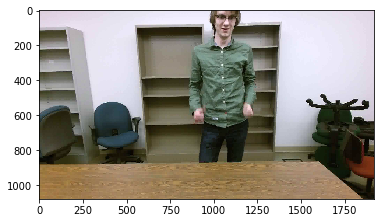

original central rgb image =
xyz_skeleton_data.shape (4597, 58)
rgb_skeleton_data.shape (4597, 39)
total frames in the video = 4662
vfr_time 1848666666.0
len frame_dict 4662
rgb_skeleton_data (4597, 39) (4597,)
nearest_idx, nearest_time 4593 1848385564.0
rgb nearest 1848385564.0 4593 [1.8484e+09 1.0539e+03 5.4447e+02 1.0510e+03 3.6415e+02 1.0488e+03
 1.7438e+02 1.0661e+03 5.3288e+01 9.2874e+02 2.5690e+02 8.9886e+02
 4.3135e+02 9.0140e+02 5.5175e+02 9.0778e+02 5.9830e+02 1.1739e+03
 2.5559e+02 1.2041e+03 4.2737e+02 1.2065e+03 5.3303e+02 1.1986e+03
 5.7170e+02 1.0046e+03 5.4556e+02 1.1048e+03 5.4338e+02 1.0492e+03
 2.2270e+02 9.1820e+02 6.3884e+02 9.2761e+02 5.8276e+02 1.1900e+03
 5.9721e+02 1.2248e+03 5.9425e+02]
rgb kp [[1053.918   544.4724]
 [1051.048   364.148 ]
 [1048.83    174.3843]
 [1066.124    53.2885]
 [ 928.7393  256.8959]
 [ 898.8617  431.3464]
 [ 901.3976  551.7509]
 [ 907.7833  598.2955]
 [1173.908   255.5943]
 [1204.11    427.3665]
 [1206.454   533.0334]
 [1198.571   571.7

In [35]:
# ## list directory of output transformed images
# transformed_dir = "/s/red/b/nobackup/data/eggnog_cpm/eggnog_cpm_test/transformed/r2/"

# tx_imgs = [im for im in sorted(os.listdir(transformed_dir)) if im.endswith('.jpg')]
# # print("tx_imgs len and [0]", len(tx_imgs), tx_imgs[0])

# image_idx = 53


# # original image 240x320
# # test_image_file_path = os.path.join(gt_raw_data_path, gt_file_pre + '_240x320.jpg')
# test_image_file_path = os.path.join(transformed_dir, tx_imgs[image_idx])
# # "/s/red/b/nobackup/data/eggnog_cpm/eggnog_cpm_test/s07_1video_transformed_train/part1_layout_p14/20151116_230338_00_Video/20151116_230338_00_Video_vfr_90_skfr_90_240x320_transformed.jpg"
# print("test_image_file_path", test_image_file_path)

# original_image = cv2.imread(test_image_file_path)  # B,G,R order
# rgb_image = original_image[:,:,[2,1,0]]
# down_image = pyramid_reduce(rgb_image, downscale=8)

# print("original transformed rgb image =")
# plt.figure(0)
# plt.imshow(rgb_image)  
# plt.show()

# ### search the video for this image
# video_name = tx_imgs[image_idx].split('_vfr')[0]
# name_part2 = tx_imgs[image_idx].split('_vfr')[1].split('_')
# vfr = int(name_part2[1])
# skfr = int(name_part2[3])
# print("video_name, vfr, skfr =", video_name, vfr, skfr)


print("=============================================")
# dataset_path = "/s/red/b/nobackup/data/eggnog_cpm/eggnog_cpm/"
# video_folder = "s04/part2_layout_p07/"  # "s04/part1_layout_p08/"
# video_path = os.path.join(dataset_path, video_folder, video_name + ".avi")
# video_path = "/s/red/b/nobackup/data/eggnog_cpm/eggnog_cpm_v1/s04/part2_layout_p07/20151113_230303_00_Video.avi"
video_path = "/s/red/b/nobackup/data/eggnog_cpm/eggnog_cpm_v1/s04/part2_layout_p07/20151113_230303_00_Video.mp4"
print("video_file_path", video_path)
vfr = 4661
print("vfr", vfr)

length = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
print("n_frames according to opencv", length)

cap = cv2.VideoCapture(video_path)
assert(cap.isOpened() == True)
cap.set(cv2.CAP_PROP_POS_FRAMES, vfr)
success, frame = cap.read()  # frame is read as (h, w, c)
if success:
    print("frame.shape", frame.shape)
    img_full = frame[...,::-1]
    print("original full rgb image =")

    plt.figure()
    plt.imshow(img_full)  
    plt.show()
    
    img_central = img_full[:, 240:(1920-240), :]
    print("original central rgb image =")

    
"""
n_frames according to opencv 5548 for a .avi file

mplayer gives the same number as opencv
/usr/local/mplayer/bin/mplayer /s/red/a/nobackup/cwc/data/userstudies/initial_study_xef/s04/part2_layout_p07/20151113_230303_00_Video.avi
A: 184.9 V: 184.9 A-V: -0.017 ct: -0.137 5548/5548 12%  0%  0.1% 0 0 
BUT
ffprobe gives:

rally-king:~/Desktop$ /s/parsons/h/proj/vision/usr/rahul/local/bin/ffprobe -v error -count_frames -select_streams v:0   -show_entries stream=nb_read_frames -of default=nokey=1:noprint_wrappers=1 /s/red/b/nobackup/data/eggnog_cpm/eggnog_cpm/s04/part2_layout_p07/20151113_230303_00_Video.avi 
4662

This number matches the number of lines in the .frames file.

"""


#1 original full image and original sk kp
xyz_skeleton_data, rgb_skeleton_data = prep.load_skeleton_data_for_video(video_path)
frame_dict = prep.load_frames_file(video_path)
vfr_time = frame_dict[vfr]
print("vfr_time", vfr_time)
print("len frame_dict", len(frame_dict.keys()))

print("rgb_skeleton_data", rgb_skeleton_data.shape, rgb_skeleton_data[..., 0].shape)
nearest_idx, nearest_time = prep.find_nearest_frameindex_from_skeleton_file(rgb_skeleton_data[...,0], frame_dict[vfr])
print("nearest_idx, nearest_time", nearest_idx, nearest_time)
# print("", rgb_skeleton_data[nearest_idx+1], rgb_skeleton_data[nearest_idx-1])

print("rgb nearest", nearest_time, nearest_idx, rgb_skeleton_data[nearest_idx])
rgb_kp = rgb_skeleton_data[nearest_idx][1:].reshape((19,2))
print("rgb kp", rgb_kp)


    


reading video /s/red/b/nobackup/data/eggnog_cpm/eggnog_cpm_v1/s04/part2_layout_p07/20151113_230303_00_Video.mp4
frame number (vfr) and rgb skeleton frame number 0 0
original full rgb image =


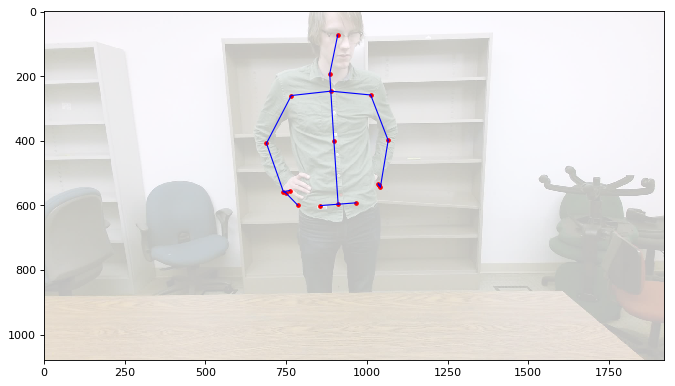

frame number (vfr) and rgb skeleton frame number 1 1
frame number (vfr) and rgb skeleton frame number 2 1
frame number (vfr) and rgb skeleton frame number 3 2
frame number (vfr) and rgb skeleton frame number 4 4
frame number (vfr) and rgb skeleton frame number 5 4
frame number (vfr) and rgb skeleton frame number 6 5
frame number (vfr) and rgb skeleton frame number 7 6
frame number (vfr) and rgb skeleton frame number 8 8
frame number (vfr) and rgb skeleton frame number 9 9
frame number (vfr) and rgb skeleton frame number 10 10
frame number (vfr) and rgb skeleton frame number 11 11
frame number (vfr) and rgb skeleton frame number 12 12
frame number (vfr) and rgb skeleton frame number 13 13
frame number (vfr) and rgb skeleton frame number 14 13
frame number (vfr) and rgb skeleton frame number 15 14
frame number (vfr) and rgb skeleton frame number 16 16
frame number (vfr) and rgb skeleton frame number 17 17
frame number (vfr) and rgb skeleton frame number 18 17
frame number (vfr) and rgb s

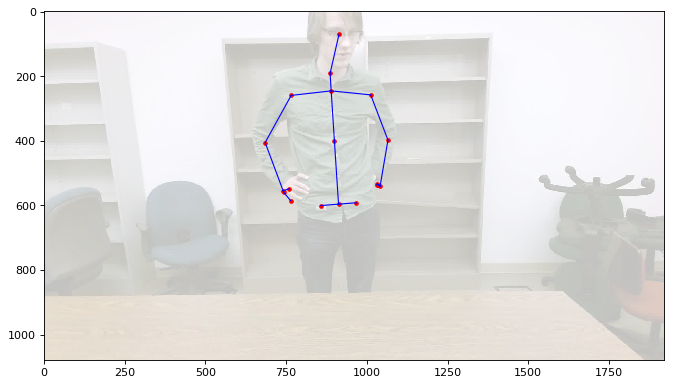

frame number (vfr) and rgb skeleton frame number 31 30
frame number (vfr) and rgb skeleton frame number 32 30
frame number (vfr) and rgb skeleton frame number 33 31
frame number (vfr) and rgb skeleton frame number 34 32
frame number (vfr) and rgb skeleton frame number 35 34
frame number (vfr) and rgb skeleton frame number 36 34
frame number (vfr) and rgb skeleton frame number 37 35
frame number (vfr) and rgb skeleton frame number 38 37
frame number (vfr) and rgb skeleton frame number 39 37
frame number (vfr) and rgb skeleton frame number 40 38
frame number (vfr) and rgb skeleton frame number 41 40
frame number (vfr) and rgb skeleton frame number 42 40
frame number (vfr) and rgb skeleton frame number 43 41
frame number (vfr) and rgb skeleton frame number 44 43
frame number (vfr) and rgb skeleton frame number 45 43
frame number (vfr) and rgb skeleton frame number 46 45
frame number (vfr) and rgb skeleton frame number 47 45
frame number (vfr) and rgb skeleton frame number 48 46
frame numb

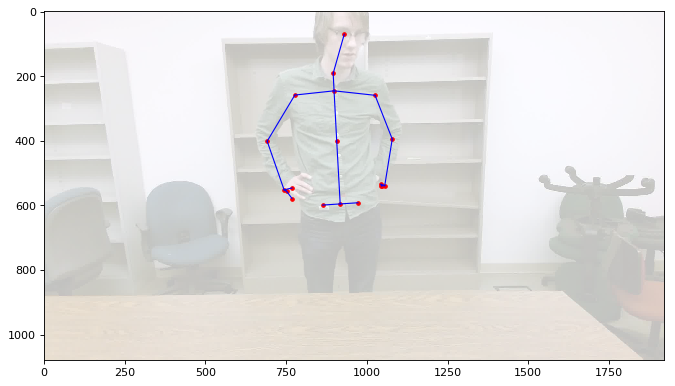

frame number (vfr) and rgb skeleton frame number 61 60
frame number (vfr) and rgb skeleton frame number 62 60
frame number (vfr) and rgb skeleton frame number 63 61
frame number (vfr) and rgb skeleton frame number 64 63
frame number (vfr) and rgb skeleton frame number 65 64
frame number (vfr) and rgb skeleton frame number 66 64
frame number (vfr) and rgb skeleton frame number 67 66
frame number (vfr) and rgb skeleton frame number 68 67
frame number (vfr) and rgb skeleton frame number 69 68
frame number (vfr) and rgb skeleton frame number 70 69
frame number (vfr) and rgb skeleton frame number 71 69
frame number (vfr) and rgb skeleton frame number 72 70
frame number (vfr) and rgb skeleton frame number 73 72
frame number (vfr) and rgb skeleton frame number 74 73
frame number (vfr) and rgb skeleton frame number 75 74
frame number (vfr) and rgb skeleton frame number 76 75
frame number (vfr) and rgb skeleton frame number 77 76
frame number (vfr) and rgb skeleton frame number 78 77
frame numb

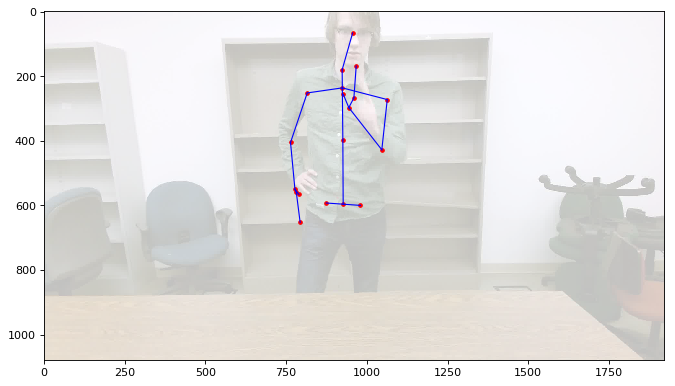

frame number (vfr) and rgb skeleton frame number 91 90
frame number (vfr) and rgb skeleton frame number 92 90
frame number (vfr) and rgb skeleton frame number 93 92
frame number (vfr) and rgb skeleton frame number 94 92
frame number (vfr) and rgb skeleton frame number 95 93
frame number (vfr) and rgb skeleton frame number 96 95
frame number (vfr) and rgb skeleton frame number 97 95
frame number (vfr) and rgb skeleton frame number 98 96
frame number (vfr) and rgb skeleton frame number 99 97
frame number (vfr) and rgb skeleton frame number 100 99
frame number (vfr) and rgb skeleton frame number 101 100
frame number (vfr) and rgb skeleton frame number 102 100
frame number (vfr) and rgb skeleton frame number 103 101
frame number (vfr) and rgb skeleton frame number 104 103
frame number (vfr) and rgb skeleton frame number 105 104
frame number (vfr) and rgb skeleton frame number 106 104
frame number (vfr) and rgb skeleton frame number 107 105
frame number (vfr) and rgb skeleton frame number 1

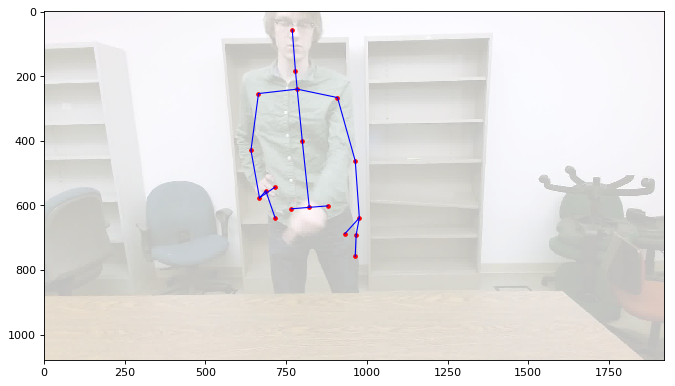

frame number (vfr) and rgb skeleton frame number 121 120
frame number (vfr) and rgb skeleton frame number 122 121
frame number (vfr) and rgb skeleton frame number 123 122
frame number (vfr) and rgb skeleton frame number 124 123
frame number (vfr) and rgb skeleton frame number 125 124
frame number (vfr) and rgb skeleton frame number 126 125
frame number (vfr) and rgb skeleton frame number 127 126
frame number (vfr) and rgb skeleton frame number 128 127
frame number (vfr) and rgb skeleton frame number 129 128
frame number (vfr) and rgb skeleton frame number 130 128
frame number (vfr) and rgb skeleton frame number 131 129
frame number (vfr) and rgb skeleton frame number 132 130
frame number (vfr) and rgb skeleton frame number 133 131
frame number (vfr) and rgb skeleton frame number 134 132
frame number (vfr) and rgb skeleton frame number 135 133
frame number (vfr) and rgb skeleton frame number 136 134
frame number (vfr) and rgb skeleton frame number 137 134
frame number (vfr) and rgb skel

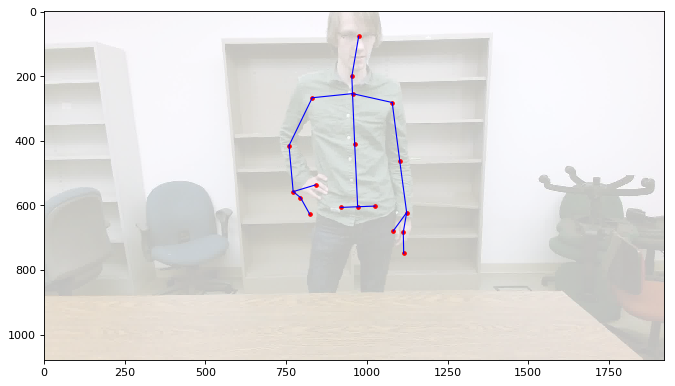

frame number (vfr) and rgb skeleton frame number 151 149
frame number (vfr) and rgb skeleton frame number 152 149
frame number (vfr) and rgb skeleton frame number 153 150
frame number (vfr) and rgb skeleton frame number 154 152
frame number (vfr) and rgb skeleton frame number 155 153
frame number (vfr) and rgb skeleton frame number 156 154
frame number (vfr) and rgb skeleton frame number 157 155
frame number (vfr) and rgb skeleton frame number 158 156
frame number (vfr) and rgb skeleton frame number 159 156
frame number (vfr) and rgb skeleton frame number 160 158
frame number (vfr) and rgb skeleton frame number 161 159
frame number (vfr) and rgb skeleton frame number 162 159
frame number (vfr) and rgb skeleton frame number 163 160
frame number (vfr) and rgb skeleton frame number 164 161
frame number (vfr) and rgb skeleton frame number 165 162
frame number (vfr) and rgb skeleton frame number 166 163
frame number (vfr) and rgb skeleton frame number 167 164
frame number (vfr) and rgb skel

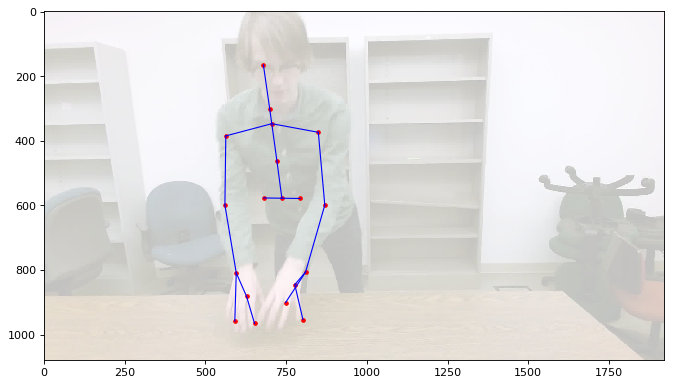

frame number (vfr) and rgb skeleton frame number 181 178
frame number (vfr) and rgb skeleton frame number 182 179
frame number (vfr) and rgb skeleton frame number 183 180
frame number (vfr) and rgb skeleton frame number 184 181
frame number (vfr) and rgb skeleton frame number 185 182
frame number (vfr) and rgb skeleton frame number 186 182
frame number (vfr) and rgb skeleton frame number 187 184
frame number (vfr) and rgb skeleton frame number 188 185
frame number (vfr) and rgb skeleton frame number 189 186
frame number (vfr) and rgb skeleton frame number 190 186
frame number (vfr) and rgb skeleton frame number 191 188
frame number (vfr) and rgb skeleton frame number 192 189
frame number (vfr) and rgb skeleton frame number 193 189
frame number (vfr) and rgb skeleton frame number 194 191
frame number (vfr) and rgb skeleton frame number 195 192
frame number (vfr) and rgb skeleton frame number 196 192
frame number (vfr) and rgb skeleton frame number 197 194
frame number (vfr) and rgb skel

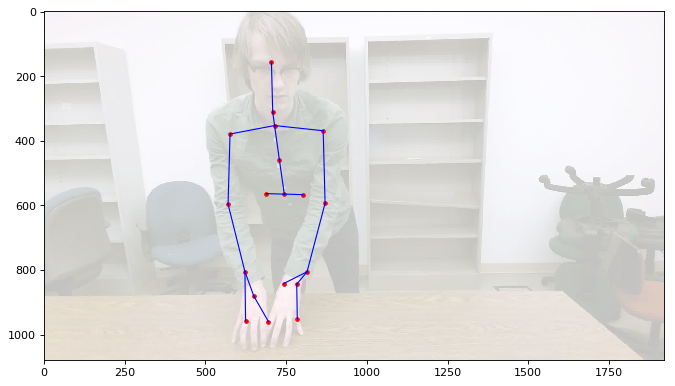

frame number (vfr) and rgb skeleton frame number 211 208
frame number (vfr) and rgb skeleton frame number 212 209
frame number (vfr) and rgb skeleton frame number 213 209
frame number (vfr) and rgb skeleton frame number 214 211
frame number (vfr) and rgb skeleton frame number 215 212
frame number (vfr) and rgb skeleton frame number 216 213
frame number (vfr) and rgb skeleton frame number 217 213
frame number (vfr) and rgb skeleton frame number 218 214
frame number (vfr) and rgb skeleton frame number 219 216
frame number (vfr) and rgb skeleton frame number 220 217
frame number (vfr) and rgb skeleton frame number 221 218
frame number (vfr) and rgb skeleton frame number 222 218
frame number (vfr) and rgb skeleton frame number 223 219
frame number (vfr) and rgb skeleton frame number 224 221
frame number (vfr) and rgb skeleton frame number 225 222
frame number (vfr) and rgb skeleton frame number 226 222
frame number (vfr) and rgb skeleton frame number 227 224
frame number (vfr) and rgb skel

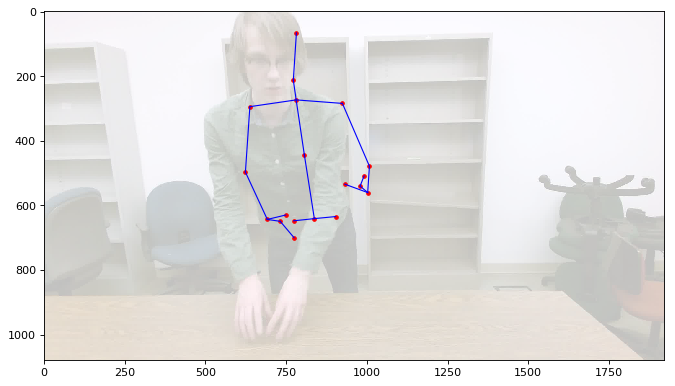

frame number (vfr) and rgb skeleton frame number 241 237
frame number (vfr) and rgb skeleton frame number 242 239
frame number (vfr) and rgb skeleton frame number 243 239
frame number (vfr) and rgb skeleton frame number 244 241
frame number (vfr) and rgb skeleton frame number 245 242
frame number (vfr) and rgb skeleton frame number 246 243
frame number (vfr) and rgb skeleton frame number 247 244
frame number (vfr) and rgb skeleton frame number 248 245
frame number (vfr) and rgb skeleton frame number 249 245
frame number (vfr) and rgb skeleton frame number 250 247
frame number (vfr) and rgb skeleton frame number 251 248
frame number (vfr) and rgb skeleton frame number 252 248
frame number (vfr) and rgb skeleton frame number 253 250
frame number (vfr) and rgb skeleton frame number 254 251
frame number (vfr) and rgb skeleton frame number 255 251
frame number (vfr) and rgb skeleton frame number 256 253
frame number (vfr) and rgb skeleton frame number 257 254
frame number (vfr) and rgb skel

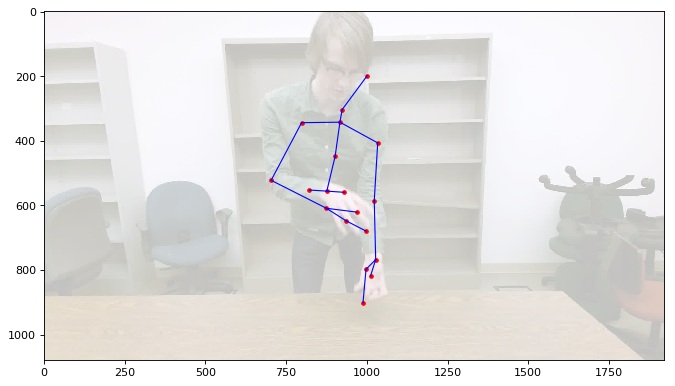

frame number (vfr) and rgb skeleton frame number 271 267
frame number (vfr) and rgb skeleton frame number 272 268
frame number (vfr) and rgb skeleton frame number 273 269
frame number (vfr) and rgb skeleton frame number 274 270
frame number (vfr) and rgb skeleton frame number 275 270
frame number (vfr) and rgb skeleton frame number 276 272
frame number (vfr) and rgb skeleton frame number 277 273
frame number (vfr) and rgb skeleton frame number 278 274
frame number (vfr) and rgb skeleton frame number 279 275
frame number (vfr) and rgb skeleton frame number 280 275
frame number (vfr) and rgb skeleton frame number 281 276
frame number (vfr) and rgb skeleton frame number 282 278
frame number (vfr) and rgb skeleton frame number 283 279
frame number (vfr) and rgb skeleton frame number 284 280
frame number (vfr) and rgb skeleton frame number 285 280
frame number (vfr) and rgb skeleton frame number 286 281
frame number (vfr) and rgb skeleton frame number 287 283
frame number (vfr) and rgb skel

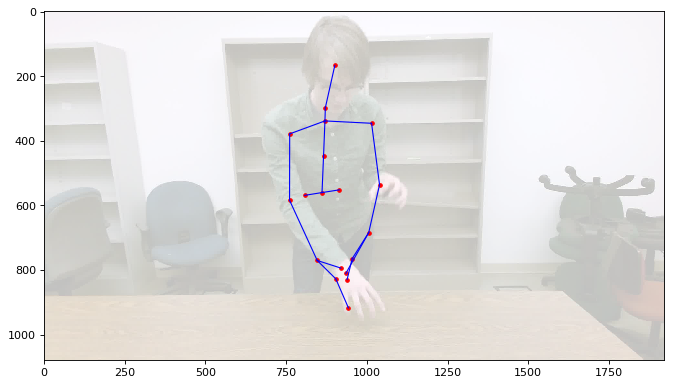

frame number (vfr) and rgb skeleton frame number 301 296
frame number (vfr) and rgb skeleton frame number 302 297
frame number (vfr) and rgb skeleton frame number 303 299
frame number (vfr) and rgb skeleton frame number 304 300
frame number (vfr) and rgb skeleton frame number 305 300
frame number (vfr) and rgb skeleton frame number 306 301
frame number (vfr) and rgb skeleton frame number 307 302
frame number (vfr) and rgb skeleton frame number 308 304
frame number (vfr) and rgb skeleton frame number 309 304
frame number (vfr) and rgb skeleton frame number 310 305
frame number (vfr) and rgb skeleton frame number 311 307
frame number (vfr) and rgb skeleton frame number 312 308
frame number (vfr) and rgb skeleton frame number 313 309
frame number (vfr) and rgb skeleton frame number 314 309
frame number (vfr) and rgb skeleton frame number 315 311
frame number (vfr) and rgb skeleton frame number 316 312
frame number (vfr) and rgb skeleton frame number 317 313
frame number (vfr) and rgb skel

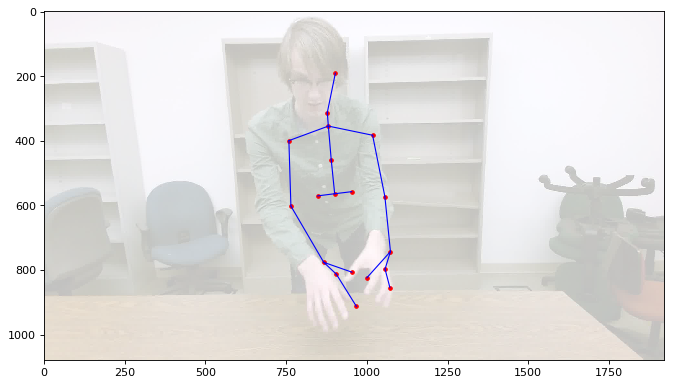

frame number (vfr) and rgb skeleton frame number 331 327
frame number (vfr) and rgb skeleton frame number 332 328
frame number (vfr) and rgb skeleton frame number 333 329
frame number (vfr) and rgb skeleton frame number 334 330
frame number (vfr) and rgb skeleton frame number 335 330
frame number (vfr) and rgb skeleton frame number 336 331
frame number (vfr) and rgb skeleton frame number 337 332
frame number (vfr) and rgb skeleton frame number 338 333
frame number (vfr) and rgb skeleton frame number 339 334
frame number (vfr) and rgb skeleton frame number 340 335
frame number (vfr) and rgb skeleton frame number 341 336
frame number (vfr) and rgb skeleton frame number 342 337
frame number (vfr) and rgb skeleton frame number 343 337
frame number (vfr) and rgb skeleton frame number 344 339
frame number (vfr) and rgb skeleton frame number 345 340
frame number (vfr) and rgb skeleton frame number 346 340
frame number (vfr) and rgb skeleton frame number 347 341
frame number (vfr) and rgb skel

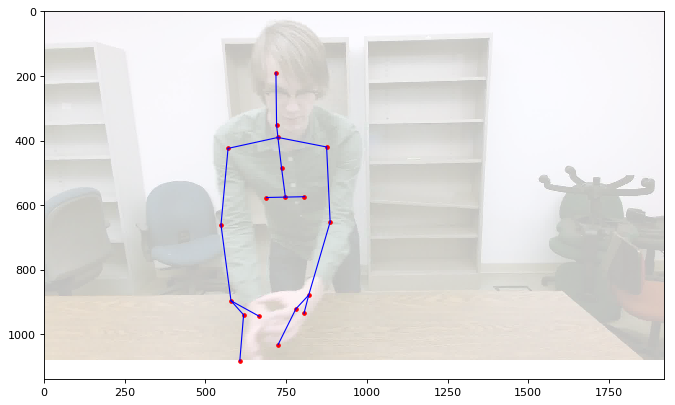

frame number (vfr) and rgb skeleton frame number 361 355
frame number (vfr) and rgb skeleton frame number 362 357
frame number (vfr) and rgb skeleton frame number 363 358
frame number (vfr) and rgb skeleton frame number 364 359
frame number (vfr) and rgb skeleton frame number 365 359
frame number (vfr) and rgb skeleton frame number 366 360
frame number (vfr) and rgb skeleton frame number 367 362
frame number (vfr) and rgb skeleton frame number 368 362
frame number (vfr) and rgb skeleton frame number 369 363
frame number (vfr) and rgb skeleton frame number 370 365
frame number (vfr) and rgb skeleton frame number 371 366
frame number (vfr) and rgb skeleton frame number 372 366
frame number (vfr) and rgb skeleton frame number 373 367
frame number (vfr) and rgb skeleton frame number 374 368
frame number (vfr) and rgb skeleton frame number 375 370
frame number (vfr) and rgb skeleton frame number 376 371
frame number (vfr) and rgb skeleton frame number 377 371
frame number (vfr) and rgb skel

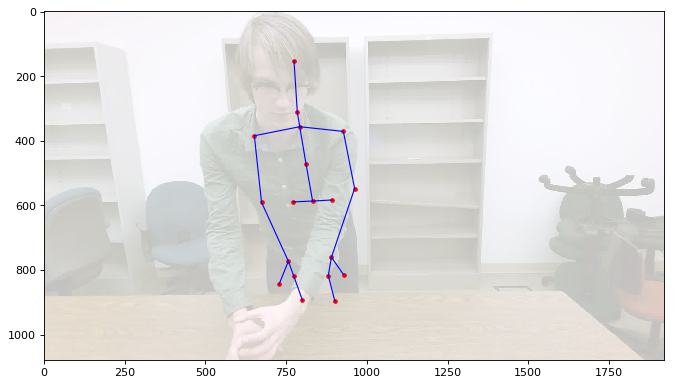

frame number (vfr) and rgb skeleton frame number 391 385
frame number (vfr) and rgb skeleton frame number 392 386
frame number (vfr) and rgb skeleton frame number 393 387
frame number (vfr) and rgb skeleton frame number 394 388
frame number (vfr) and rgb skeleton frame number 395 389
frame number (vfr) and rgb skeleton frame number 396 390
frame number (vfr) and rgb skeleton frame number 397 391
frame number (vfr) and rgb skeleton frame number 398 392
frame number (vfr) and rgb skeleton frame number 399 393
frame number (vfr) and rgb skeleton frame number 400 394
frame number (vfr) and rgb skeleton frame number 401 395
frame number (vfr) and rgb skeleton frame number 402 396
frame number (vfr) and rgb skeleton frame number 403 397
frame number (vfr) and rgb skeleton frame number 404 398
frame number (vfr) and rgb skeleton frame number 405 399
frame number (vfr) and rgb skeleton frame number 406 400
frame number (vfr) and rgb skeleton frame number 407 401
frame number (vfr) and rgb skel

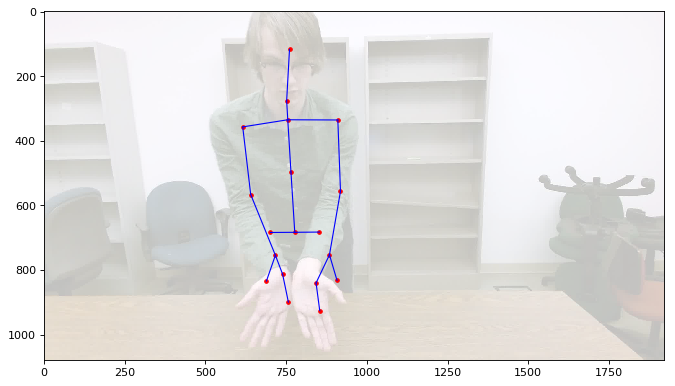

frame number (vfr) and rgb skeleton frame number 421 414
frame number (vfr) and rgb skeleton frame number 422 415
frame number (vfr) and rgb skeleton frame number 423 416
frame number (vfr) and rgb skeleton frame number 424 418
frame number (vfr) and rgb skeleton frame number 425 418
frame number (vfr) and rgb skeleton frame number 426 420
frame number (vfr) and rgb skeleton frame number 427 421
frame number (vfr) and rgb skeleton frame number 428 422
frame number (vfr) and rgb skeleton frame number 429 422
frame number (vfr) and rgb skeleton frame number 430 423
frame number (vfr) and rgb skeleton frame number 431 425
frame number (vfr) and rgb skeleton frame number 432 426
frame number (vfr) and rgb skeleton frame number 433 426
frame number (vfr) and rgb skeleton frame number 434 428
frame number (vfr) and rgb skeleton frame number 435 428
frame number (vfr) and rgb skeleton frame number 436 429
frame number (vfr) and rgb skeleton frame number 437 431
frame number (vfr) and rgb skel

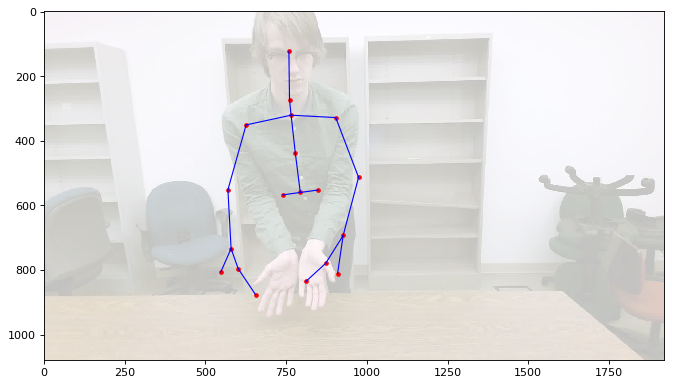

frame number (vfr) and rgb skeleton frame number 451 445
frame number (vfr) and rgb skeleton frame number 452 445
frame number (vfr) and rgb skeleton frame number 453 447
frame number (vfr) and rgb skeleton frame number 454 448
frame number (vfr) and rgb skeleton frame number 455 449
frame number (vfr) and rgb skeleton frame number 456 449
frame number (vfr) and rgb skeleton frame number 457 450
frame number (vfr) and rgb skeleton frame number 458 452
frame number (vfr) and rgb skeleton frame number 459 452
frame number (vfr) and rgb skeleton frame number 460 453
frame number (vfr) and rgb skeleton frame number 461 455
frame number (vfr) and rgb skeleton frame number 462 455
frame number (vfr) and rgb skeleton frame number 463 456
frame number (vfr) and rgb skeleton frame number 464 457
frame number (vfr) and rgb skeleton frame number 465 458
frame number (vfr) and rgb skeleton frame number 466 459
frame number (vfr) and rgb skeleton frame number 467 460
frame number (vfr) and rgb skel

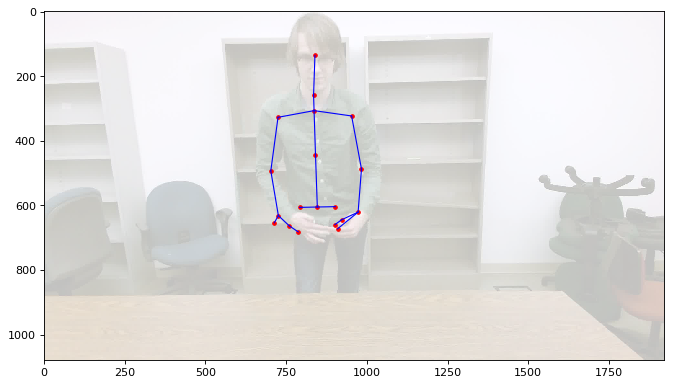

frame number (vfr) and rgb skeleton frame number 481 472
frame number (vfr) and rgb skeleton frame number 482 473
frame number (vfr) and rgb skeleton frame number 483 473
frame number (vfr) and rgb skeleton frame number 484 474
frame number (vfr) and rgb skeleton frame number 485 476
frame number (vfr) and rgb skeleton frame number 486 476
frame number (vfr) and rgb skeleton frame number 487 477
frame number (vfr) and rgb skeleton frame number 488 478
frame number (vfr) and rgb skeleton frame number 489 479
frame number (vfr) and rgb skeleton frame number 490 480
frame number (vfr) and rgb skeleton frame number 491 481
frame number (vfr) and rgb skeleton frame number 492 482
frame number (vfr) and rgb skeleton frame number 493 483
frame number (vfr) and rgb skeleton frame number 494 484
frame number (vfr) and rgb skeleton frame number 495 485
frame number (vfr) and rgb skeleton frame number 496 486
frame number (vfr) and rgb skeleton frame number 497 486
frame number (vfr) and rgb skel

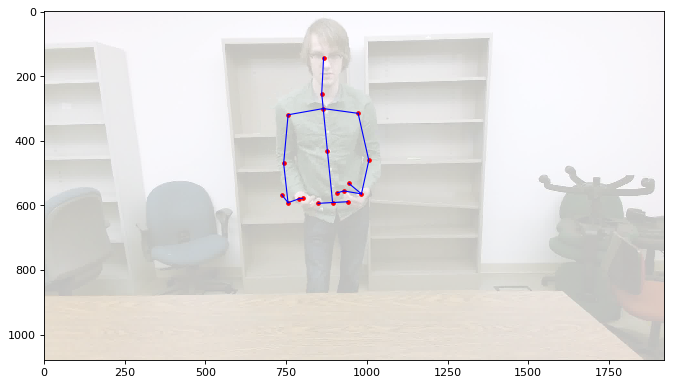

frame number (vfr) and rgb skeleton frame number 511 501
frame number (vfr) and rgb skeleton frame number 512 502
frame number (vfr) and rgb skeleton frame number 513 503
frame number (vfr) and rgb skeleton frame number 514 503
frame number (vfr) and rgb skeleton frame number 515 504
frame number (vfr) and rgb skeleton frame number 516 506
frame number (vfr) and rgb skeleton frame number 517 507
frame number (vfr) and rgb skeleton frame number 518 508
frame number (vfr) and rgb skeleton frame number 519 509
frame number (vfr) and rgb skeleton frame number 520 510
frame number (vfr) and rgb skeleton frame number 521 511
frame number (vfr) and rgb skeleton frame number 522 512
frame number (vfr) and rgb skeleton frame number 523 512
frame number (vfr) and rgb skeleton frame number 524 513
frame number (vfr) and rgb skeleton frame number 525 515
frame number (vfr) and rgb skeleton frame number 526 516
frame number (vfr) and rgb skeleton frame number 527 517
frame number (vfr) and rgb skel

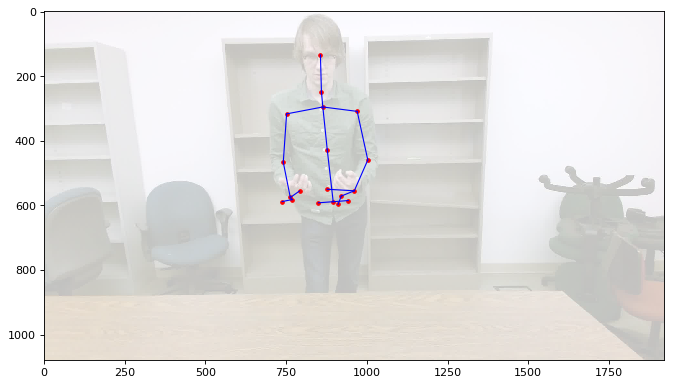

frame number (vfr) and rgb skeleton frame number 541 531
frame number (vfr) and rgb skeleton frame number 542 531
frame number (vfr) and rgb skeleton frame number 543 532
frame number (vfr) and rgb skeleton frame number 544 533
frame number (vfr) and rgb skeleton frame number 545 534
frame number (vfr) and rgb skeleton frame number 546 535
frame number (vfr) and rgb skeleton frame number 547 536
frame number (vfr) and rgb skeleton frame number 548 537
frame number (vfr) and rgb skeleton frame number 549 538
frame number (vfr) and rgb skeleton frame number 550 539
frame number (vfr) and rgb skeleton frame number 551 539
frame number (vfr) and rgb skeleton frame number 552 540
frame number (vfr) and rgb skeleton frame number 553 542
frame number (vfr) and rgb skeleton frame number 554 543
frame number (vfr) and rgb skeleton frame number 555 543
frame number (vfr) and rgb skeleton frame number 556 544
frame number (vfr) and rgb skeleton frame number 557 546
frame number (vfr) and rgb skel

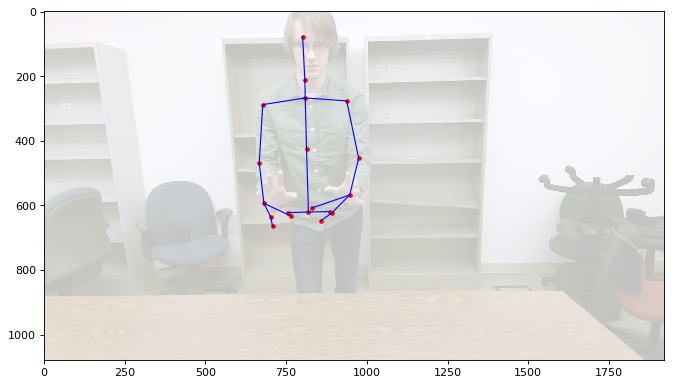

frame number (vfr) and rgb skeleton frame number 571 559
frame number (vfr) and rgb skeleton frame number 572 560
frame number (vfr) and rgb skeleton frame number 573 561
frame number (vfr) and rgb skeleton frame number 574 562
frame number (vfr) and rgb skeleton frame number 575 563
frame number (vfr) and rgb skeleton frame number 576 564
frame number (vfr) and rgb skeleton frame number 577 565
frame number (vfr) and rgb skeleton frame number 578 566
frame number (vfr) and rgb skeleton frame number 579 567
frame number (vfr) and rgb skeleton frame number 580 568
frame number (vfr) and rgb skeleton frame number 581 569
frame number (vfr) and rgb skeleton frame number 582 570
frame number (vfr) and rgb skeleton frame number 583 571
frame number (vfr) and rgb skeleton frame number 584 572
frame number (vfr) and rgb skeleton frame number 585 573
frame number (vfr) and rgb skeleton frame number 586 573
frame number (vfr) and rgb skeleton frame number 587 575
frame number (vfr) and rgb skel

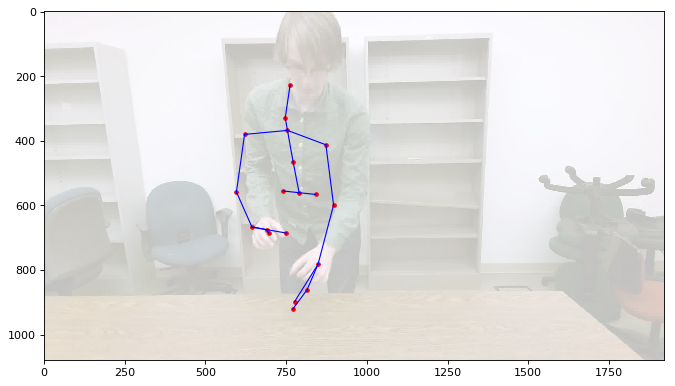

frame number (vfr) and rgb skeleton frame number 601 588
frame number (vfr) and rgb skeleton frame number 602 588
frame number (vfr) and rgb skeleton frame number 603 590
frame number (vfr) and rgb skeleton frame number 604 591
frame number (vfr) and rgb skeleton frame number 605 591
frame number (vfr) and rgb skeleton frame number 606 593
frame number (vfr) and rgb skeleton frame number 607 594
frame number (vfr) and rgb skeleton frame number 608 595
frame number (vfr) and rgb skeleton frame number 609 595
frame number (vfr) and rgb skeleton frame number 610 597
frame number (vfr) and rgb skeleton frame number 611 598
frame number (vfr) and rgb skeleton frame number 612 599
frame number (vfr) and rgb skeleton frame number 613 600
frame number (vfr) and rgb skeleton frame number 614 600
frame number (vfr) and rgb skeleton frame number 615 602
frame number (vfr) and rgb skeleton frame number 616 603
frame number (vfr) and rgb skeleton frame number 617 603
frame number (vfr) and rgb skel

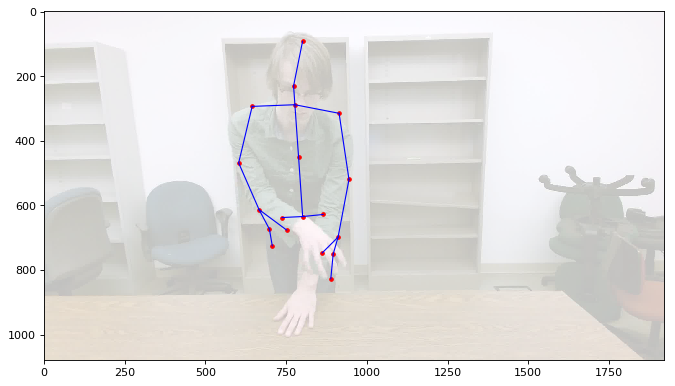

frame number (vfr) and rgb skeleton frame number 631 618
frame number (vfr) and rgb skeleton frame number 632 619
frame number (vfr) and rgb skeleton frame number 633 619
frame number (vfr) and rgb skeleton frame number 634 620
frame number (vfr) and rgb skeleton frame number 635 622
frame number (vfr) and rgb skeleton frame number 636 623
frame number (vfr) and rgb skeleton frame number 637 624
frame number (vfr) and rgb skeleton frame number 638 625
frame number (vfr) and rgb skeleton frame number 639 625
frame number (vfr) and rgb skeleton frame number 640 627
frame number (vfr) and rgb skeleton frame number 641 628
frame number (vfr) and rgb skeleton frame number 642 628
frame number (vfr) and rgb skeleton frame number 643 629
frame number (vfr) and rgb skeleton frame number 644 631
frame number (vfr) and rgb skeleton frame number 645 632
frame number (vfr) and rgb skeleton frame number 646 633
frame number (vfr) and rgb skeleton frame number 647 634
frame number (vfr) and rgb skel

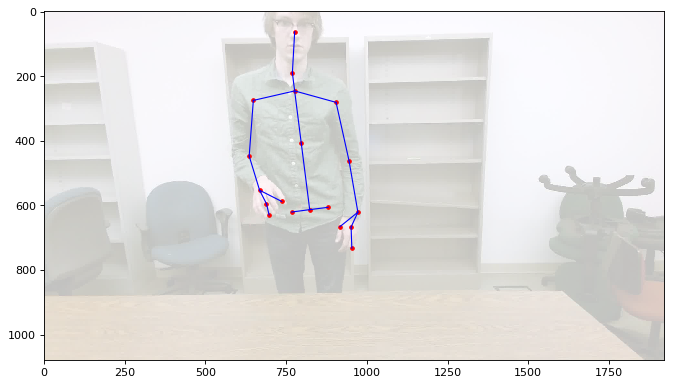

frame number (vfr) and rgb skeleton frame number 661 647
frame number (vfr) and rgb skeleton frame number 662 649
frame number (vfr) and rgb skeleton frame number 663 650
frame number (vfr) and rgb skeleton frame number 664 651
frame number (vfr) and rgb skeleton frame number 665 652
frame number (vfr) and rgb skeleton frame number 666 653
frame number (vfr) and rgb skeleton frame number 667 654
frame number (vfr) and rgb skeleton frame number 668 654
frame number (vfr) and rgb skeleton frame number 669 655
frame number (vfr) and rgb skeleton frame number 670 657
frame number (vfr) and rgb skeleton frame number 671 658
frame number (vfr) and rgb skeleton frame number 672 658
frame number (vfr) and rgb skeleton frame number 673 659
frame number (vfr) and rgb skeleton frame number 674 661
frame number (vfr) and rgb skeleton frame number 675 662
frame number (vfr) and rgb skeleton frame number 676 663
frame number (vfr) and rgb skeleton frame number 677 663
frame number (vfr) and rgb skel

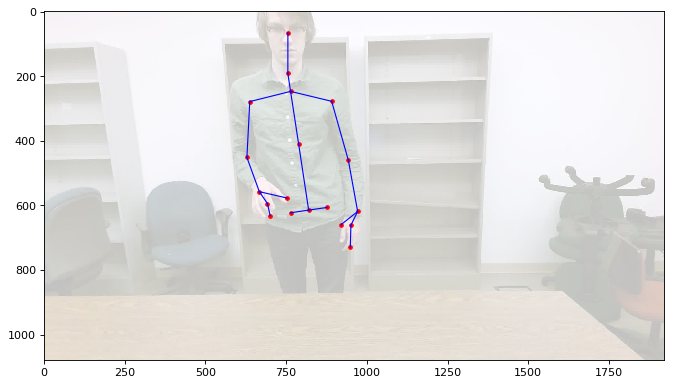

frame number (vfr) and rgb skeleton frame number 691 677
frame number (vfr) and rgb skeleton frame number 692 677
frame number (vfr) and rgb skeleton frame number 693 679
frame number (vfr) and rgb skeleton frame number 694 680
frame number (vfr) and rgb skeleton frame number 695 680
frame number (vfr) and rgb skeleton frame number 696 681
frame number (vfr) and rgb skeleton frame number 697 682
frame number (vfr) and rgb skeleton frame number 698 684
frame number (vfr) and rgb skeleton frame number 699 685
frame number (vfr) and rgb skeleton frame number 700 686
frame number (vfr) and rgb skeleton frame number 701 687
frame number (vfr) and rgb skeleton frame number 702 687
frame number (vfr) and rgb skeleton frame number 703 688
frame number (vfr) and rgb skeleton frame number 704 690
frame number (vfr) and rgb skeleton frame number 705 691
frame number (vfr) and rgb skeleton frame number 706 692
frame number (vfr) and rgb skeleton frame number 707 692
frame number (vfr) and rgb skel

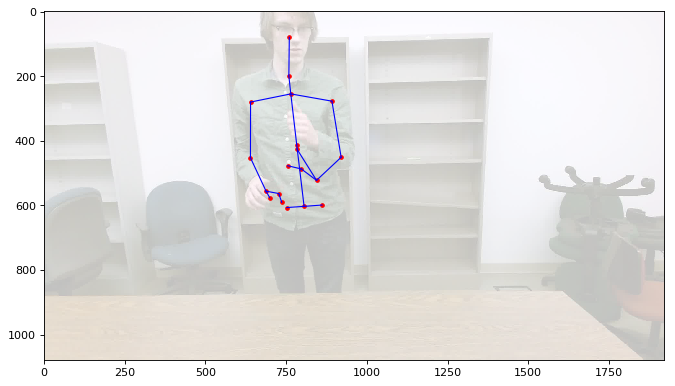

frame number (vfr) and rgb skeleton frame number 721 706
frame number (vfr) and rgb skeleton frame number 722 706
frame number (vfr) and rgb skeleton frame number 723 707
frame number (vfr) and rgb skeleton frame number 724 708
frame number (vfr) and rgb skeleton frame number 725 710
frame number (vfr) and rgb skeleton frame number 726 711
frame number (vfr) and rgb skeleton frame number 727 712
frame number (vfr) and rgb skeleton frame number 728 712
frame number (vfr) and rgb skeleton frame number 729 713
frame number (vfr) and rgb skeleton frame number 730 714
frame number (vfr) and rgb skeleton frame number 731 716
frame number (vfr) and rgb skeleton frame number 732 717
frame number (vfr) and rgb skeleton frame number 733 717
frame number (vfr) and rgb skeleton frame number 734 719
frame number (vfr) and rgb skeleton frame number 735 720
frame number (vfr) and rgb skeleton frame number 736 721
frame number (vfr) and rgb skeleton frame number 737 721
frame number (vfr) and rgb skel

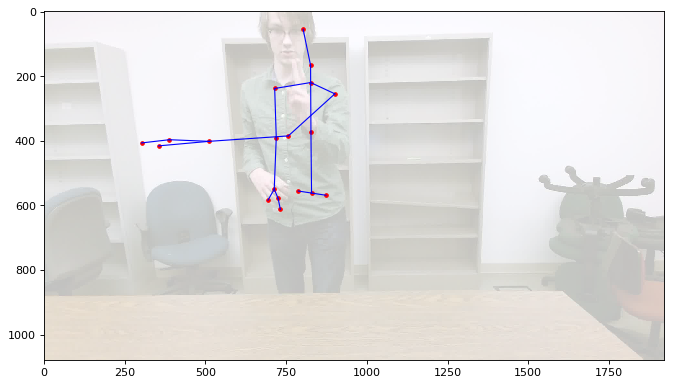

frame number (vfr) and rgb skeleton frame number 751 736
frame number (vfr) and rgb skeleton frame number 752 737
frame number (vfr) and rgb skeleton frame number 753 737
frame number (vfr) and rgb skeleton frame number 754 739
frame number (vfr) and rgb skeleton frame number 755 740
frame number (vfr) and rgb skeleton frame number 756 741
frame number (vfr) and rgb skeleton frame number 757 742
frame number (vfr) and rgb skeleton frame number 758 743
frame number (vfr) and rgb skeleton frame number 759 744
frame number (vfr) and rgb skeleton frame number 760 745
frame number (vfr) and rgb skeleton frame number 761 746
frame number (vfr) and rgb skeleton frame number 762 747
frame number (vfr) and rgb skeleton frame number 763 748
frame number (vfr) and rgb skeleton frame number 764 749
frame number (vfr) and rgb skeleton frame number 765 749
frame number (vfr) and rgb skeleton frame number 766 751
frame number (vfr) and rgb skeleton frame number 767 752
frame number (vfr) and rgb skel

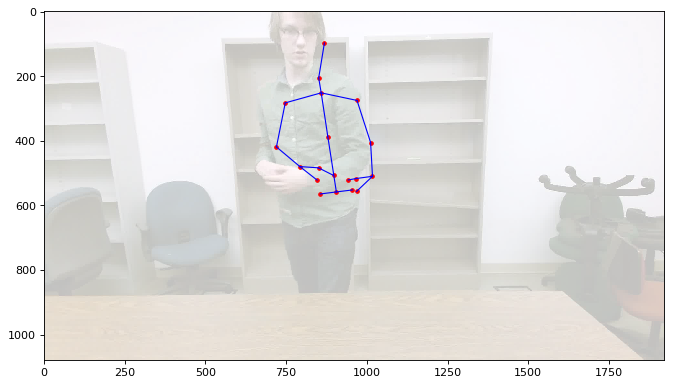

frame number (vfr) and rgb skeleton frame number 781 764
frame number (vfr) and rgb skeleton frame number 782 765
frame number (vfr) and rgb skeleton frame number 783 766
frame number (vfr) and rgb skeleton frame number 784 767
frame number (vfr) and rgb skeleton frame number 785 768
frame number (vfr) and rgb skeleton frame number 786 769
frame number (vfr) and rgb skeleton frame number 787 769
frame number (vfr) and rgb skeleton frame number 788 771
frame number (vfr) and rgb skeleton frame number 789 772
frame number (vfr) and rgb skeleton frame number 790 773
frame number (vfr) and rgb skeleton frame number 791 773
frame number (vfr) and rgb skeleton frame number 792 775
frame number (vfr) and rgb skeleton frame number 793 775
frame number (vfr) and rgb skeleton frame number 794 776
frame number (vfr) and rgb skeleton frame number 795 778
frame number (vfr) and rgb skeleton frame number 796 779
frame number (vfr) and rgb skeleton frame number 797 780
frame number (vfr) and rgb skel

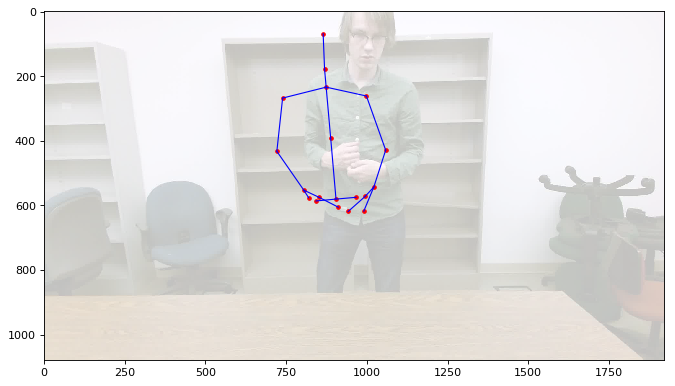

frame number (vfr) and rgb skeleton frame number 811 794
frame number (vfr) and rgb skeleton frame number 812 795
frame number (vfr) and rgb skeleton frame number 813 796
frame number (vfr) and rgb skeleton frame number 814 797
frame number (vfr) and rgb skeleton frame number 815 798
frame number (vfr) and rgb skeleton frame number 816 799
frame number (vfr) and rgb skeleton frame number 817 800
frame number (vfr) and rgb skeleton frame number 818 800
frame number (vfr) and rgb skeleton frame number 819 802
frame number (vfr) and rgb skeleton frame number 820 803
frame number (vfr) and rgb skeleton frame number 821 804
frame number (vfr) and rgb skeleton frame number 822 805
frame number (vfr) and rgb skeleton frame number 823 806
frame number (vfr) and rgb skeleton frame number 824 806
frame number (vfr) and rgb skeleton frame number 825 807
frame number (vfr) and rgb skeleton frame number 826 808
frame number (vfr) and rgb skeleton frame number 827 809
frame number (vfr) and rgb skel

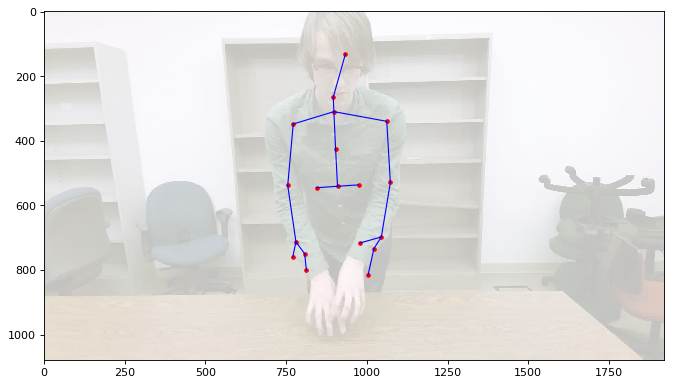

frame number (vfr) and rgb skeleton frame number 841 822
frame number (vfr) and rgb skeleton frame number 842 824
frame number (vfr) and rgb skeleton frame number 843 825
frame number (vfr) and rgb skeleton frame number 844 826
frame number (vfr) and rgb skeleton frame number 845 827
frame number (vfr) and rgb skeleton frame number 846 827
frame number (vfr) and rgb skeleton frame number 847 828
frame number (vfr) and rgb skeleton frame number 848 830
frame number (vfr) and rgb skeleton frame number 849 831
frame number (vfr) and rgb skeleton frame number 850 832
frame number (vfr) and rgb skeleton frame number 851 832
frame number (vfr) and rgb skeleton frame number 852 833
frame number (vfr) and rgb skeleton frame number 853 835
frame number (vfr) and rgb skeleton frame number 854 836
frame number (vfr) and rgb skeleton frame number 855 837
frame number (vfr) and rgb skeleton frame number 856 837
frame number (vfr) and rgb skeleton frame number 857 838
frame number (vfr) and rgb skel

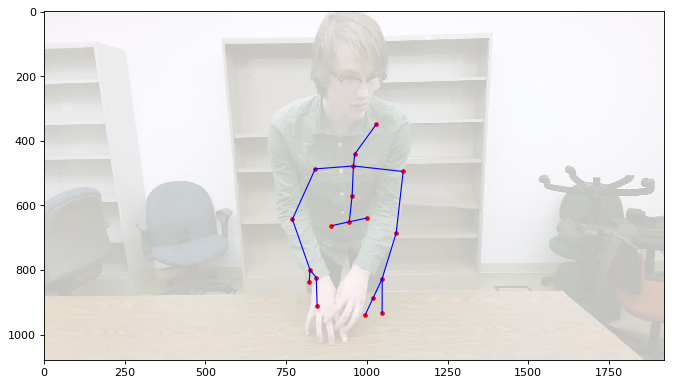

frame number (vfr) and rgb skeleton frame number 871 852
frame number (vfr) and rgb skeleton frame number 872 854
frame number (vfr) and rgb skeleton frame number 873 855
frame number (vfr) and rgb skeleton frame number 874 855
frame number (vfr) and rgb skeleton frame number 875 857
frame number (vfr) and rgb skeleton frame number 876 858
frame number (vfr) and rgb skeleton frame number 877 859
frame number (vfr) and rgb skeleton frame number 878 860
frame number (vfr) and rgb skeleton frame number 879 861
frame number (vfr) and rgb skeleton frame number 880 862
frame number (vfr) and rgb skeleton frame number 881 862
frame number (vfr) and rgb skeleton frame number 882 863
frame number (vfr) and rgb skeleton frame number 883 864
frame number (vfr) and rgb skeleton frame number 884 865
frame number (vfr) and rgb skeleton frame number 885 866
frame number (vfr) and rgb skeleton frame number 886 867
frame number (vfr) and rgb skeleton frame number 887 868
frame number (vfr) and rgb skel

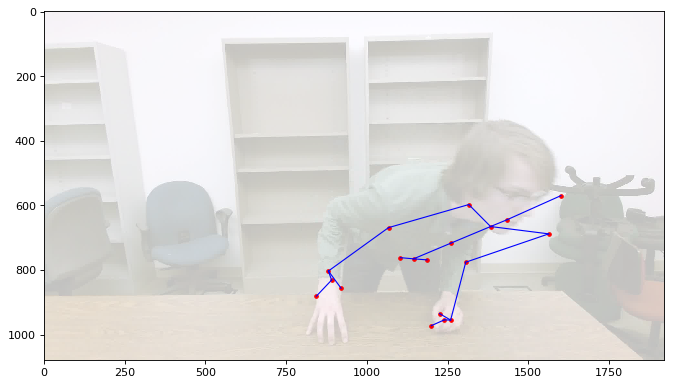

frame number (vfr) and rgb skeleton frame number 901 882
frame number (vfr) and rgb skeleton frame number 902 882
frame number (vfr) and rgb skeleton frame number 903 884
frame number (vfr) and rgb skeleton frame number 904 885
frame number (vfr) and rgb skeleton frame number 905 885
frame number (vfr) and rgb skeleton frame number 906 887
frame number (vfr) and rgb skeleton frame number 907 888
frame number (vfr) and rgb skeleton frame number 908 889
frame number (vfr) and rgb skeleton frame number 909 889
frame number (vfr) and rgb skeleton frame number 910 890
frame number (vfr) and rgb skeleton frame number 911 892
frame number (vfr) and rgb skeleton frame number 912 893
frame number (vfr) and rgb skeleton frame number 913 894
frame number (vfr) and rgb skeleton frame number 914 894
frame number (vfr) and rgb skeleton frame number 915 895
frame number (vfr) and rgb skeleton frame number 916 896
frame number (vfr) and rgb skeleton frame number 917 898
frame number (vfr) and rgb skel

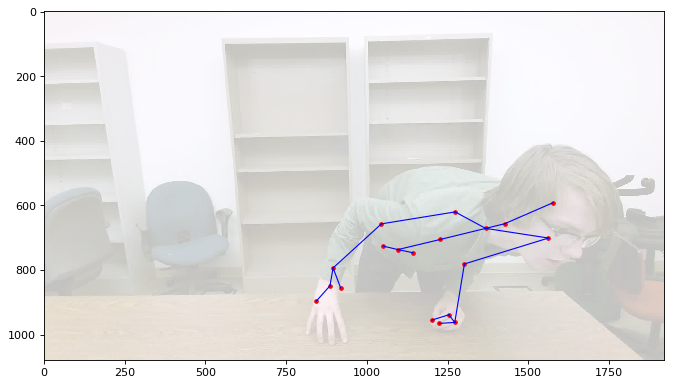

frame number (vfr) and rgb skeleton frame number 931 912
frame number (vfr) and rgb skeleton frame number 932 913
frame number (vfr) and rgb skeleton frame number 933 914
frame number (vfr) and rgb skeleton frame number 934 915
frame number (vfr) and rgb skeleton frame number 935 916
frame number (vfr) and rgb skeleton frame number 936 916
frame number (vfr) and rgb skeleton frame number 937 917
frame number (vfr) and rgb skeleton frame number 938 918
frame number (vfr) and rgb skeleton frame number 939 919
frame number (vfr) and rgb skeleton frame number 940 921
frame number (vfr) and rgb skeleton frame number 941 921
frame number (vfr) and rgb skeleton frame number 942 923
frame number (vfr) and rgb skeleton frame number 943 924
frame number (vfr) and rgb skeleton frame number 944 925
frame number (vfr) and rgb skeleton frame number 945 926
frame number (vfr) and rgb skeleton frame number 946 927
frame number (vfr) and rgb skeleton frame number 947 927
frame number (vfr) and rgb skel

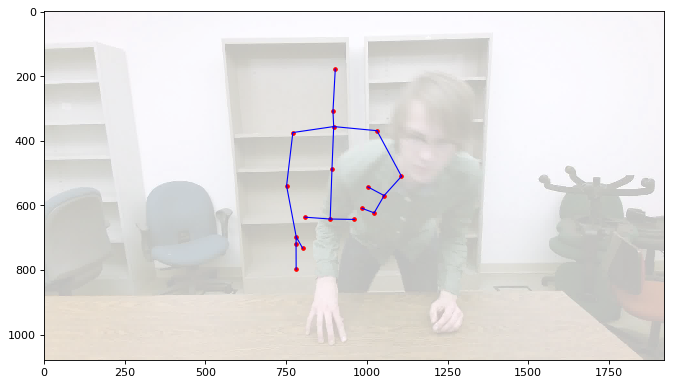

frame number (vfr) and rgb skeleton frame number 961 941
frame number (vfr) and rgb skeleton frame number 962 943
frame number (vfr) and rgb skeleton frame number 963 944
frame number (vfr) and rgb skeleton frame number 964 945
frame number (vfr) and rgb skeleton frame number 965 946
frame number (vfr) and rgb skeleton frame number 966 947
frame number (vfr) and rgb skeleton frame number 967 947
frame number (vfr) and rgb skeleton frame number 968 948
frame number (vfr) and rgb skeleton frame number 969 949
frame number (vfr) and rgb skeleton frame number 970 950
frame number (vfr) and rgb skeleton frame number 971 951
frame number (vfr) and rgb skeleton frame number 972 952
frame number (vfr) and rgb skeleton frame number 973 953
frame number (vfr) and rgb skeleton frame number 974 954
frame number (vfr) and rgb skeleton frame number 975 955
frame number (vfr) and rgb skeleton frame number 976 956
frame number (vfr) and rgb skeleton frame number 977 957
frame number (vfr) and rgb skel

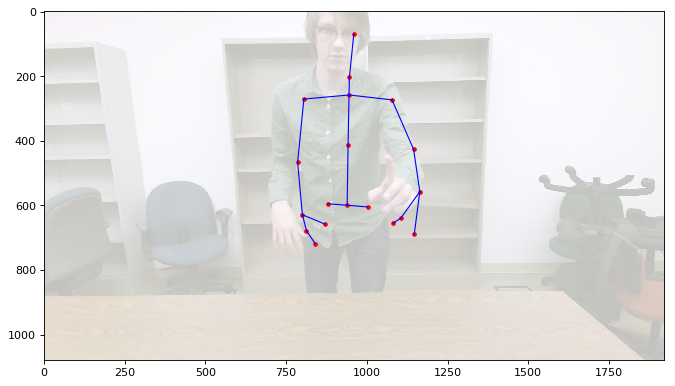

frame number (vfr) and rgb skeleton frame number 991 971
frame number (vfr) and rgb skeleton frame number 992 972
frame number (vfr) and rgb skeleton frame number 993 973
frame number (vfr) and rgb skeleton frame number 994 974
frame number (vfr) and rgb skeleton frame number 995 974
frame number (vfr) and rgb skeleton frame number 996 975
frame number (vfr) and rgb skeleton frame number 997 977
frame number (vfr) and rgb skeleton frame number 998 978
frame number (vfr) and rgb skeleton frame number 999 979
frame number (vfr) and rgb skeleton frame number 1000 980
frame number (vfr) and rgb skeleton frame number 1001 981
frame number (vfr) and rgb skeleton frame number 1002 982
frame number (vfr) and rgb skeleton frame number 1003 983
frame number (vfr) and rgb skeleton frame number 1004 984
frame number (vfr) and rgb skeleton frame number 1005 984
frame number (vfr) and rgb skeleton frame number 1006 985
frame number (vfr) and rgb skeleton frame number 1007 987
frame number (vfr) and 

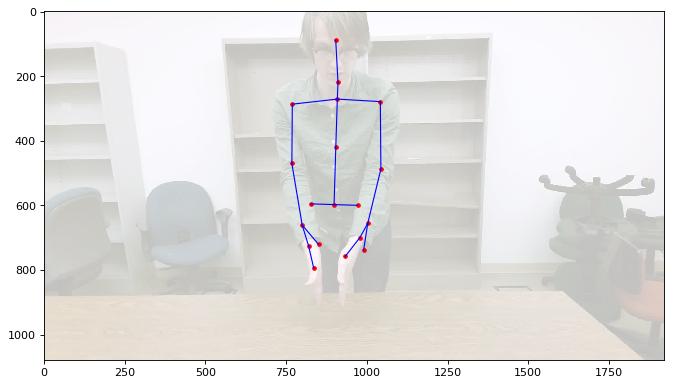

frame number (vfr) and rgb skeleton frame number 1021 1001
frame number (vfr) and rgb skeleton frame number 1022 1002
frame number (vfr) and rgb skeleton frame number 1023 1003
frame number (vfr) and rgb skeleton frame number 1024 1003
frame number (vfr) and rgb skeleton frame number 1025 1004
frame number (vfr) and rgb skeleton frame number 1026 1006
frame number (vfr) and rgb skeleton frame number 1027 1007
frame number (vfr) and rgb skeleton frame number 1028 1008
frame number (vfr) and rgb skeleton frame number 1029 1009
frame number (vfr) and rgb skeleton frame number 1030 1009
frame number (vfr) and rgb skeleton frame number 1031 1011
frame number (vfr) and rgb skeleton frame number 1032 1012
frame number (vfr) and rgb skeleton frame number 1033 1012
frame number (vfr) and rgb skeleton frame number 1034 1014
frame number (vfr) and rgb skeleton frame number 1035 1015
frame number (vfr) and rgb skeleton frame number 1036 1016
frame number (vfr) and rgb skeleton frame number 1037 10

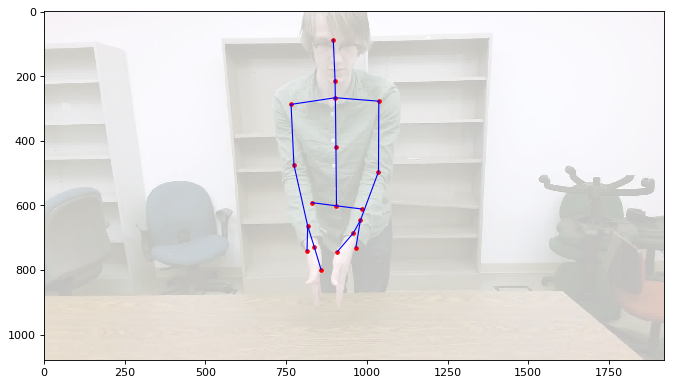

frame number (vfr) and rgb skeleton frame number 1051 1030
frame number (vfr) and rgb skeleton frame number 1052 1030
frame number (vfr) and rgb skeleton frame number 1053 1031
frame number (vfr) and rgb skeleton frame number 1054 1033
frame number (vfr) and rgb skeleton frame number 1055 1034
frame number (vfr) and rgb skeleton frame number 1056 1035
frame number (vfr) and rgb skeleton frame number 1057 1036
frame number (vfr) and rgb skeleton frame number 1058 1036
frame number (vfr) and rgb skeleton frame number 1059 1038
frame number (vfr) and rgb skeleton frame number 1060 1039
frame number (vfr) and rgb skeleton frame number 1061 1040
frame number (vfr) and rgb skeleton frame number 1062 1040
frame number (vfr) and rgb skeleton frame number 1063 1042
frame number (vfr) and rgb skeleton frame number 1064 1042
frame number (vfr) and rgb skeleton frame number 1065 1044
frame number (vfr) and rgb skeleton frame number 1066 1045
frame number (vfr) and rgb skeleton frame number 1067 10

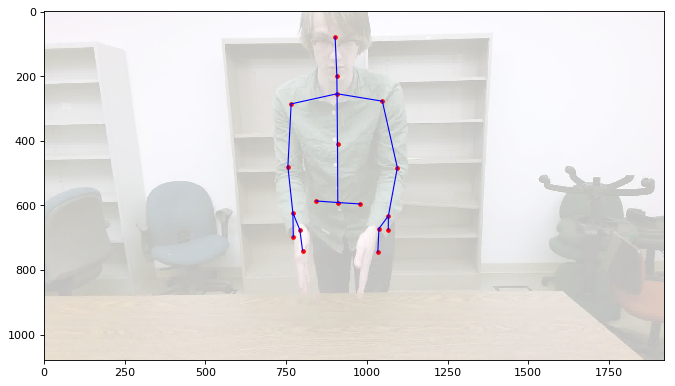

frame number (vfr) and rgb skeleton frame number 1081 1060
frame number (vfr) and rgb skeleton frame number 1082 1060
frame number (vfr) and rgb skeleton frame number 1083 1061
frame number (vfr) and rgb skeleton frame number 1084 1063
frame number (vfr) and rgb skeleton frame number 1085 1064
frame number (vfr) and rgb skeleton frame number 1086 1065
frame number (vfr) and rgb skeleton frame number 1087 1065
frame number (vfr) and rgb skeleton frame number 1088 1067
frame number (vfr) and rgb skeleton frame number 1089 1068
frame number (vfr) and rgb skeleton frame number 1090 1069
frame number (vfr) and rgb skeleton frame number 1091 1070
frame number (vfr) and rgb skeleton frame number 1092 1071
frame number (vfr) and rgb skeleton frame number 1093 1071
frame number (vfr) and rgb skeleton frame number 1094 1072
frame number (vfr) and rgb skeleton frame number 1095 1074
frame number (vfr) and rgb skeleton frame number 1096 1075
frame number (vfr) and rgb skeleton frame number 1097 10

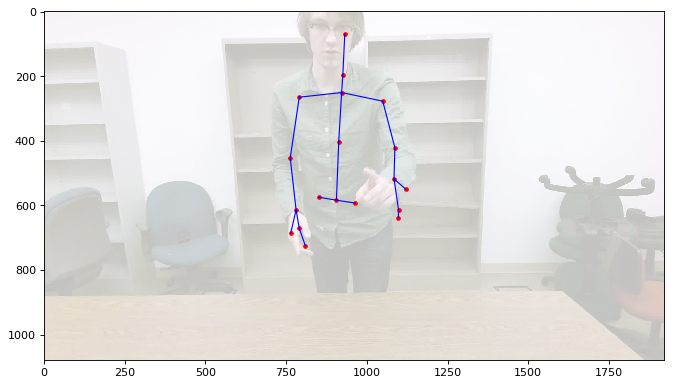

frame number (vfr) and rgb skeleton frame number 1111 1090
frame number (vfr) and rgb skeleton frame number 1112 1091
frame number (vfr) and rgb skeleton frame number 1113 1092
frame number (vfr) and rgb skeleton frame number 1114 1093
frame number (vfr) and rgb skeleton frame number 1115 1094
frame number (vfr) and rgb skeleton frame number 1116 1094
frame number (vfr) and rgb skeleton frame number 1117 1095
frame number (vfr) and rgb skeleton frame number 1118 1096
frame number (vfr) and rgb skeleton frame number 1119 1098
frame number (vfr) and rgb skeleton frame number 1120 1099
frame number (vfr) and rgb skeleton frame number 1121 1100
frame number (vfr) and rgb skeleton frame number 1122 1101
frame number (vfr) and rgb skeleton frame number 1123 1102
frame number (vfr) and rgb skeleton frame number 1124 1103
frame number (vfr) and rgb skeleton frame number 1125 1104
frame number (vfr) and rgb skeleton frame number 1126 1104
frame number (vfr) and rgb skeleton frame number 1127 11

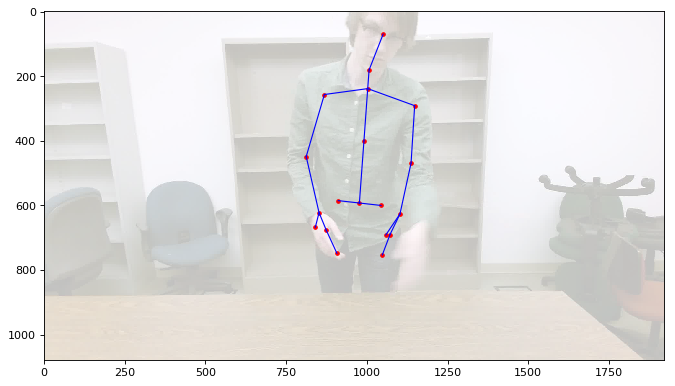

frame number (vfr) and rgb skeleton frame number 1141 1119
frame number (vfr) and rgb skeleton frame number 1142 1120
frame number (vfr) and rgb skeleton frame number 1143 1121
frame number (vfr) and rgb skeleton frame number 1144 1121
frame number (vfr) and rgb skeleton frame number 1145 1123
frame number (vfr) and rgb skeleton frame number 1146 1124
frame number (vfr) and rgb skeleton frame number 1147 1125
frame number (vfr) and rgb skeleton frame number 1148 1125
frame number (vfr) and rgb skeleton frame number 1149 1126
frame number (vfr) and rgb skeleton frame number 1150 1128
frame number (vfr) and rgb skeleton frame number 1151 1129
frame number (vfr) and rgb skeleton frame number 1152 1130
frame number (vfr) and rgb skeleton frame number 1153 1130
frame number (vfr) and rgb skeleton frame number 1154 1131
frame number (vfr) and rgb skeleton frame number 1155 1132
frame number (vfr) and rgb skeleton frame number 1156 1133
frame number (vfr) and rgb skeleton frame number 1157 11

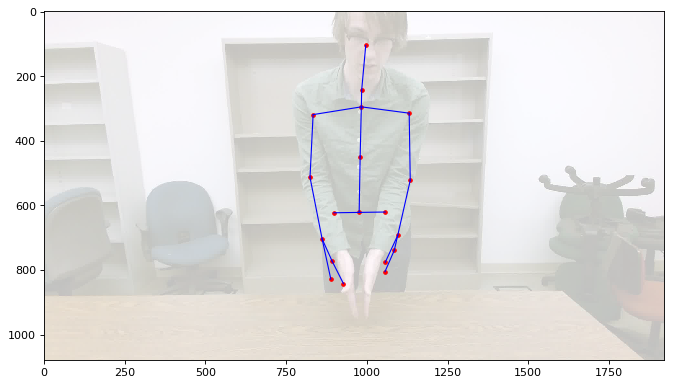

frame number (vfr) and rgb skeleton frame number 1171 1148
frame number (vfr) and rgb skeleton frame number 1172 1150
frame number (vfr) and rgb skeleton frame number 1173 1151
frame number (vfr) and rgb skeleton frame number 1174 1152
frame number (vfr) and rgb skeleton frame number 1175 1153
frame number (vfr) and rgb skeleton frame number 1176 1154
frame number (vfr) and rgb skeleton frame number 1177 1155
frame number (vfr) and rgb skeleton frame number 1178 1155
frame number (vfr) and rgb skeleton frame number 1179 1156
frame number (vfr) and rgb skeleton frame number 1180 1157
frame number (vfr) and rgb skeleton frame number 1181 1158
frame number (vfr) and rgb skeleton frame number 1182 1159
frame number (vfr) and rgb skeleton frame number 1183 1161
frame number (vfr) and rgb skeleton frame number 1184 1162
frame number (vfr) and rgb skeleton frame number 1185 1163
frame number (vfr) and rgb skeleton frame number 1186 1163
frame number (vfr) and rgb skeleton frame number 1187 11

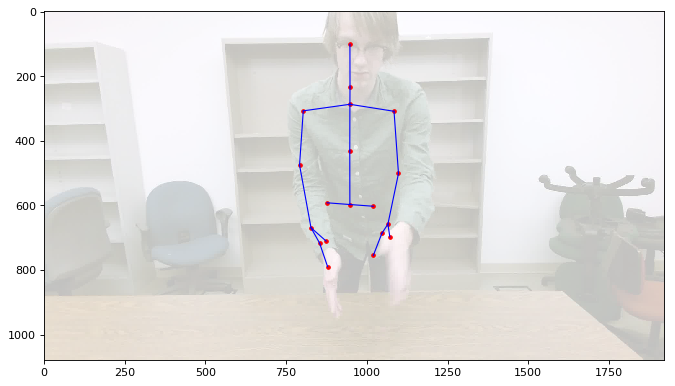

frame number (vfr) and rgb skeleton frame number 1201 1179
frame number (vfr) and rgb skeleton frame number 1202 1179
frame number (vfr) and rgb skeleton frame number 1203 1181
frame number (vfr) and rgb skeleton frame number 1204 1182
frame number (vfr) and rgb skeleton frame number 1205 1182
frame number (vfr) and rgb skeleton frame number 1206 1184
frame number (vfr) and rgb skeleton frame number 1207 1185
frame number (vfr) and rgb skeleton frame number 1208 1186
frame number (vfr) and rgb skeleton frame number 1209 1186
frame number (vfr) and rgb skeleton frame number 1210 1188
frame number (vfr) and rgb skeleton frame number 1211 1189
frame number (vfr) and rgb skeleton frame number 1212 1190
frame number (vfr) and rgb skeleton frame number 1213 1190
frame number (vfr) and rgb skeleton frame number 1214 1192
frame number (vfr) and rgb skeleton frame number 1215 1193
frame number (vfr) and rgb skeleton frame number 1216 1193
frame number (vfr) and rgb skeleton frame number 1217 11

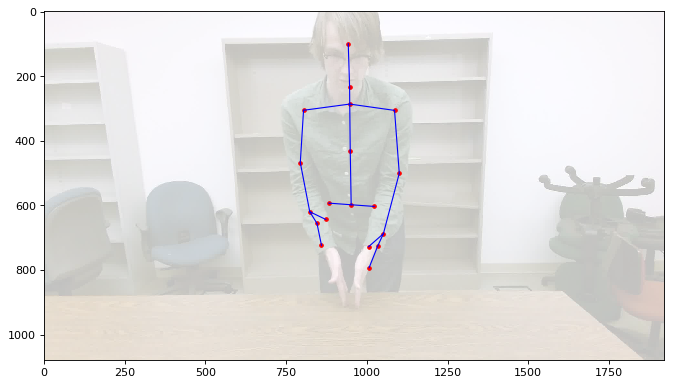

frame number (vfr) and rgb skeleton frame number 1231 1209
frame number (vfr) and rgb skeleton frame number 1232 1210
frame number (vfr) and rgb skeleton frame number 1233 1210
frame number (vfr) and rgb skeleton frame number 1234 1212
frame number (vfr) and rgb skeleton frame number 1235 1213
frame number (vfr) and rgb skeleton frame number 1236 1214
frame number (vfr) and rgb skeleton frame number 1237 1215
frame number (vfr) and rgb skeleton frame number 1238 1216
frame number (vfr) and rgb skeleton frame number 1239 1217
frame number (vfr) and rgb skeleton frame number 1240 1218
frame number (vfr) and rgb skeleton frame number 1241 1218
frame number (vfr) and rgb skeleton frame number 1242 1220
frame number (vfr) and rgb skeleton frame number 1243 1221
frame number (vfr) and rgb skeleton frame number 1244 1222
frame number (vfr) and rgb skeleton frame number 1245 1223
frame number (vfr) and rgb skeleton frame number 1246 1223
frame number (vfr) and rgb skeleton frame number 1247 12

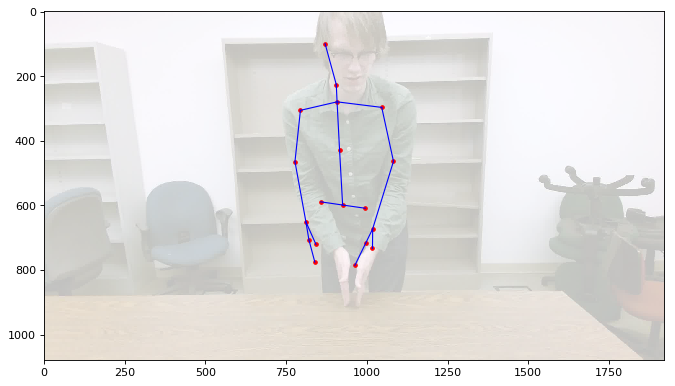

frame number (vfr) and rgb skeleton frame number 1261 1239
frame number (vfr) and rgb skeleton frame number 1262 1239
frame number (vfr) and rgb skeleton frame number 1263 1240
frame number (vfr) and rgb skeleton frame number 1264 1241
frame number (vfr) and rgb skeleton frame number 1265 1242
frame number (vfr) and rgb skeleton frame number 1266 1243
frame number (vfr) and rgb skeleton frame number 1267 1244
frame number (vfr) and rgb skeleton frame number 1268 1245
frame number (vfr) and rgb skeleton frame number 1269 1246
frame number (vfr) and rgb skeleton frame number 1270 1247
frame number (vfr) and rgb skeleton frame number 1271 1248
frame number (vfr) and rgb skeleton frame number 1272 1249
frame number (vfr) and rgb skeleton frame number 1273 1250
frame number (vfr) and rgb skeleton frame number 1274 1251
frame number (vfr) and rgb skeleton frame number 1275 1252
frame number (vfr) and rgb skeleton frame number 1276 1253
frame number (vfr) and rgb skeleton frame number 1277 12

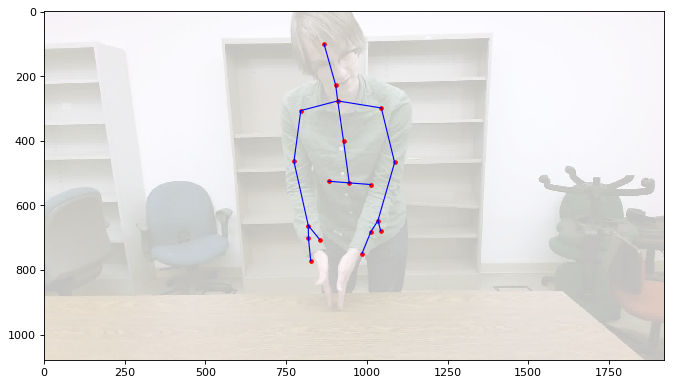

frame number (vfr) and rgb skeleton frame number 1291 1268
frame number (vfr) and rgb skeleton frame number 1292 1268
frame number (vfr) and rgb skeleton frame number 1293 1270
frame number (vfr) and rgb skeleton frame number 1294 1271
frame number (vfr) and rgb skeleton frame number 1295 1271
frame number (vfr) and rgb skeleton frame number 1296 1272
frame number (vfr) and rgb skeleton frame number 1297 1273
frame number (vfr) and rgb skeleton frame number 1298 1274
frame number (vfr) and rgb skeleton frame number 1299 1275
frame number (vfr) and rgb skeleton frame number 1300 1276
frame number (vfr) and rgb skeleton frame number 1301 1277
frame number (vfr) and rgb skeleton frame number 1302 1279
frame number (vfr) and rgb skeleton frame number 1303 1280
frame number (vfr) and rgb skeleton frame number 1304 1280
frame number (vfr) and rgb skeleton frame number 1305 1281
frame number (vfr) and rgb skeleton frame number 1306 1283
frame number (vfr) and rgb skeleton frame number 1307 12

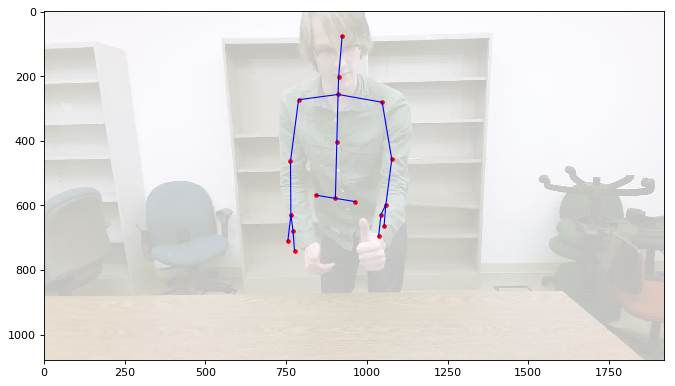

frame number (vfr) and rgb skeleton frame number 1321 1298
frame number (vfr) and rgb skeleton frame number 1322 1298
frame number (vfr) and rgb skeleton frame number 1323 1299
frame number (vfr) and rgb skeleton frame number 1324 1301
frame number (vfr) and rgb skeleton frame number 1325 1302
frame number (vfr) and rgb skeleton frame number 1326 1303
frame number (vfr) and rgb skeleton frame number 1327 1303
frame number (vfr) and rgb skeleton frame number 1328 1304
frame number (vfr) and rgb skeleton frame number 1329 1305
frame number (vfr) and rgb skeleton frame number 1330 1307
frame number (vfr) and rgb skeleton frame number 1331 1307
frame number (vfr) and rgb skeleton frame number 1332 1309
frame number (vfr) and rgb skeleton frame number 1333 1310
frame number (vfr) and rgb skeleton frame number 1334 1311
frame number (vfr) and rgb skeleton frame number 1335 1311
frame number (vfr) and rgb skeleton frame number 1336 1312
frame number (vfr) and rgb skeleton frame number 1337 13

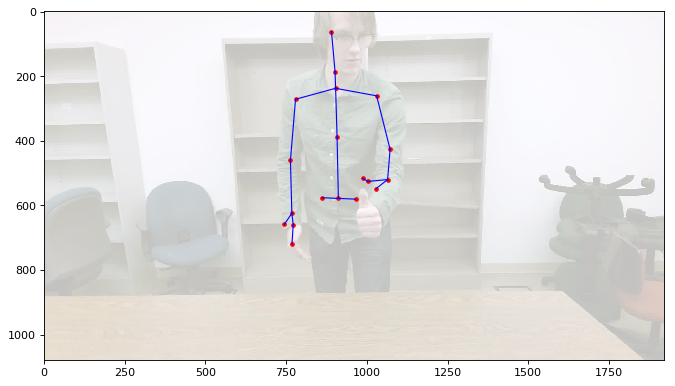

frame number (vfr) and rgb skeleton frame number 1351 1328
frame number (vfr) and rgb skeleton frame number 1352 1328
frame number (vfr) and rgb skeleton frame number 1353 1329
frame number (vfr) and rgb skeleton frame number 1354 1330
frame number (vfr) and rgb skeleton frame number 1355 1332
frame number (vfr) and rgb skeleton frame number 1356 1333
frame number (vfr) and rgb skeleton frame number 1357 1333
frame number (vfr) and rgb skeleton frame number 1358 1334
frame number (vfr) and rgb skeleton frame number 1359 1336
frame number (vfr) and rgb skeleton frame number 1360 1337
frame number (vfr) and rgb skeleton frame number 1361 1338
frame number (vfr) and rgb skeleton frame number 1362 1339
frame number (vfr) and rgb skeleton frame number 1363 1339
frame number (vfr) and rgb skeleton frame number 1364 1340
frame number (vfr) and rgb skeleton frame number 1365 1341
frame number (vfr) and rgb skeleton frame number 1366 1343
frame number (vfr) and rgb skeleton frame number 1367 13

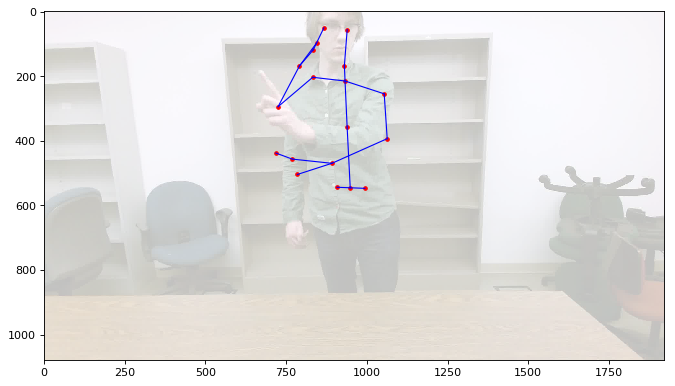

frame number (vfr) and rgb skeleton frame number 1381 1358
frame number (vfr) and rgb skeleton frame number 1382 1359
frame number (vfr) and rgb skeleton frame number 1383 1360
frame number (vfr) and rgb skeleton frame number 1384 1361
frame number (vfr) and rgb skeleton frame number 1385 1362
frame number (vfr) and rgb skeleton frame number 1386 1363
frame number (vfr) and rgb skeleton frame number 1387 1364
frame number (vfr) and rgb skeleton frame number 1388 1365
frame number (vfr) and rgb skeleton frame number 1389 1366
frame number (vfr) and rgb skeleton frame number 1390 1367
frame number (vfr) and rgb skeleton frame number 1391 1368
frame number (vfr) and rgb skeleton frame number 1392 1368
frame number (vfr) and rgb skeleton frame number 1393 1370
frame number (vfr) and rgb skeleton frame number 1394 1370
frame number (vfr) and rgb skeleton frame number 1395 1372
frame number (vfr) and rgb skeleton frame number 1396 1373
frame number (vfr) and rgb skeleton frame number 1397 13

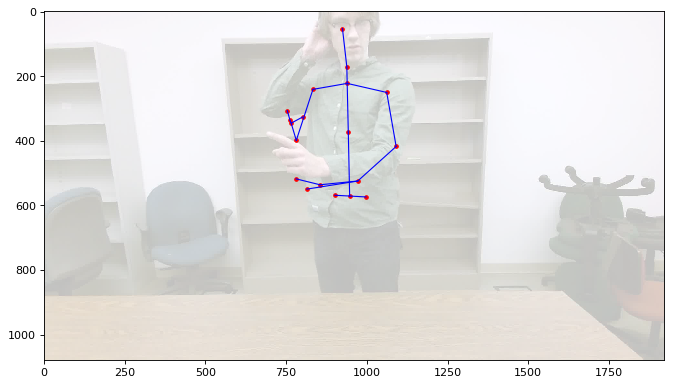

frame number (vfr) and rgb skeleton frame number 1411 1388
frame number (vfr) and rgb skeleton frame number 1412 1388
frame number (vfr) and rgb skeleton frame number 1413 1389
frame number (vfr) and rgb skeleton frame number 1414 1391
frame number (vfr) and rgb skeleton frame number 1415 1392
frame number (vfr) and rgb skeleton frame number 1416 1392
frame number (vfr) and rgb skeleton frame number 1417 1394
frame number (vfr) and rgb skeleton frame number 1418 1395
frame number (vfr) and rgb skeleton frame number 1419 1396
frame number (vfr) and rgb skeleton frame number 1420 1397
frame number (vfr) and rgb skeleton frame number 1421 1397
frame number (vfr) and rgb skeleton frame number 1422 1398
frame number (vfr) and rgb skeleton frame number 1423 1399
frame number (vfr) and rgb skeleton frame number 1424 1401
frame number (vfr) and rgb skeleton frame number 1425 1402
frame number (vfr) and rgb skeleton frame number 1426 1402
frame number (vfr) and rgb skeleton frame number 1427 14

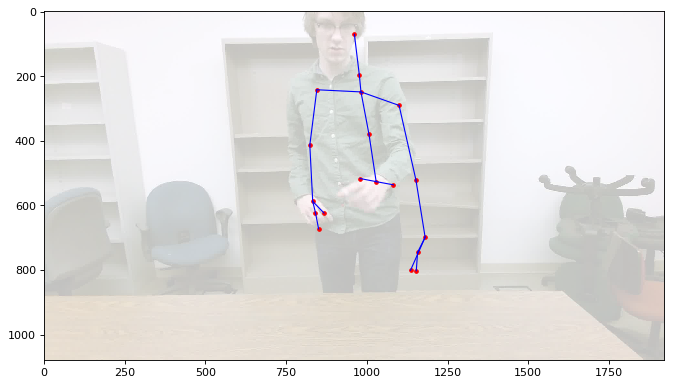

frame number (vfr) and rgb skeleton frame number 1441 1417
frame number (vfr) and rgb skeleton frame number 1442 1419
frame number (vfr) and rgb skeleton frame number 1443 1420
frame number (vfr) and rgb skeleton frame number 1444 1421
frame number (vfr) and rgb skeleton frame number 1445 1422
frame number (vfr) and rgb skeleton frame number 1446 1422
frame number (vfr) and rgb skeleton frame number 1447 1423
frame number (vfr) and rgb skeleton frame number 1448 1425
frame number (vfr) and rgb skeleton frame number 1449 1425
frame number (vfr) and rgb skeleton frame number 1450 1426
frame number (vfr) and rgb skeleton frame number 1451 1427
frame number (vfr) and rgb skeleton frame number 1452 1428
frame number (vfr) and rgb skeleton frame number 1453 1430
frame number (vfr) and rgb skeleton frame number 1454 1430
frame number (vfr) and rgb skeleton frame number 1455 1432
frame number (vfr) and rgb skeleton frame number 1456 1433
frame number (vfr) and rgb skeleton frame number 1457 14

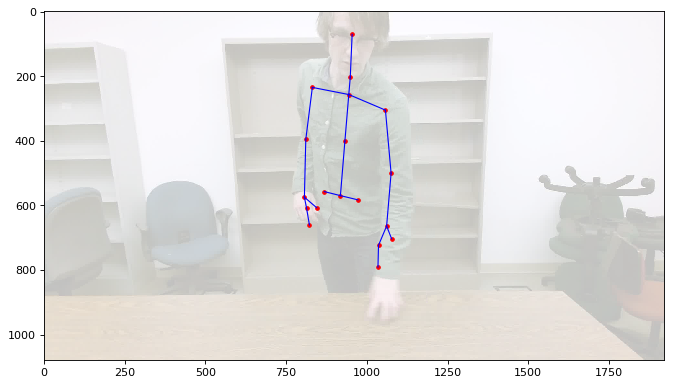

frame number (vfr) and rgb skeleton frame number 1471 1447
frame number (vfr) and rgb skeleton frame number 1472 1449
frame number (vfr) and rgb skeleton frame number 1473 1450
frame number (vfr) and rgb skeleton frame number 1474 1451
frame number (vfr) and rgb skeleton frame number 1475 1451
frame number (vfr) and rgb skeleton frame number 1476 1452
frame number (vfr) and rgb skeleton frame number 1477 1453
frame number (vfr) and rgb skeleton frame number 1478 1454
frame number (vfr) and rgb skeleton frame number 1479 1455
frame number (vfr) and rgb skeleton frame number 1480 1456
frame number (vfr) and rgb skeleton frame number 1481 1456
frame number (vfr) and rgb skeleton frame number 1482 1458
frame number (vfr) and rgb skeleton frame number 1483 1459
frame number (vfr) and rgb skeleton frame number 1484 1460
frame number (vfr) and rgb skeleton frame number 1485 1461
frame number (vfr) and rgb skeleton frame number 1486 1462
frame number (vfr) and rgb skeleton frame number 1487 14

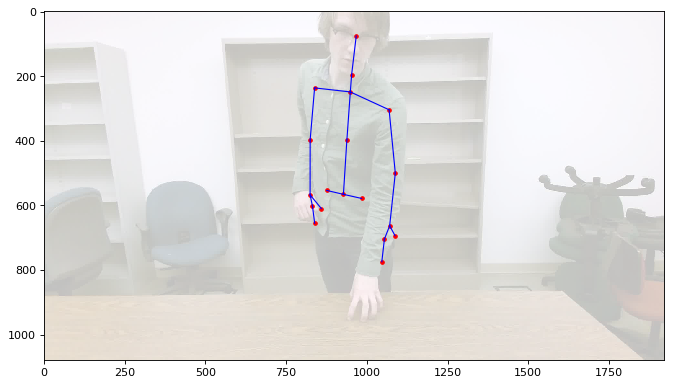

frame number (vfr) and rgb skeleton frame number 1501 1477
frame number (vfr) and rgb skeleton frame number 1502 1478
frame number (vfr) and rgb skeleton frame number 1503 1478
frame number (vfr) and rgb skeleton frame number 1504 1479
frame number (vfr) and rgb skeleton frame number 1505 1480
frame number (vfr) and rgb skeleton frame number 1506 1482
frame number (vfr) and rgb skeleton frame number 1507 1483
frame number (vfr) and rgb skeleton frame number 1508 1484
frame number (vfr) and rgb skeleton frame number 1509 1484
frame number (vfr) and rgb skeleton frame number 1510 1486
frame number (vfr) and rgb skeleton frame number 1511 1486
frame number (vfr) and rgb skeleton frame number 1512 1487
frame number (vfr) and rgb skeleton frame number 1513 1488
frame number (vfr) and rgb skeleton frame number 1514 1489
frame number (vfr) and rgb skeleton frame number 1515 1490
frame number (vfr) and rgb skeleton frame number 1516 1492
frame number (vfr) and rgb skeleton frame number 1517 14

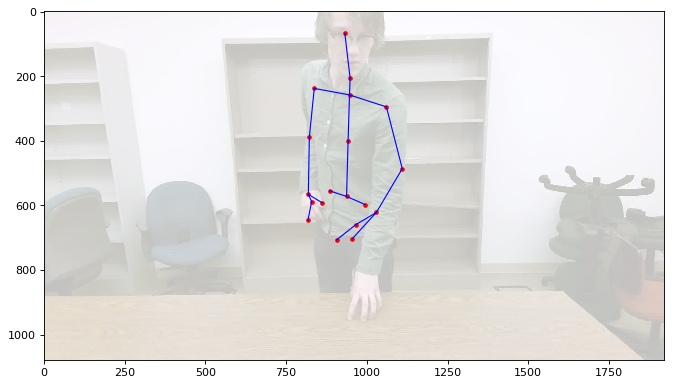

frame number (vfr) and rgb skeleton frame number 1531 1506
frame number (vfr) and rgb skeleton frame number 1532 1508
frame number (vfr) and rgb skeleton frame number 1533 1508
frame number (vfr) and rgb skeleton frame number 1534 1509
frame number (vfr) and rgb skeleton frame number 1535 1510
frame number (vfr) and rgb skeleton frame number 1536 1511
frame number (vfr) and rgb skeleton frame number 1537 1512
frame number (vfr) and rgb skeleton frame number 1538 1514
frame number (vfr) and rgb skeleton frame number 1539 1515
frame number (vfr) and rgb skeleton frame number 1540 1515
frame number (vfr) and rgb skeleton frame number 1541 1516
frame number (vfr) and rgb skeleton frame number 1542 1518
frame number (vfr) and rgb skeleton frame number 1543 1519
frame number (vfr) and rgb skeleton frame number 1544 1520
frame number (vfr) and rgb skeleton frame number 1545 1521
frame number (vfr) and rgb skeleton frame number 1546 1522
frame number (vfr) and rgb skeleton frame number 1547 15

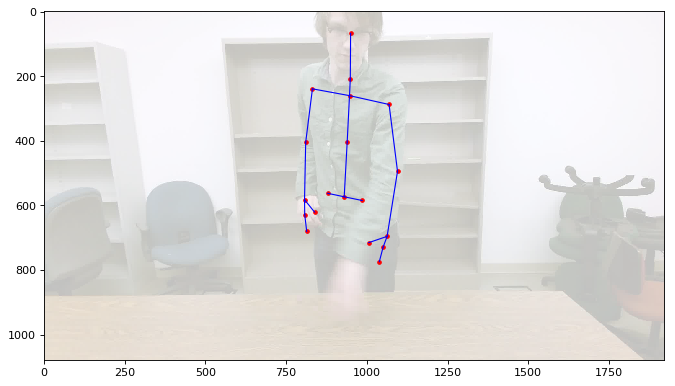

frame number (vfr) and rgb skeleton frame number 1561 1537
frame number (vfr) and rgb skeleton frame number 1562 1538
frame number (vfr) and rgb skeleton frame number 1563 1538
frame number (vfr) and rgb skeleton frame number 1564 1539
frame number (vfr) and rgb skeleton frame number 1565 1541
frame number (vfr) and rgb skeleton frame number 1566 1541
frame number (vfr) and rgb skeleton frame number 1567 1542
frame number (vfr) and rgb skeleton frame number 1568 1543
frame number (vfr) and rgb skeleton frame number 1569 1545
frame number (vfr) and rgb skeleton frame number 1570 1546
frame number (vfr) and rgb skeleton frame number 1571 1547
frame number (vfr) and rgb skeleton frame number 1572 1548
frame number (vfr) and rgb skeleton frame number 1573 1548
frame number (vfr) and rgb skeleton frame number 1574 1549
frame number (vfr) and rgb skeleton frame number 1575 1550
frame number (vfr) and rgb skeleton frame number 1576 1552
frame number (vfr) and rgb skeleton frame number 1577 15

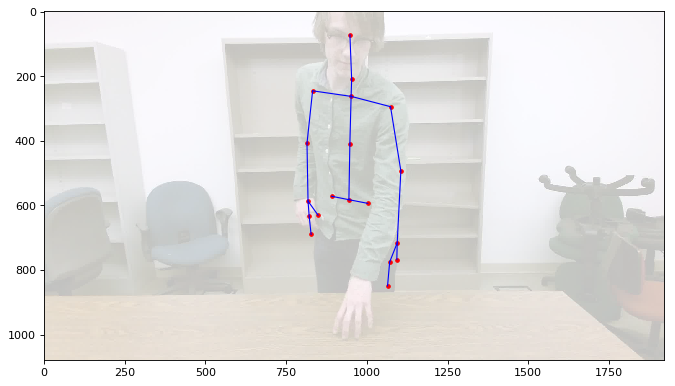

frame number (vfr) and rgb skeleton frame number 1591 1567
frame number (vfr) and rgb skeleton frame number 1592 1568
frame number (vfr) and rgb skeleton frame number 1593 1568
frame number (vfr) and rgb skeleton frame number 1594 1569
frame number (vfr) and rgb skeleton frame number 1595 1571
frame number (vfr) and rgb skeleton frame number 1596 1572
frame number (vfr) and rgb skeleton frame number 1597 1573
frame number (vfr) and rgb skeleton frame number 1598 1573
frame number (vfr) and rgb skeleton frame number 1599 1575
frame number (vfr) and rgb skeleton frame number 1600 1576
frame number (vfr) and rgb skeleton frame number 1601 1577
frame number (vfr) and rgb skeleton frame number 1602 1577
frame number (vfr) and rgb skeleton frame number 1603 1578
frame number (vfr) and rgb skeleton frame number 1604 1579
frame number (vfr) and rgb skeleton frame number 1605 1580
frame number (vfr) and rgb skeleton frame number 1606 1581
frame number (vfr) and rgb skeleton frame number 1607 15

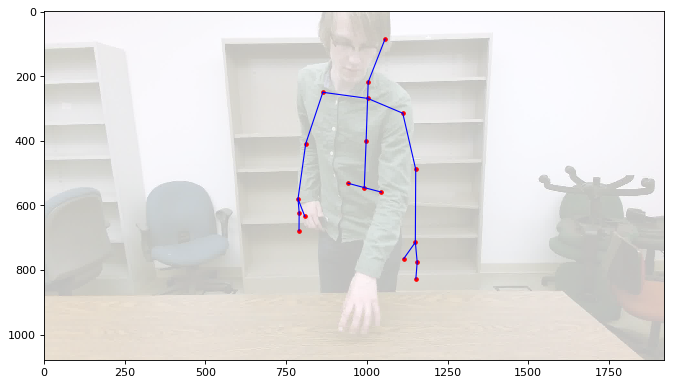

frame number (vfr) and rgb skeleton frame number 1621 1596
frame number (vfr) and rgb skeleton frame number 1622 1596
frame number (vfr) and rgb skeleton frame number 1623 1598
frame number (vfr) and rgb skeleton frame number 1624 1599
frame number (vfr) and rgb skeleton frame number 1625 1600
frame number (vfr) and rgb skeleton frame number 1626 1601
frame number (vfr) and rgb skeleton frame number 1627 1601
frame number (vfr) and rgb skeleton frame number 1628 1602
frame number (vfr) and rgb skeleton frame number 1629 1603
frame number (vfr) and rgb skeleton frame number 1630 1604
frame number (vfr) and rgb skeleton frame number 1631 1605
frame number (vfr) and rgb skeleton frame number 1632 1606
frame number (vfr) and rgb skeleton frame number 1633 1608
frame number (vfr) and rgb skeleton frame number 1634 1609
frame number (vfr) and rgb skeleton frame number 1635 1610
frame number (vfr) and rgb skeleton frame number 1636 1610
frame number (vfr) and rgb skeleton frame number 1637 16

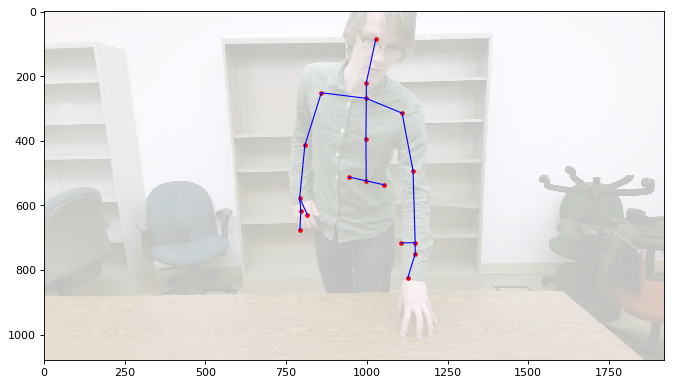

frame number (vfr) and rgb skeleton frame number 1651 1625
frame number (vfr) and rgb skeleton frame number 1652 1626
frame number (vfr) and rgb skeleton frame number 1653 1627
frame number (vfr) and rgb skeleton frame number 1654 1628
frame number (vfr) and rgb skeleton frame number 1655 1629
frame number (vfr) and rgb skeleton frame number 1656 1630
frame number (vfr) and rgb skeleton frame number 1657 1631
frame number (vfr) and rgb skeleton frame number 1658 1631
frame number (vfr) and rgb skeleton frame number 1659 1632
frame number (vfr) and rgb skeleton frame number 1660 1634
frame number (vfr) and rgb skeleton frame number 1661 1635
frame number (vfr) and rgb skeleton frame number 1662 1636
frame number (vfr) and rgb skeleton frame number 1663 1636
frame number (vfr) and rgb skeleton frame number 1664 1637
frame number (vfr) and rgb skeleton frame number 1665 1639
frame number (vfr) and rgb skeleton frame number 1666 1640
frame number (vfr) and rgb skeleton frame number 1667 16

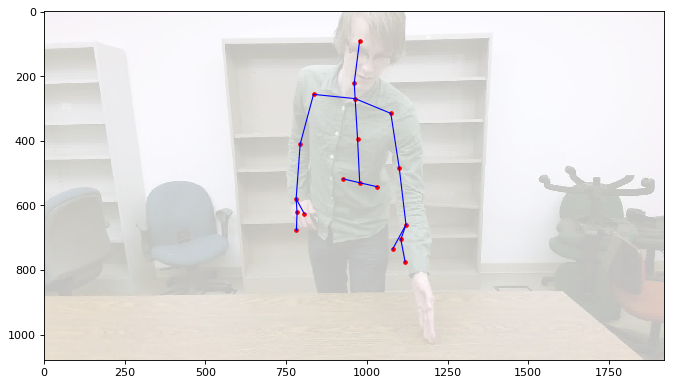

frame number (vfr) and rgb skeleton frame number 1681 1654
frame number (vfr) and rgb skeleton frame number 1682 1655
frame number (vfr) and rgb skeleton frame number 1683 1656
frame number (vfr) and rgb skeleton frame number 1684 1657
frame number (vfr) and rgb skeleton frame number 1685 1658
frame number (vfr) and rgb skeleton frame number 1686 1659
frame number (vfr) and rgb skeleton frame number 1687 1659
frame number (vfr) and rgb skeleton frame number 1688 1660
frame number (vfr) and rgb skeleton frame number 1689 1661
frame number (vfr) and rgb skeleton frame number 1690 1663
frame number (vfr) and rgb skeleton frame number 1691 1664
frame number (vfr) and rgb skeleton frame number 1692 1665
frame number (vfr) and rgb skeleton frame number 1693 1666
frame number (vfr) and rgb skeleton frame number 1694 1667
frame number (vfr) and rgb skeleton frame number 1695 1667
frame number (vfr) and rgb skeleton frame number 1696 1669
frame number (vfr) and rgb skeleton frame number 1697 16

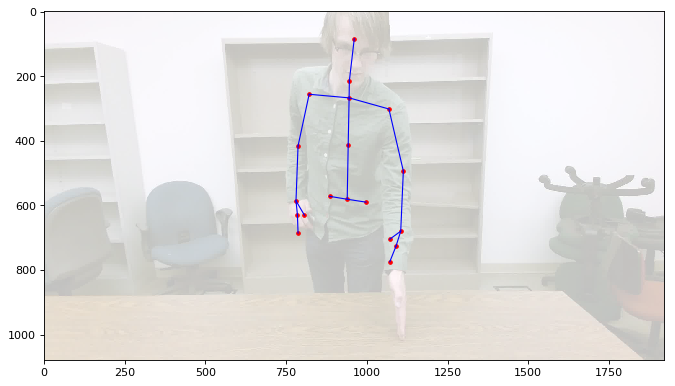

frame number (vfr) and rgb skeleton frame number 1711 1683
frame number (vfr) and rgb skeleton frame number 1712 1684
frame number (vfr) and rgb skeleton frame number 1713 1685
frame number (vfr) and rgb skeleton frame number 1714 1685
frame number (vfr) and rgb skeleton frame number 1715 1687
frame number (vfr) and rgb skeleton frame number 1716 1688
frame number (vfr) and rgb skeleton frame number 1717 1689
frame number (vfr) and rgb skeleton frame number 1718 1689
frame number (vfr) and rgb skeleton frame number 1719 1691
frame number (vfr) and rgb skeleton frame number 1720 1691
frame number (vfr) and rgb skeleton frame number 1721 1692
frame number (vfr) and rgb skeleton frame number 1722 1694
frame number (vfr) and rgb skeleton frame number 1723 1695
frame number (vfr) and rgb skeleton frame number 1724 1696
frame number (vfr) and rgb skeleton frame number 1725 1696
frame number (vfr) and rgb skeleton frame number 1726 1698
frame number (vfr) and rgb skeleton frame number 1727 16

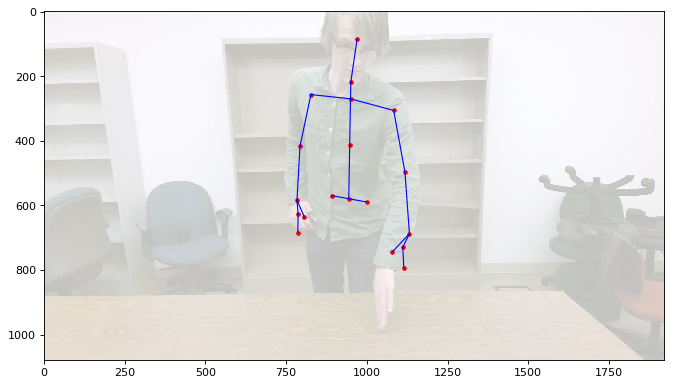

frame number (vfr) and rgb skeleton frame number 1741 1712
frame number (vfr) and rgb skeleton frame number 1742 1713
frame number (vfr) and rgb skeleton frame number 1743 1714
frame number (vfr) and rgb skeleton frame number 1744 1715
frame number (vfr) and rgb skeleton frame number 1745 1716
frame number (vfr) and rgb skeleton frame number 1746 1717
frame number (vfr) and rgb skeleton frame number 1747 1718
frame number (vfr) and rgb skeleton frame number 1748 1719
frame number (vfr) and rgb skeleton frame number 1749 1720
frame number (vfr) and rgb skeleton frame number 1750 1721
frame number (vfr) and rgb skeleton frame number 1751 1721
frame number (vfr) and rgb skeleton frame number 1752 1722
frame number (vfr) and rgb skeleton frame number 1753 1724
frame number (vfr) and rgb skeleton frame number 1754 1725
frame number (vfr) and rgb skeleton frame number 1755 1726
frame number (vfr) and rgb skeleton frame number 1756 1726
frame number (vfr) and rgb skeleton frame number 1757 17

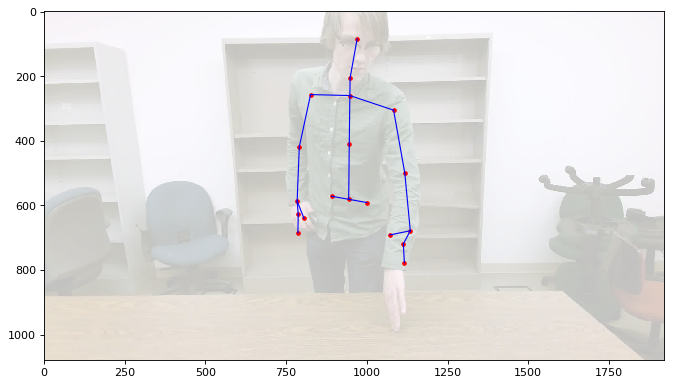

frame number (vfr) and rgb skeleton frame number 1771 1741
frame number (vfr) and rgb skeleton frame number 1772 1743
frame number (vfr) and rgb skeleton frame number 1773 1744
frame number (vfr) and rgb skeleton frame number 1774 1745
frame number (vfr) and rgb skeleton frame number 1775 1745
frame number (vfr) and rgb skeleton frame number 1776 1746
frame number (vfr) and rgb skeleton frame number 1777 1747
frame number (vfr) and rgb skeleton frame number 1778 1748
frame number (vfr) and rgb skeleton frame number 1779 1749
frame number (vfr) and rgb skeleton frame number 1780 1750
frame number (vfr) and rgb skeleton frame number 1781 1751
frame number (vfr) and rgb skeleton frame number 1782 1752
frame number (vfr) and rgb skeleton frame number 1783 1753
frame number (vfr) and rgb skeleton frame number 1784 1754
frame number (vfr) and rgb skeleton frame number 1785 1755
frame number (vfr) and rgb skeleton frame number 1786 1755
frame number (vfr) and rgb skeleton frame number 1787 17

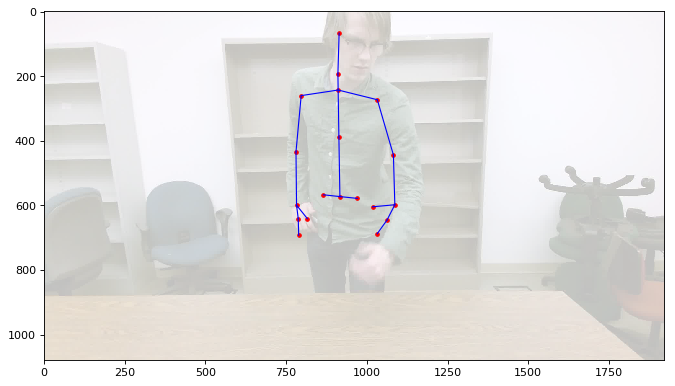

frame number (vfr) and rgb skeleton frame number 1801 1771
frame number (vfr) and rgb skeleton frame number 1802 1772
frame number (vfr) and rgb skeleton frame number 1803 1773
frame number (vfr) and rgb skeleton frame number 1804 1774
frame number (vfr) and rgb skeleton frame number 1805 1775
frame number (vfr) and rgb skeleton frame number 1806 1776
frame number (vfr) and rgb skeleton frame number 1807 1777
frame number (vfr) and rgb skeleton frame number 1808 1778
frame number (vfr) and rgb skeleton frame number 1809 1779
frame number (vfr) and rgb skeleton frame number 1810 1780
frame number (vfr) and rgb skeleton frame number 1811 1781
frame number (vfr) and rgb skeleton frame number 1812 1782
frame number (vfr) and rgb skeleton frame number 1813 1783
frame number (vfr) and rgb skeleton frame number 1814 1784
frame number (vfr) and rgb skeleton frame number 1815 1785
frame number (vfr) and rgb skeleton frame number 1816 1785
frame number (vfr) and rgb skeleton frame number 1817 17

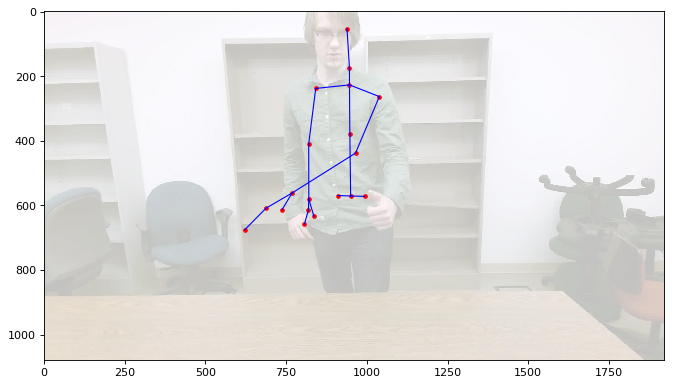

frame number (vfr) and rgb skeleton frame number 1831 1801
frame number (vfr) and rgb skeleton frame number 1832 1802
frame number (vfr) and rgb skeleton frame number 1833 1803
frame number (vfr) and rgb skeleton frame number 1834 1804
frame number (vfr) and rgb skeleton frame number 1835 1805
frame number (vfr) and rgb skeleton frame number 1836 1805
frame number (vfr) and rgb skeleton frame number 1837 1806
frame number (vfr) and rgb skeleton frame number 1838 1807
frame number (vfr) and rgb skeleton frame number 1839 1808
frame number (vfr) and rgb skeleton frame number 1840 1809
frame number (vfr) and rgb skeleton frame number 1841 1809
frame number (vfr) and rgb skeleton frame number 1842 1810
frame number (vfr) and rgb skeleton frame number 1843 1812
frame number (vfr) and rgb skeleton frame number 1844 1813
frame number (vfr) and rgb skeleton frame number 1845 1814
frame number (vfr) and rgb skeleton frame number 1846 1815
frame number (vfr) and rgb skeleton frame number 1847 18

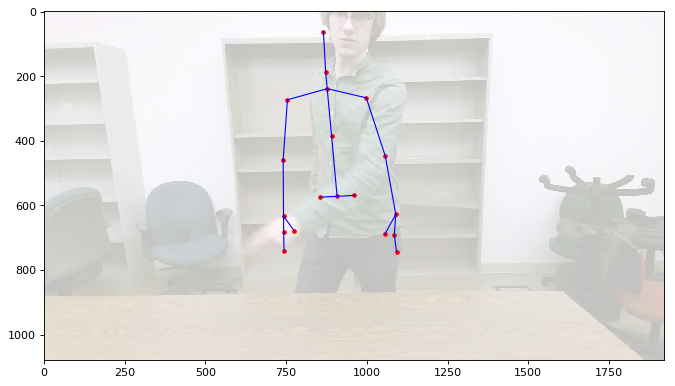

frame number (vfr) and rgb skeleton frame number 1861 1830
frame number (vfr) and rgb skeleton frame number 1862 1831
frame number (vfr) and rgb skeleton frame number 1863 1831
frame number (vfr) and rgb skeleton frame number 1864 1833
frame number (vfr) and rgb skeleton frame number 1865 1834
frame number (vfr) and rgb skeleton frame number 1866 1835
frame number (vfr) and rgb skeleton frame number 1867 1836
frame number (vfr) and rgb skeleton frame number 1868 1837
frame number (vfr) and rgb skeleton frame number 1869 1838
frame number (vfr) and rgb skeleton frame number 1870 1838
frame number (vfr) and rgb skeleton frame number 1871 1840
frame number (vfr) and rgb skeleton frame number 1872 1840
frame number (vfr) and rgb skeleton frame number 1873 1841
frame number (vfr) and rgb skeleton frame number 1874 1843
frame number (vfr) and rgb skeleton frame number 1875 1844
frame number (vfr) and rgb skeleton frame number 1876 1845
frame number (vfr) and rgb skeleton frame number 1877 18

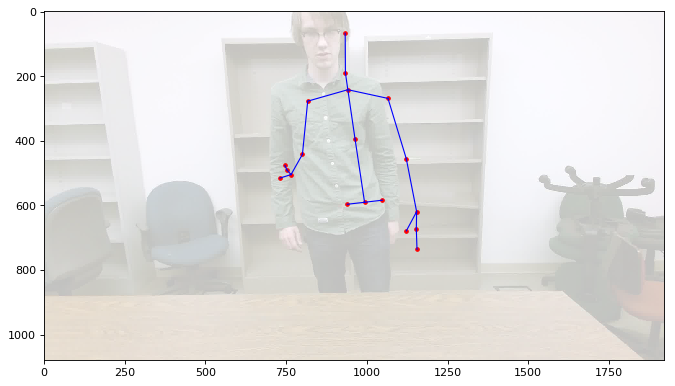

frame number (vfr) and rgb skeleton frame number 1891 1859
frame number (vfr) and rgb skeleton frame number 1892 1859
frame number (vfr) and rgb skeleton frame number 1893 1860
frame number (vfr) and rgb skeleton frame number 1894 1861
frame number (vfr) and rgb skeleton frame number 1895 1863
frame number (vfr) and rgb skeleton frame number 1896 1864
frame number (vfr) and rgb skeleton frame number 1897 1865
frame number (vfr) and rgb skeleton frame number 1898 1866
frame number (vfr) and rgb skeleton frame number 1899 1867
frame number (vfr) and rgb skeleton frame number 1900 1868
frame number (vfr) and rgb skeleton frame number 1901 1868
frame number (vfr) and rgb skeleton frame number 1902 1869
frame number (vfr) and rgb skeleton frame number 1903 1870
frame number (vfr) and rgb skeleton frame number 1904 1872
frame number (vfr) and rgb skeleton frame number 1905 1873
frame number (vfr) and rgb skeleton frame number 1906 1874
frame number (vfr) and rgb skeleton frame number 1907 18

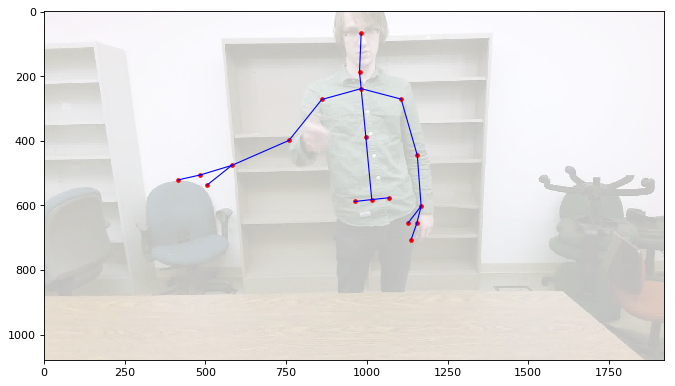

frame number (vfr) and rgb skeleton frame number 1921 1888
frame number (vfr) and rgb skeleton frame number 1922 1889
frame number (vfr) and rgb skeleton frame number 1923 1890
frame number (vfr) and rgb skeleton frame number 1924 1891
frame number (vfr) and rgb skeleton frame number 1925 1892
frame number (vfr) and rgb skeleton frame number 1926 1893
frame number (vfr) and rgb skeleton frame number 1927 1894
frame number (vfr) and rgb skeleton frame number 1928 1895
frame number (vfr) and rgb skeleton frame number 1929 1896
frame number (vfr) and rgb skeleton frame number 1930 1897
frame number (vfr) and rgb skeleton frame number 1931 1898
frame number (vfr) and rgb skeleton frame number 1932 1899
frame number (vfr) and rgb skeleton frame number 1933 1900
frame number (vfr) and rgb skeleton frame number 1934 1901
frame number (vfr) and rgb skeleton frame number 1935 1902
frame number (vfr) and rgb skeleton frame number 1936 1903
frame number (vfr) and rgb skeleton frame number 1937 19

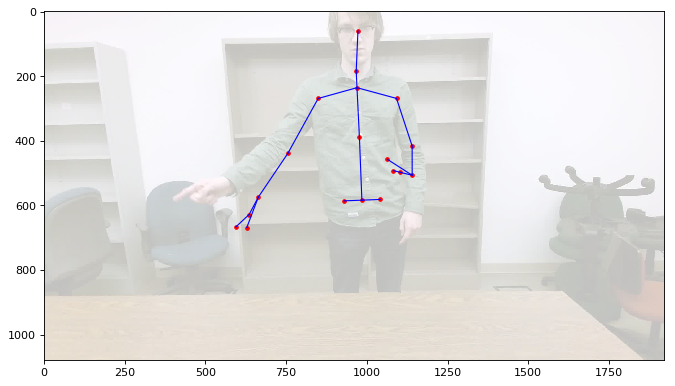

frame number (vfr) and rgb skeleton frame number 1951 1918
frame number (vfr) and rgb skeleton frame number 1952 1919
frame number (vfr) and rgb skeleton frame number 1953 1920
frame number (vfr) and rgb skeleton frame number 1954 1921
frame number (vfr) and rgb skeleton frame number 1955 1922
frame number (vfr) and rgb skeleton frame number 1956 1923
frame number (vfr) and rgb skeleton frame number 1957 1924
frame number (vfr) and rgb skeleton frame number 1958 1925
frame number (vfr) and rgb skeleton frame number 1959 1926
frame number (vfr) and rgb skeleton frame number 1960 1927
frame number (vfr) and rgb skeleton frame number 1961 1928
frame number (vfr) and rgb skeleton frame number 1962 1928
frame number (vfr) and rgb skeleton frame number 1963 1930
frame number (vfr) and rgb skeleton frame number 1964 1931
frame number (vfr) and rgb skeleton frame number 1965 1931
frame number (vfr) and rgb skeleton frame number 1966 1932
frame number (vfr) and rgb skeleton frame number 1967 19

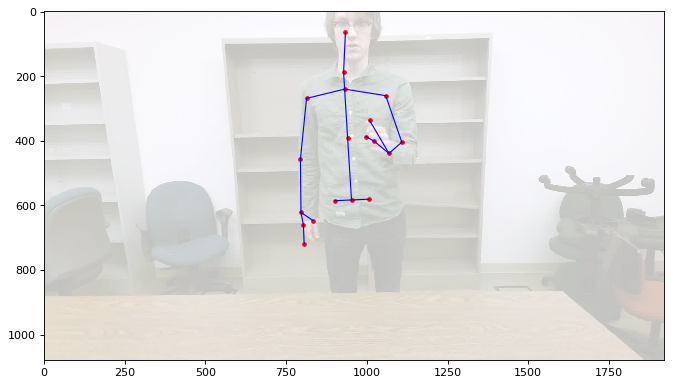

frame number (vfr) and rgb skeleton frame number 1981 1948
frame number (vfr) and rgb skeleton frame number 1982 1949
frame number (vfr) and rgb skeleton frame number 1983 1950
frame number (vfr) and rgb skeleton frame number 1984 1950
frame number (vfr) and rgb skeleton frame number 1985 1951
frame number (vfr) and rgb skeleton frame number 1986 1953
frame number (vfr) and rgb skeleton frame number 1987 1954
frame number (vfr) and rgb skeleton frame number 1988 1955
frame number (vfr) and rgb skeleton frame number 1989 1956
frame number (vfr) and rgb skeleton frame number 1990 1957
frame number (vfr) and rgb skeleton frame number 1991 1958
frame number (vfr) and rgb skeleton frame number 1992 1959
frame number (vfr) and rgb skeleton frame number 1993 1960
frame number (vfr) and rgb skeleton frame number 1994 1961
frame number (vfr) and rgb skeleton frame number 1995 1961
frame number (vfr) and rgb skeleton frame number 1996 1963
frame number (vfr) and rgb skeleton frame number 1997 19

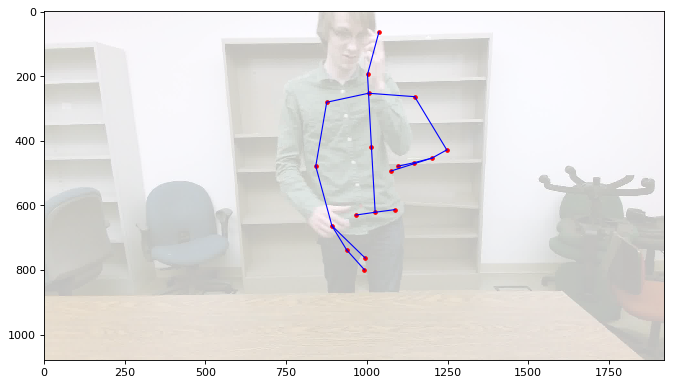

frame number (vfr) and rgb skeleton frame number 2011 1978
frame number (vfr) and rgb skeleton frame number 2012 1978
frame number (vfr) and rgb skeleton frame number 2013 1979
frame number (vfr) and rgb skeleton frame number 2014 1981
frame number (vfr) and rgb skeleton frame number 2015 1982
frame number (vfr) and rgb skeleton frame number 2016 1983
frame number (vfr) and rgb skeleton frame number 2017 1984
frame number (vfr) and rgb skeleton frame number 2018 1984
frame number (vfr) and rgb skeleton frame number 2019 1985
frame number (vfr) and rgb skeleton frame number 2020 1987
frame number (vfr) and rgb skeleton frame number 2021 1988
frame number (vfr) and rgb skeleton frame number 2022 1988
frame number (vfr) and rgb skeleton frame number 2023 1990
frame number (vfr) and rgb skeleton frame number 2024 1991
frame number (vfr) and rgb skeleton frame number 2025 1992
frame number (vfr) and rgb skeleton frame number 2026 1992
frame number (vfr) and rgb skeleton frame number 2027 19

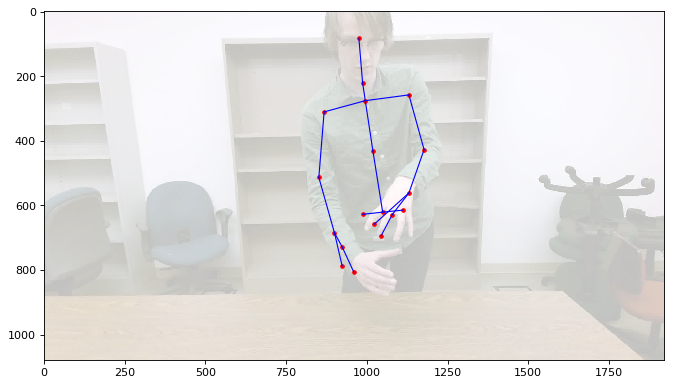

frame number (vfr) and rgb skeleton frame number 2041 2007
frame number (vfr) and rgb skeleton frame number 2042 2007
frame number (vfr) and rgb skeleton frame number 2043 2008
frame number (vfr) and rgb skeleton frame number 2044 2010
frame number (vfr) and rgb skeleton frame number 2045 2011
frame number (vfr) and rgb skeleton frame number 2046 2011
frame number (vfr) and rgb skeleton frame number 2047 2012
frame number (vfr) and rgb skeleton frame number 2048 2013
frame number (vfr) and rgb skeleton frame number 2049 2014
frame number (vfr) and rgb skeleton frame number 2050 2016
frame number (vfr) and rgb skeleton frame number 2051 2016
frame number (vfr) and rgb skeleton frame number 2052 2018
frame number (vfr) and rgb skeleton frame number 2053 2019
frame number (vfr) and rgb skeleton frame number 2054 2019
frame number (vfr) and rgb skeleton frame number 2055 2020
frame number (vfr) and rgb skeleton frame number 2056 2022
frame number (vfr) and rgb skeleton frame number 2057 20

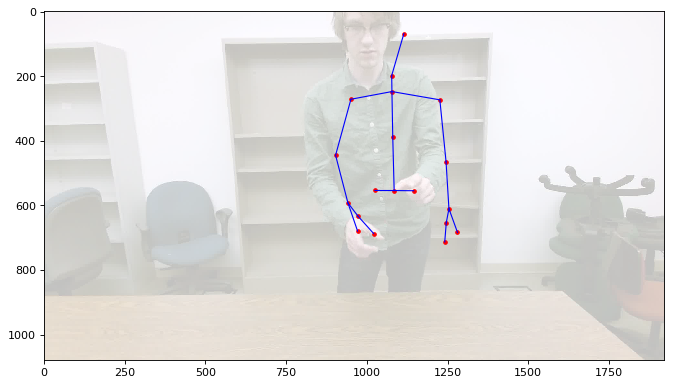

frame number (vfr) and rgb skeleton frame number 2071 2037
frame number (vfr) and rgb skeleton frame number 2072 2038
frame number (vfr) and rgb skeleton frame number 2073 2039
frame number (vfr) and rgb skeleton frame number 2074 2040
frame number (vfr) and rgb skeleton frame number 2075 2040
frame number (vfr) and rgb skeleton frame number 2076 2042
frame number (vfr) and rgb skeleton frame number 2077 2043
frame number (vfr) and rgb skeleton frame number 2078 2043
frame number (vfr) and rgb skeleton frame number 2079 2044
frame number (vfr) and rgb skeleton frame number 2080 2045
frame number (vfr) and rgb skeleton frame number 2081 2046
frame number (vfr) and rgb skeleton frame number 2082 2047
frame number (vfr) and rgb skeleton frame number 2083 2048
frame number (vfr) and rgb skeleton frame number 2084 2049
frame number (vfr) and rgb skeleton frame number 2085 2050
frame number (vfr) and rgb skeleton frame number 2086 2051
frame number (vfr) and rgb skeleton frame number 2087 20

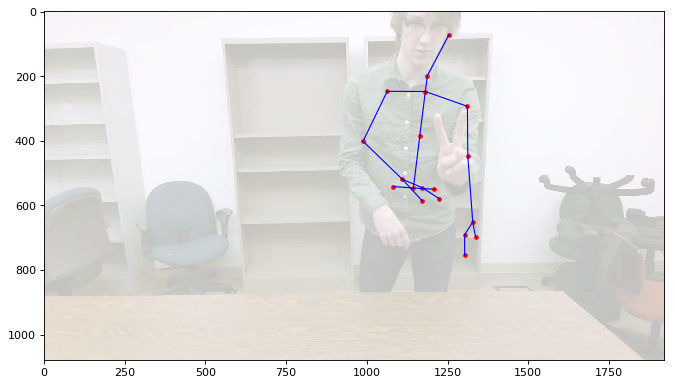

frame number (vfr) and rgb skeleton frame number 2101 2065
frame number (vfr) and rgb skeleton frame number 2102 2067
frame number (vfr) and rgb skeleton frame number 2103 2068
frame number (vfr) and rgb skeleton frame number 2104 2068
frame number (vfr) and rgb skeleton frame number 2105 2069
frame number (vfr) and rgb skeleton frame number 2106 2070
frame number (vfr) and rgb skeleton frame number 2107 2071
frame number (vfr) and rgb skeleton frame number 2108 2073
frame number (vfr) and rgb skeleton frame number 2109 2073
frame number (vfr) and rgb skeleton frame number 2110 2074
frame number (vfr) and rgb skeleton frame number 2111 2076
frame number (vfr) and rgb skeleton frame number 2112 2077
frame number (vfr) and rgb skeleton frame number 2113 2077
frame number (vfr) and rgb skeleton frame number 2114 2078
frame number (vfr) and rgb skeleton frame number 2115 2079
frame number (vfr) and rgb skeleton frame number 2116 2080
frame number (vfr) and rgb skeleton frame number 2117 20

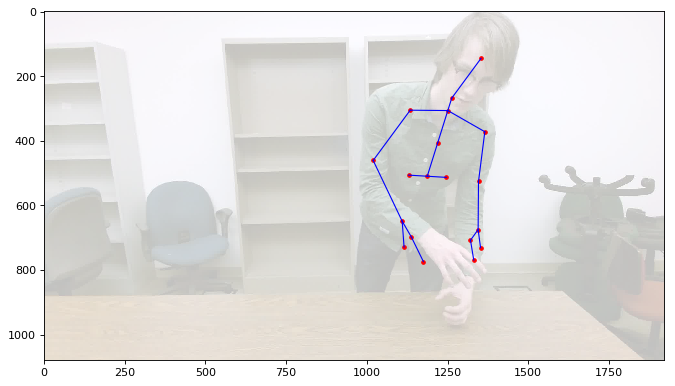

frame number (vfr) and rgb skeleton frame number 2131 2096
frame number (vfr) and rgb skeleton frame number 2132 2096
frame number (vfr) and rgb skeleton frame number 2133 2098
frame number (vfr) and rgb skeleton frame number 2134 2098
frame number (vfr) and rgb skeleton frame number 2135 2100
frame number (vfr) and rgb skeleton frame number 2136 2101
frame number (vfr) and rgb skeleton frame number 2137 2101
frame number (vfr) and rgb skeleton frame number 2138 2103
frame number (vfr) and rgb skeleton frame number 2139 2104
frame number (vfr) and rgb skeleton frame number 2140 2105
frame number (vfr) and rgb skeleton frame number 2141 2105
frame number (vfr) and rgb skeleton frame number 2142 2107
frame number (vfr) and rgb skeleton frame number 2143 2108
frame number (vfr) and rgb skeleton frame number 2144 2109
frame number (vfr) and rgb skeleton frame number 2145 2110
frame number (vfr) and rgb skeleton frame number 2146 2111
frame number (vfr) and rgb skeleton frame number 2147 21

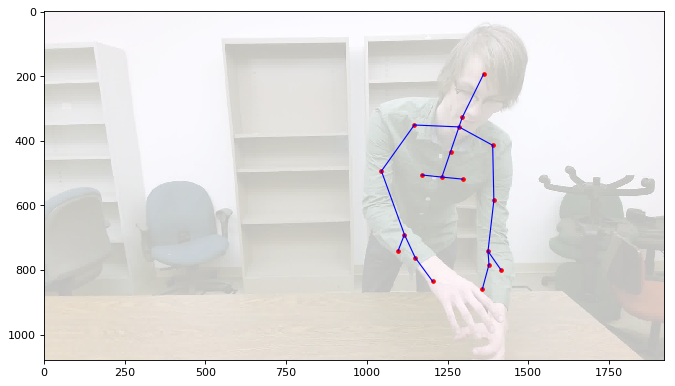

frame number (vfr) and rgb skeleton frame number 2161 2126
frame number (vfr) and rgb skeleton frame number 2162 2126
frame number (vfr) and rgb skeleton frame number 2163 2128
frame number (vfr) and rgb skeleton frame number 2164 2129
frame number (vfr) and rgb skeleton frame number 2165 2130
frame number (vfr) and rgb skeleton frame number 2166 2130
frame number (vfr) and rgb skeleton frame number 2167 2131
frame number (vfr) and rgb skeleton frame number 2168 2133
frame number (vfr) and rgb skeleton frame number 2169 2133
frame number (vfr) and rgb skeleton frame number 2170 2135
frame number (vfr) and rgb skeleton frame number 2171 2136
frame number (vfr) and rgb skeleton frame number 2172 2137
frame number (vfr) and rgb skeleton frame number 2173 2138
frame number (vfr) and rgb skeleton frame number 2174 2139
frame number (vfr) and rgb skeleton frame number 2175 2139
frame number (vfr) and rgb skeleton frame number 2176 2141
frame number (vfr) and rgb skeleton frame number 2177 21

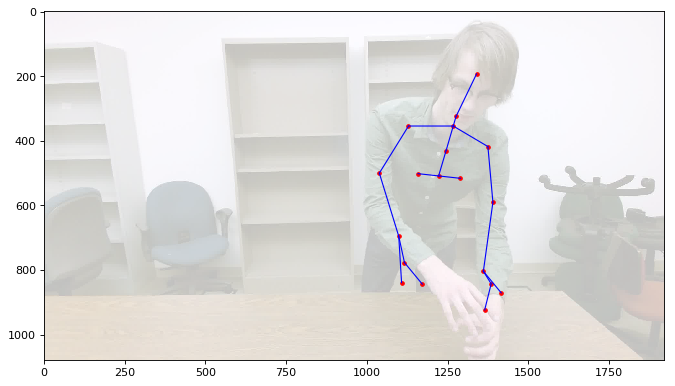

frame number (vfr) and rgb skeleton frame number 2191 2156
frame number (vfr) and rgb skeleton frame number 2192 2156
frame number (vfr) and rgb skeleton frame number 2193 2157
frame number (vfr) and rgb skeleton frame number 2194 2159
frame number (vfr) and rgb skeleton frame number 2195 2160
frame number (vfr) and rgb skeleton frame number 2196 2161
frame number (vfr) and rgb skeleton frame number 2197 2161
frame number (vfr) and rgb skeleton frame number 2198 2162
frame number (vfr) and rgb skeleton frame number 2199 2164
frame number (vfr) and rgb skeleton frame number 2200 2165
frame number (vfr) and rgb skeleton frame number 2201 2166
frame number (vfr) and rgb skeleton frame number 2202 2167
frame number (vfr) and rgb skeleton frame number 2203 2168
frame number (vfr) and rgb skeleton frame number 2204 2168
frame number (vfr) and rgb skeleton frame number 2205 2170
frame number (vfr) and rgb skeleton frame number 2206 2171
frame number (vfr) and rgb skeleton frame number 2207 21

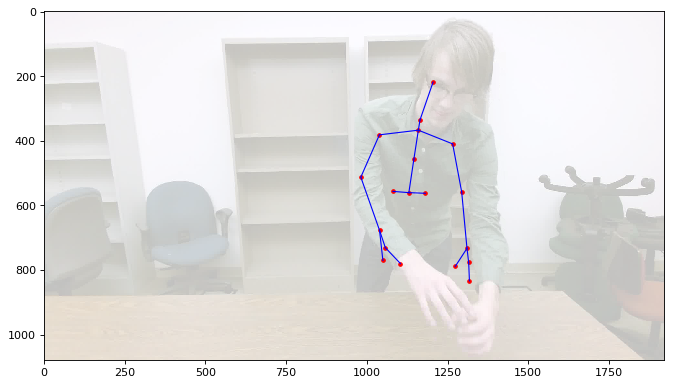

frame number (vfr) and rgb skeleton frame number 2221 2187
frame number (vfr) and rgb skeleton frame number 2222 2188
frame number (vfr) and rgb skeleton frame number 2223 2188
frame number (vfr) and rgb skeleton frame number 2224 2190
frame number (vfr) and rgb skeleton frame number 2225 2190
frame number (vfr) and rgb skeleton frame number 2226 2192
frame number (vfr) and rgb skeleton frame number 2227 2193
frame number (vfr) and rgb skeleton frame number 2228 2194
frame number (vfr) and rgb skeleton frame number 2229 2194
frame number (vfr) and rgb skeleton frame number 2230 2196
frame number (vfr) and rgb skeleton frame number 2231 2197
frame number (vfr) and rgb skeleton frame number 2232 2197
frame number (vfr) and rgb skeleton frame number 2233 2199
frame number (vfr) and rgb skeleton frame number 2234 2199
frame number (vfr) and rgb skeleton frame number 2235 2200
frame number (vfr) and rgb skeleton frame number 2236 2201
frame number (vfr) and rgb skeleton frame number 2237 22

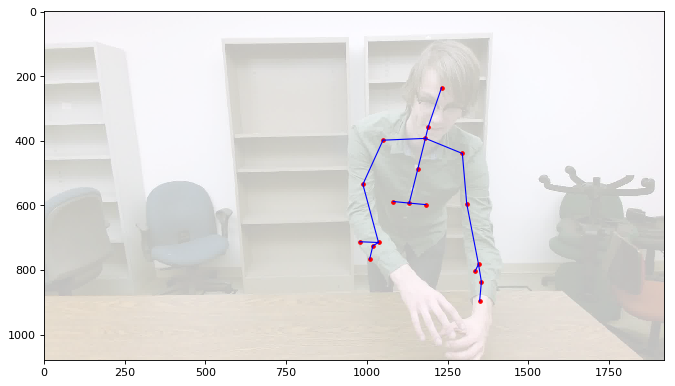

frame number (vfr) and rgb skeleton frame number 2251 2217
frame number (vfr) and rgb skeleton frame number 2252 2218
frame number (vfr) and rgb skeleton frame number 2253 2219
frame number (vfr) and rgb skeleton frame number 2254 2219
frame number (vfr) and rgb skeleton frame number 2255 2221
frame number (vfr) and rgb skeleton frame number 2256 2222
frame number (vfr) and rgb skeleton frame number 2257 2222
frame number (vfr) and rgb skeleton frame number 2258 2223
frame number (vfr) and rgb skeleton frame number 2259 2225
frame number (vfr) and rgb skeleton frame number 2260 2226
frame number (vfr) and rgb skeleton frame number 2261 2226
frame number (vfr) and rgb skeleton frame number 2262 2227
frame number (vfr) and rgb skeleton frame number 2263 2228
frame number (vfr) and rgb skeleton frame number 2264 2229
frame number (vfr) and rgb skeleton frame number 2265 2230
frame number (vfr) and rgb skeleton frame number 2266 2230
frame number (vfr) and rgb skeleton frame number 2267 22

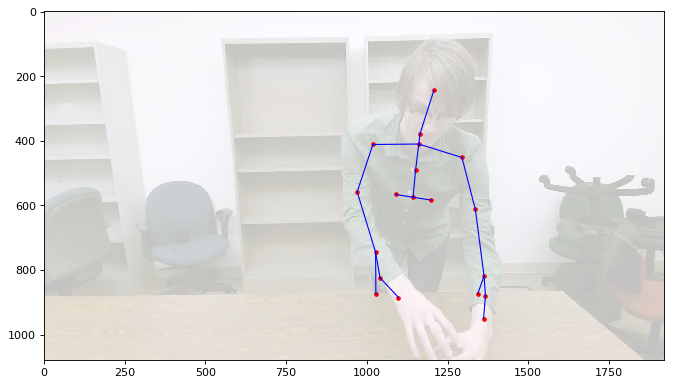

frame number (vfr) and rgb skeleton frame number 2281 2245
frame number (vfr) and rgb skeleton frame number 2282 2247
frame number (vfr) and rgb skeleton frame number 2283 2248
frame number (vfr) and rgb skeleton frame number 2284 2248
frame number (vfr) and rgb skeleton frame number 2285 2249
frame number (vfr) and rgb skeleton frame number 2286 2251
frame number (vfr) and rgb skeleton frame number 2287 2252
frame number (vfr) and rgb skeleton frame number 2288 2252
frame number (vfr) and rgb skeleton frame number 2289 2253
frame number (vfr) and rgb skeleton frame number 2290 2254
frame number (vfr) and rgb skeleton frame number 2291 2256
frame number (vfr) and rgb skeleton frame number 2292 2256
frame number (vfr) and rgb skeleton frame number 2293 2258
frame number (vfr) and rgb skeleton frame number 2294 2259
frame number (vfr) and rgb skeleton frame number 2295 2260
frame number (vfr) and rgb skeleton frame number 2296 2260
frame number (vfr) and rgb skeleton frame number 2297 22

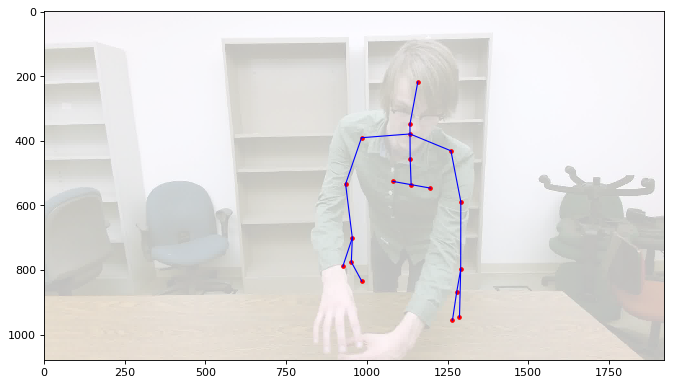

frame number (vfr) and rgb skeleton frame number 2311 2275
frame number (vfr) and rgb skeleton frame number 2312 2276
frame number (vfr) and rgb skeleton frame number 2313 2277
frame number (vfr) and rgb skeleton frame number 2314 2279
frame number (vfr) and rgb skeleton frame number 2315 2280
frame number (vfr) and rgb skeleton frame number 2316 2280
frame number (vfr) and rgb skeleton frame number 2317 2281
frame number (vfr) and rgb skeleton frame number 2318 2282
frame number (vfr) and rgb skeleton frame number 2319 2284
frame number (vfr) and rgb skeleton frame number 2320 2285
frame number (vfr) and rgb skeleton frame number 2321 2285
frame number (vfr) and rgb skeleton frame number 2322 2286
frame number (vfr) and rgb skeleton frame number 2323 2288
frame number (vfr) and rgb skeleton frame number 2324 2289
frame number (vfr) and rgb skeleton frame number 2325 2289
frame number (vfr) and rgb skeleton frame number 2326 2290
frame number (vfr) and rgb skeleton frame number 2327 22

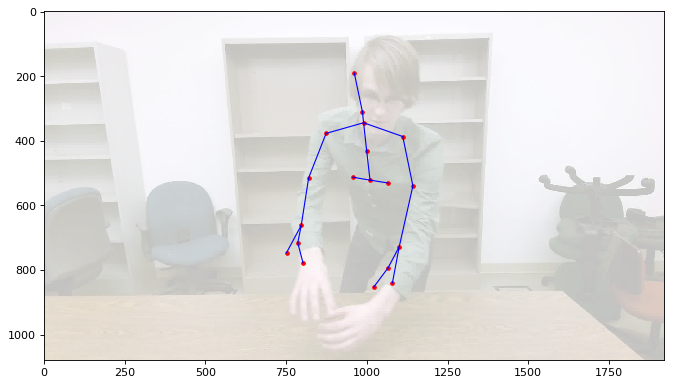

frame number (vfr) and rgb skeleton frame number 2341 2306
frame number (vfr) and rgb skeleton frame number 2342 2307
frame number (vfr) and rgb skeleton frame number 2343 2308
frame number (vfr) and rgb skeleton frame number 2344 2309
frame number (vfr) and rgb skeleton frame number 2345 2310
frame number (vfr) and rgb skeleton frame number 2346 2311
frame number (vfr) and rgb skeleton frame number 2347 2312
frame number (vfr) and rgb skeleton frame number 2348 2312
frame number (vfr) and rgb skeleton frame number 2349 2313
frame number (vfr) and rgb skeleton frame number 2350 2315
frame number (vfr) and rgb skeleton frame number 2351 2315
frame number (vfr) and rgb skeleton frame number 2352 2317
frame number (vfr) and rgb skeleton frame number 2353 2318
frame number (vfr) and rgb skeleton frame number 2354 2319
frame number (vfr) and rgb skeleton frame number 2355 2319
frame number (vfr) and rgb skeleton frame number 2356 2320
frame number (vfr) and rgb skeleton frame number 2357 23

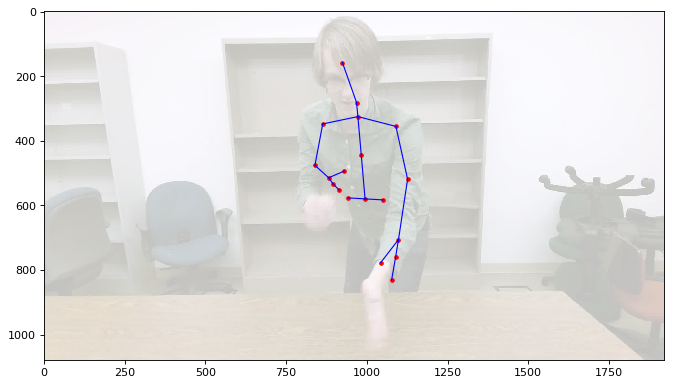

frame number (vfr) and rgb skeleton frame number 2371 2334
frame number (vfr) and rgb skeleton frame number 2372 2336
frame number (vfr) and rgb skeleton frame number 2373 2337
frame number (vfr) and rgb skeleton frame number 2374 2337
frame number (vfr) and rgb skeleton frame number 2375 2338
frame number (vfr) and rgb skeleton frame number 2376 2340
frame number (vfr) and rgb skeleton frame number 2377 2341
frame number (vfr) and rgb skeleton frame number 2378 2342
frame number (vfr) and rgb skeleton frame number 2379 2343
frame number (vfr) and rgb skeleton frame number 2380 2344
frame number (vfr) and rgb skeleton frame number 2381 2344
frame number (vfr) and rgb skeleton frame number 2382 2346
frame number (vfr) and rgb skeleton frame number 2383 2347
frame number (vfr) and rgb skeleton frame number 2384 2348
frame number (vfr) and rgb skeleton frame number 2385 2349
frame number (vfr) and rgb skeleton frame number 2386 2350
frame number (vfr) and rgb skeleton frame number 2387 23

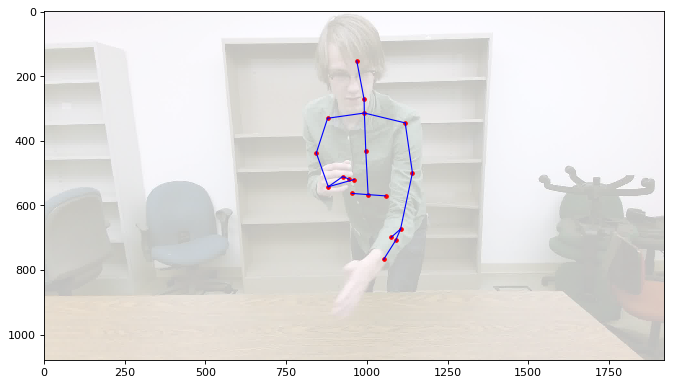

frame number (vfr) and rgb skeleton frame number 2401 2364
frame number (vfr) and rgb skeleton frame number 2402 2365
frame number (vfr) and rgb skeleton frame number 2403 2367
frame number (vfr) and rgb skeleton frame number 2404 2368
frame number (vfr) and rgb skeleton frame number 2405 2369
frame number (vfr) and rgb skeleton frame number 2406 2370
frame number (vfr) and rgb skeleton frame number 2407 2371
frame number (vfr) and rgb skeleton frame number 2408 2372
frame number (vfr) and rgb skeleton frame number 2409 2373
frame number (vfr) and rgb skeleton frame number 2410 2374
frame number (vfr) and rgb skeleton frame number 2411 2374
frame number (vfr) and rgb skeleton frame number 2412 2376
frame number (vfr) and rgb skeleton frame number 2413 2377
frame number (vfr) and rgb skeleton frame number 2414 2377
frame number (vfr) and rgb skeleton frame number 2415 2378
frame number (vfr) and rgb skeleton frame number 2416 2380
frame number (vfr) and rgb skeleton frame number 2417 23

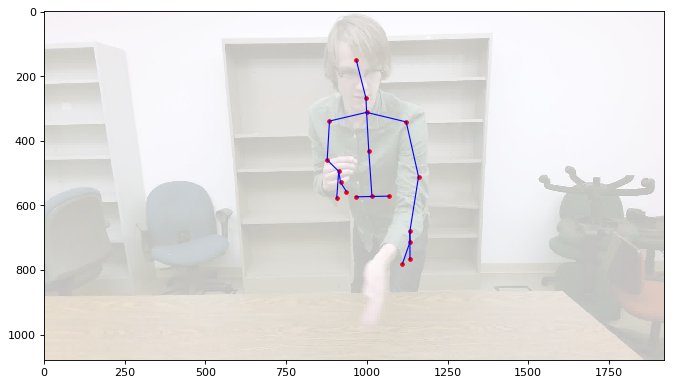

frame number (vfr) and rgb skeleton frame number 2431 2395
frame number (vfr) and rgb skeleton frame number 2432 2396
frame number (vfr) and rgb skeleton frame number 2433 2397
frame number (vfr) and rgb skeleton frame number 2434 2398
frame number (vfr) and rgb skeleton frame number 2435 2399
frame number (vfr) and rgb skeleton frame number 2436 2400
frame number (vfr) and rgb skeleton frame number 2437 2401
frame number (vfr) and rgb skeleton frame number 2438 2402
frame number (vfr) and rgb skeleton frame number 2439 2403
frame number (vfr) and rgb skeleton frame number 2440 2404
frame number (vfr) and rgb skeleton frame number 2441 2405
frame number (vfr) and rgb skeleton frame number 2442 2406
frame number (vfr) and rgb skeleton frame number 2443 2407
frame number (vfr) and rgb skeleton frame number 2444 2408
frame number (vfr) and rgb skeleton frame number 2445 2409
frame number (vfr) and rgb skeleton frame number 2446 2409
frame number (vfr) and rgb skeleton frame number 2447 24

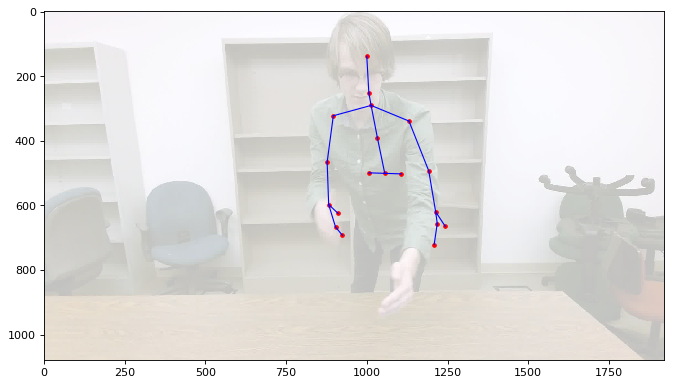

frame number (vfr) and rgb skeleton frame number 2461 2425
frame number (vfr) and rgb skeleton frame number 2462 2426
frame number (vfr) and rgb skeleton frame number 2463 2427
frame number (vfr) and rgb skeleton frame number 2464 2428
frame number (vfr) and rgb skeleton frame number 2465 2429
frame number (vfr) and rgb skeleton frame number 2466 2430
frame number (vfr) and rgb skeleton frame number 2467 2431
frame number (vfr) and rgb skeleton frame number 2468 2431
frame number (vfr) and rgb skeleton frame number 2469 2433
frame number (vfr) and rgb skeleton frame number 2470 2434
frame number (vfr) and rgb skeleton frame number 2471 2435
frame number (vfr) and rgb skeleton frame number 2472 2435
frame number (vfr) and rgb skeleton frame number 2473 2436
frame number (vfr) and rgb skeleton frame number 2474 2437
frame number (vfr) and rgb skeleton frame number 2475 2438
frame number (vfr) and rgb skeleton frame number 2476 2439
frame number (vfr) and rgb skeleton frame number 2477 24

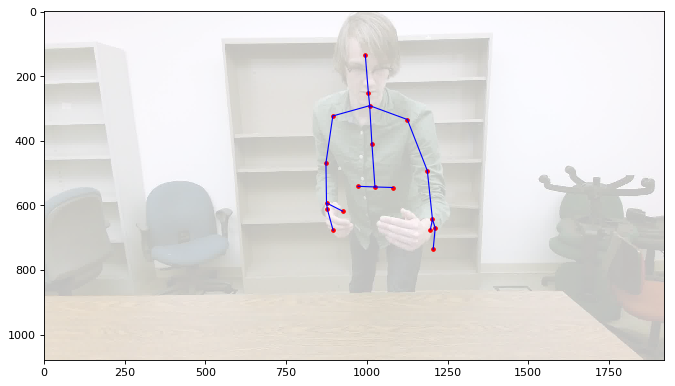

frame number (vfr) and rgb skeleton frame number 2491 2453
frame number (vfr) and rgb skeleton frame number 2492 2454
frame number (vfr) and rgb skeleton frame number 2493 2455
frame number (vfr) and rgb skeleton frame number 2494 2456
frame number (vfr) and rgb skeleton frame number 2495 2457
frame number (vfr) and rgb skeleton frame number 2496 2457
frame number (vfr) and rgb skeleton frame number 2497 2458
frame number (vfr) and rgb skeleton frame number 2498 2460
frame number (vfr) and rgb skeleton frame number 2499 2461
frame number (vfr) and rgb skeleton frame number 2500 2462
frame number (vfr) and rgb skeleton frame number 2501 2463
frame number (vfr) and rgb skeleton frame number 2502 2464
frame number (vfr) and rgb skeleton frame number 2503 2465
frame number (vfr) and rgb skeleton frame number 2504 2466
frame number (vfr) and rgb skeleton frame number 2505 2467
frame number (vfr) and rgb skeleton frame number 2506 2468
frame number (vfr) and rgb skeleton frame number 2507 24

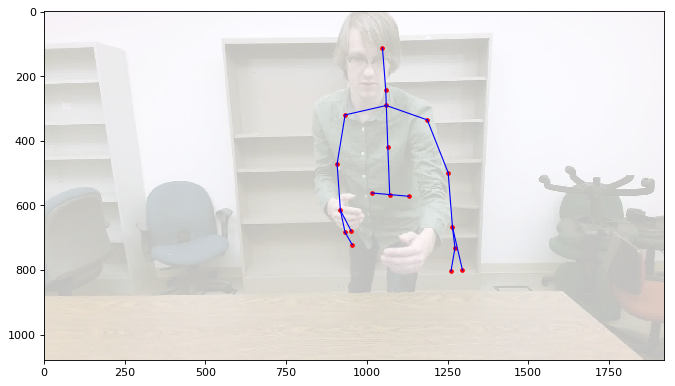

frame number (vfr) and rgb skeleton frame number 2521 2482
frame number (vfr) and rgb skeleton frame number 2522 2483
frame number (vfr) and rgb skeleton frame number 2523 2484
frame number (vfr) and rgb skeleton frame number 2524 2485
frame number (vfr) and rgb skeleton frame number 2525 2485
frame number (vfr) and rgb skeleton frame number 2526 2486
frame number (vfr) and rgb skeleton frame number 2527 2488
frame number (vfr) and rgb skeleton frame number 2528 2488
frame number (vfr) and rgb skeleton frame number 2529 2489
frame number (vfr) and rgb skeleton frame number 2530 2490
frame number (vfr) and rgb skeleton frame number 2531 2491
frame number (vfr) and rgb skeleton frame number 2532 2492
frame number (vfr) and rgb skeleton frame number 2533 2493
frame number (vfr) and rgb skeleton frame number 2534 2494
frame number (vfr) and rgb skeleton frame number 2535 2495
frame number (vfr) and rgb skeleton frame number 2536 2496
frame number (vfr) and rgb skeleton frame number 2537 24

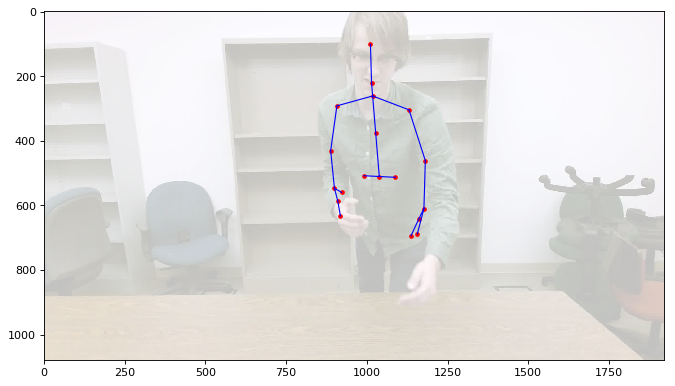

frame number (vfr) and rgb skeleton frame number 2551 2510
frame number (vfr) and rgb skeleton frame number 2552 2512
frame number (vfr) and rgb skeleton frame number 2553 2513
frame number (vfr) and rgb skeleton frame number 2554 2514
frame number (vfr) and rgb skeleton frame number 2555 2515
frame number (vfr) and rgb skeleton frame number 2556 2515
frame number (vfr) and rgb skeleton frame number 2557 2517
frame number (vfr) and rgb skeleton frame number 2558 2518
frame number (vfr) and rgb skeleton frame number 2559 2519
frame number (vfr) and rgb skeleton frame number 2560 2519
frame number (vfr) and rgb skeleton frame number 2561 2520
frame number (vfr) and rgb skeleton frame number 2562 2521
frame number (vfr) and rgb skeleton frame number 2563 2523
frame number (vfr) and rgb skeleton frame number 2564 2524
frame number (vfr) and rgb skeleton frame number 2565 2525
frame number (vfr) and rgb skeleton frame number 2566 2526
frame number (vfr) and rgb skeleton frame number 2567 25

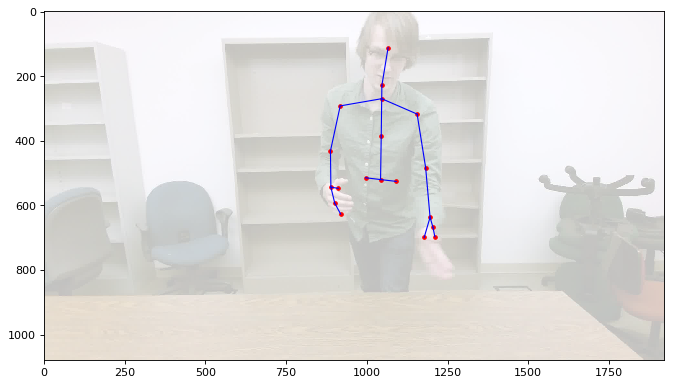

frame number (vfr) and rgb skeleton frame number 2581 2541
frame number (vfr) and rgb skeleton frame number 2582 2542
frame number (vfr) and rgb skeleton frame number 2583 2542
frame number (vfr) and rgb skeleton frame number 2584 2544
frame number (vfr) and rgb skeleton frame number 2585 2545
frame number (vfr) and rgb skeleton frame number 2586 2546
frame number (vfr) and rgb skeleton frame number 2587 2547
frame number (vfr) and rgb skeleton frame number 2588 2548
frame number (vfr) and rgb skeleton frame number 2589 2549
frame number (vfr) and rgb skeleton frame number 2590 2550
frame number (vfr) and rgb skeleton frame number 2591 2550
frame number (vfr) and rgb skeleton frame number 2592 2551
frame number (vfr) and rgb skeleton frame number 2593 2553
frame number (vfr) and rgb skeleton frame number 2594 2554
frame number (vfr) and rgb skeleton frame number 2595 2554
frame number (vfr) and rgb skeleton frame number 2596 2555
frame number (vfr) and rgb skeleton frame number 2597 25

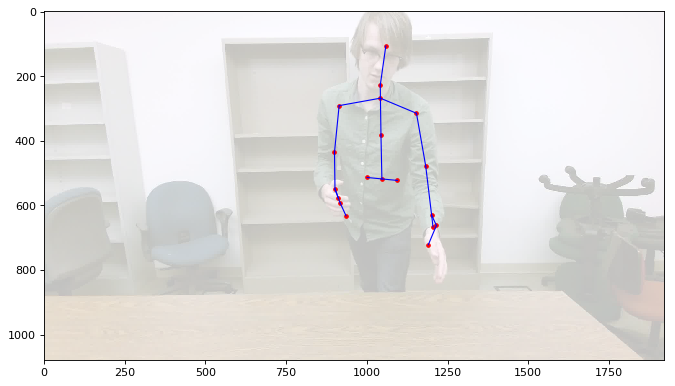

frame number (vfr) and rgb skeleton frame number 2611 2571
frame number (vfr) and rgb skeleton frame number 2612 2572
frame number (vfr) and rgb skeleton frame number 2613 2573
frame number (vfr) and rgb skeleton frame number 2614 2574
frame number (vfr) and rgb skeleton frame number 2615 2575
frame number (vfr) and rgb skeleton frame number 2616 2576
frame number (vfr) and rgb skeleton frame number 2617 2576
frame number (vfr) and rgb skeleton frame number 2618 2577
frame number (vfr) and rgb skeleton frame number 2619 2579
frame number (vfr) and rgb skeleton frame number 2620 2580
frame number (vfr) and rgb skeleton frame number 2621 2581
frame number (vfr) and rgb skeleton frame number 2622 2582
frame number (vfr) and rgb skeleton frame number 2623 2582
frame number (vfr) and rgb skeleton frame number 2624 2584
frame number (vfr) and rgb skeleton frame number 2625 2585
frame number (vfr) and rgb skeleton frame number 2626 2585
frame number (vfr) and rgb skeleton frame number 2627 25

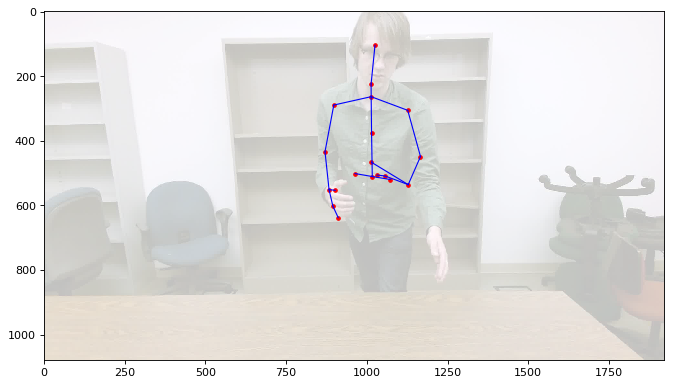

frame number (vfr) and rgb skeleton frame number 2641 2601
frame number (vfr) and rgb skeleton frame number 2642 2601
frame number (vfr) and rgb skeleton frame number 2643 2603
frame number (vfr) and rgb skeleton frame number 2644 2604
frame number (vfr) and rgb skeleton frame number 2645 2605
frame number (vfr) and rgb skeleton frame number 2646 2605
frame number (vfr) and rgb skeleton frame number 2647 2606
frame number (vfr) and rgb skeleton frame number 2648 2607
frame number (vfr) and rgb skeleton frame number 2649 2609
frame number (vfr) and rgb skeleton frame number 2650 2610
frame number (vfr) and rgb skeleton frame number 2651 2611
frame number (vfr) and rgb skeleton frame number 2652 2612
frame number (vfr) and rgb skeleton frame number 2653 2612
frame number (vfr) and rgb skeleton frame number 2654 2614
frame number (vfr) and rgb skeleton frame number 2655 2615
frame number (vfr) and rgb skeleton frame number 2656 2616
frame number (vfr) and rgb skeleton frame number 2657 26

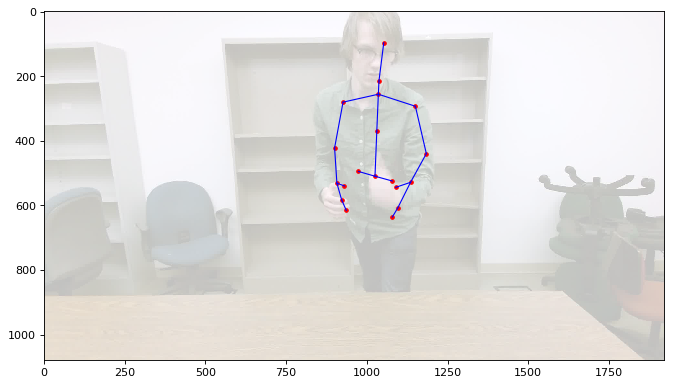

frame number (vfr) and rgb skeleton frame number 2671 2630
frame number (vfr) and rgb skeleton frame number 2672 2631
frame number (vfr) and rgb skeleton frame number 2673 2632
frame number (vfr) and rgb skeleton frame number 2674 2633
frame number (vfr) and rgb skeleton frame number 2675 2633
frame number (vfr) and rgb skeleton frame number 2676 2634
frame number (vfr) and rgb skeleton frame number 2677 2635
frame number (vfr) and rgb skeleton frame number 2678 2636
frame number (vfr) and rgb skeleton frame number 2679 2638
frame number (vfr) and rgb skeleton frame number 2680 2639
frame number (vfr) and rgb skeleton frame number 2681 2639
frame number (vfr) and rgb skeleton frame number 2682 2640
frame number (vfr) and rgb skeleton frame number 2683 2641
frame number (vfr) and rgb skeleton frame number 2684 2642
frame number (vfr) and rgb skeleton frame number 2685 2643
frame number (vfr) and rgb skeleton frame number 2686 2644
frame number (vfr) and rgb skeleton frame number 2687 26

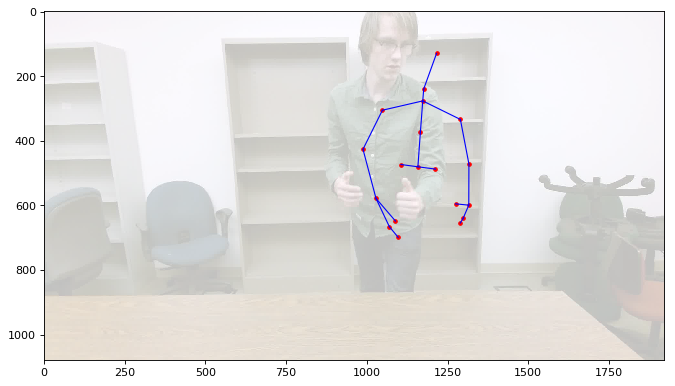

frame number (vfr) and rgb skeleton frame number 2701 2659
frame number (vfr) and rgb skeleton frame number 2702 2660
frame number (vfr) and rgb skeleton frame number 2703 2661
frame number (vfr) and rgb skeleton frame number 2704 2662
frame number (vfr) and rgb skeleton frame number 2705 2662
frame number (vfr) and rgb skeleton frame number 2706 2663
frame number (vfr) and rgb skeleton frame number 2707 2665
frame number (vfr) and rgb skeleton frame number 2708 2665
frame number (vfr) and rgb skeleton frame number 2709 2666
frame number (vfr) and rgb skeleton frame number 2710 2667
frame number (vfr) and rgb skeleton frame number 2711 2668
frame number (vfr) and rgb skeleton frame number 2712 2669
frame number (vfr) and rgb skeleton frame number 2713 2670
frame number (vfr) and rgb skeleton frame number 2714 2670
frame number (vfr) and rgb skeleton frame number 2715 2671
frame number (vfr) and rgb skeleton frame number 2716 2672
frame number (vfr) and rgb skeleton frame number 2717 26

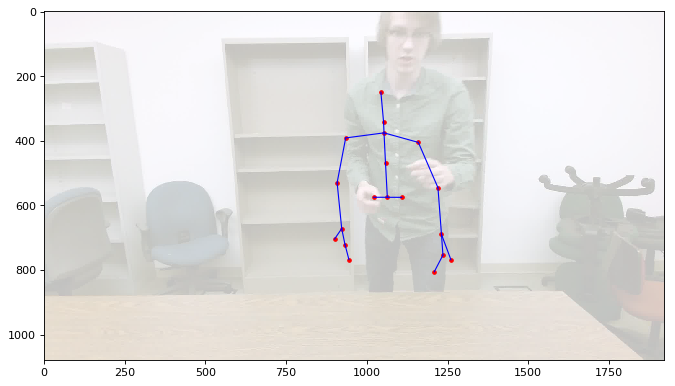

frame number (vfr) and rgb skeleton frame number 2731 2687
frame number (vfr) and rgb skeleton frame number 2732 2688
frame number (vfr) and rgb skeleton frame number 2733 2688
frame number (vfr) and rgb skeleton frame number 2734 2689
frame number (vfr) and rgb skeleton frame number 2735 2691
frame number (vfr) and rgb skeleton frame number 2736 2692
frame number (vfr) and rgb skeleton frame number 2737 2692
frame number (vfr) and rgb skeleton frame number 2738 2693
frame number (vfr) and rgb skeleton frame number 2739 2695
frame number (vfr) and rgb skeleton frame number 2740 2696
frame number (vfr) and rgb skeleton frame number 2741 2697
frame number (vfr) and rgb skeleton frame number 2742 2697
frame number (vfr) and rgb skeleton frame number 2743 2698
frame number (vfr) and rgb skeleton frame number 2744 2699
frame number (vfr) and rgb skeleton frame number 2745 2700
frame number (vfr) and rgb skeleton frame number 2746 2702
frame number (vfr) and rgb skeleton frame number 2747 27

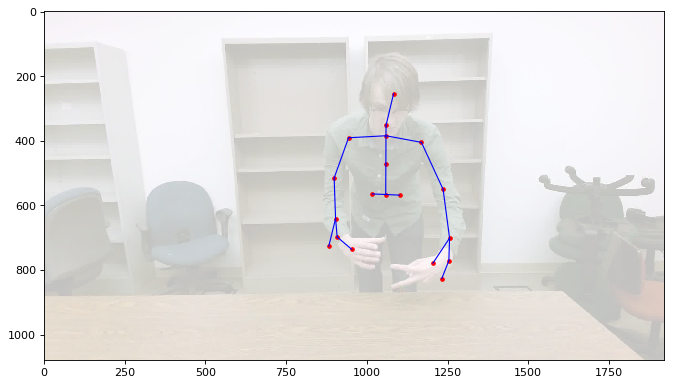

frame number (vfr) and rgb skeleton frame number 2761 2717
frame number (vfr) and rgb skeleton frame number 2762 2717
frame number (vfr) and rgb skeleton frame number 2763 2718
frame number (vfr) and rgb skeleton frame number 2764 2719
frame number (vfr) and rgb skeleton frame number 2765 2721
frame number (vfr) and rgb skeleton frame number 2766 2722
frame number (vfr) and rgb skeleton frame number 2767 2723
frame number (vfr) and rgb skeleton frame number 2768 2724
frame number (vfr) and rgb skeleton frame number 2769 2724
frame number (vfr) and rgb skeleton frame number 2770 2725
frame number (vfr) and rgb skeleton frame number 2771 2727
frame number (vfr) and rgb skeleton frame number 2772 2728
frame number (vfr) and rgb skeleton frame number 2773 2728
frame number (vfr) and rgb skeleton frame number 2774 2730
frame number (vfr) and rgb skeleton frame number 2775 2731
frame number (vfr) and rgb skeleton frame number 2776 2732
frame number (vfr) and rgb skeleton frame number 2777 27

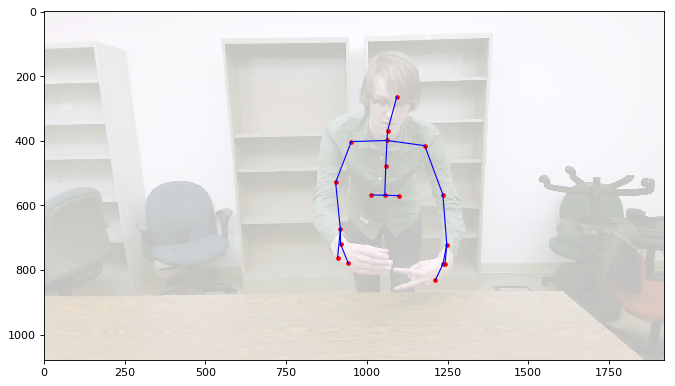

frame number (vfr) and rgb skeleton frame number 2791 2746
frame number (vfr) and rgb skeleton frame number 2792 2747
frame number (vfr) and rgb skeleton frame number 2793 2749
frame number (vfr) and rgb skeleton frame number 2794 2749
frame number (vfr) and rgb skeleton frame number 2795 2751
frame number (vfr) and rgb skeleton frame number 2796 2752
frame number (vfr) and rgb skeleton frame number 2797 2753
frame number (vfr) and rgb skeleton frame number 2798 2755
frame number (vfr) and rgb skeleton frame number 2799 2756
frame number (vfr) and rgb skeleton frame number 2800 2756
frame number (vfr) and rgb skeleton frame number 2801 2757
frame number (vfr) and rgb skeleton frame number 2802 2758
frame number (vfr) and rgb skeleton frame number 2803 2758
frame number (vfr) and rgb skeleton frame number 2804 2759
frame number (vfr) and rgb skeleton frame number 2805 2761
frame number (vfr) and rgb skeleton frame number 2806 2762
frame number (vfr) and rgb skeleton frame number 2807 27

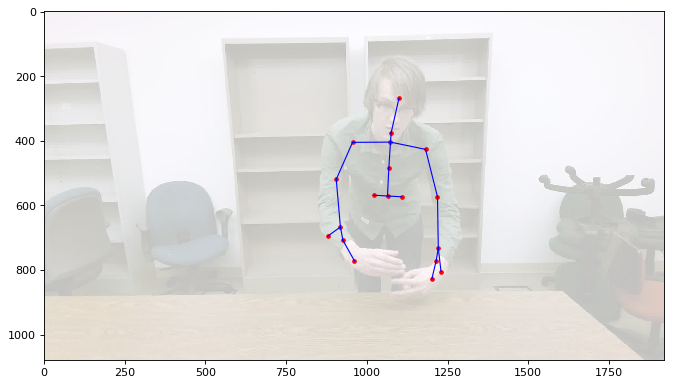

frame number (vfr) and rgb skeleton frame number 2821 2777
frame number (vfr) and rgb skeleton frame number 2822 2778
frame number (vfr) and rgb skeleton frame number 2823 2778
frame number (vfr) and rgb skeleton frame number 2824 2779
frame number (vfr) and rgb skeleton frame number 2825 2781
frame number (vfr) and rgb skeleton frame number 2826 2782
frame number (vfr) and rgb skeleton frame number 2827 2783
frame number (vfr) and rgb skeleton frame number 2828 2784
frame number (vfr) and rgb skeleton frame number 2829 2784
frame number (vfr) and rgb skeleton frame number 2830 2785
frame number (vfr) and rgb skeleton frame number 2831 2787
frame number (vfr) and rgb skeleton frame number 2832 2788
frame number (vfr) and rgb skeleton frame number 2833 2789
frame number (vfr) and rgb skeleton frame number 2834 2790
frame number (vfr) and rgb skeleton frame number 2835 2790
frame number (vfr) and rgb skeleton frame number 2836 2791
frame number (vfr) and rgb skeleton frame number 2837 27

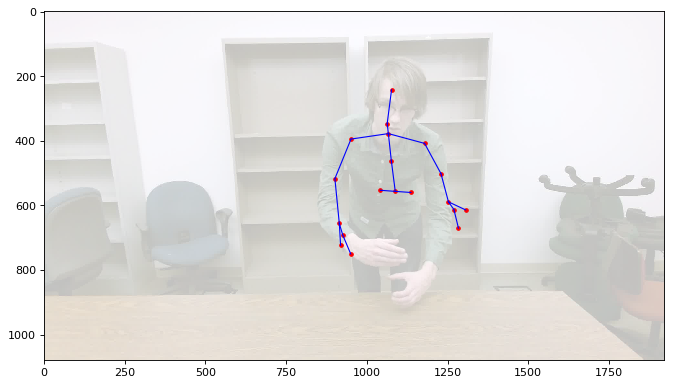

frame number (vfr) and rgb skeleton frame number 2851 2807
frame number (vfr) and rgb skeleton frame number 2852 2808
frame number (vfr) and rgb skeleton frame number 2853 2809
frame number (vfr) and rgb skeleton frame number 2854 2810
frame number (vfr) and rgb skeleton frame number 2855 2811
frame number (vfr) and rgb skeleton frame number 2856 2812
frame number (vfr) and rgb skeleton frame number 2857 2813
frame number (vfr) and rgb skeleton frame number 2858 2814
frame number (vfr) and rgb skeleton frame number 2859 2814
frame number (vfr) and rgb skeleton frame number 2860 2816
frame number (vfr) and rgb skeleton frame number 2861 2817
frame number (vfr) and rgb skeleton frame number 2862 2818
frame number (vfr) and rgb skeleton frame number 2863 2819
frame number (vfr) and rgb skeleton frame number 2864 2820
frame number (vfr) and rgb skeleton frame number 2865 2821
frame number (vfr) and rgb skeleton frame number 2866 2822
frame number (vfr) and rgb skeleton frame number 2867 28

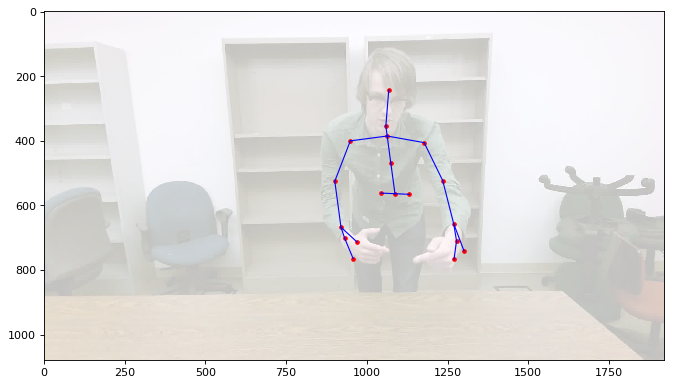

frame number (vfr) and rgb skeleton frame number 2881 2837
frame number (vfr) and rgb skeleton frame number 2882 2837
frame number (vfr) and rgb skeleton frame number 2883 2838
frame number (vfr) and rgb skeleton frame number 2884 2839
frame number (vfr) and rgb skeleton frame number 2885 2841
frame number (vfr) and rgb skeleton frame number 2886 2841
frame number (vfr) and rgb skeleton frame number 2887 2842
frame number (vfr) and rgb skeleton frame number 2888 2843
frame number (vfr) and rgb skeleton frame number 2889 2844
frame number (vfr) and rgb skeleton frame number 2890 2845
frame number (vfr) and rgb skeleton frame number 2891 2847
frame number (vfr) and rgb skeleton frame number 2892 2848
frame number (vfr) and rgb skeleton frame number 2893 2849
frame number (vfr) and rgb skeleton frame number 2894 2849
frame number (vfr) and rgb skeleton frame number 2895 2851
frame number (vfr) and rgb skeleton frame number 2896 2851
frame number (vfr) and rgb skeleton frame number 2897 28

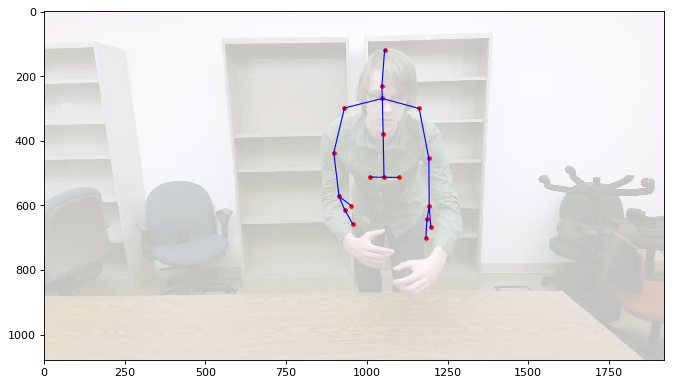

frame number (vfr) and rgb skeleton frame number 2911 2867
frame number (vfr) and rgb skeleton frame number 2912 2868
frame number (vfr) and rgb skeleton frame number 2913 2868
frame number (vfr) and rgb skeleton frame number 2914 2869
frame number (vfr) and rgb skeleton frame number 2915 2870
frame number (vfr) and rgb skeleton frame number 2916 2871
frame number (vfr) and rgb skeleton frame number 2917 2873
frame number (vfr) and rgb skeleton frame number 2918 2874
frame number (vfr) and rgb skeleton frame number 2919 2874
frame number (vfr) and rgb skeleton frame number 2920 2875
frame number (vfr) and rgb skeleton frame number 2921 2877
frame number (vfr) and rgb skeleton frame number 2922 2878
frame number (vfr) and rgb skeleton frame number 2923 2879
frame number (vfr) and rgb skeleton frame number 2924 2880
frame number (vfr) and rgb skeleton frame number 2925 2881
frame number (vfr) and rgb skeleton frame number 2926 2881
frame number (vfr) and rgb skeleton frame number 2927 28

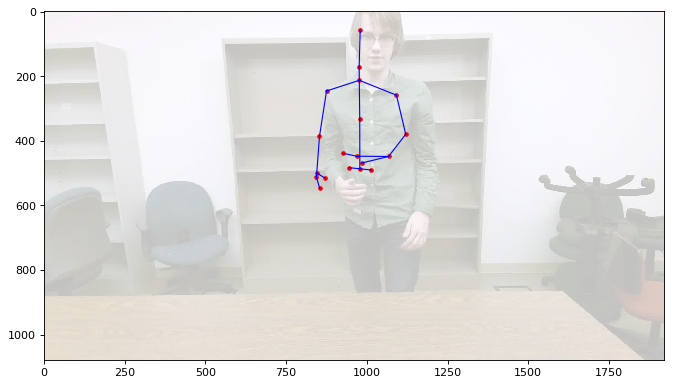

frame number (vfr) and rgb skeleton frame number 2941 2897
frame number (vfr) and rgb skeleton frame number 2942 2898
frame number (vfr) and rgb skeleton frame number 2943 2899
frame number (vfr) and rgb skeleton frame number 2944 2899
frame number (vfr) and rgb skeleton frame number 2945 2900
frame number (vfr) and rgb skeleton frame number 2946 2902
frame number (vfr) and rgb skeleton frame number 2947 2903
frame number (vfr) and rgb skeleton frame number 2948 2904
frame number (vfr) and rgb skeleton frame number 2949 2905
frame number (vfr) and rgb skeleton frame number 2950 2906
frame number (vfr) and rgb skeleton frame number 2951 2906
frame number (vfr) and rgb skeleton frame number 2952 2907
frame number (vfr) and rgb skeleton frame number 2953 2908
frame number (vfr) and rgb skeleton frame number 2954 2910
frame number (vfr) and rgb skeleton frame number 2955 2911
frame number (vfr) and rgb skeleton frame number 2956 2912
frame number (vfr) and rgb skeleton frame number 2957 29

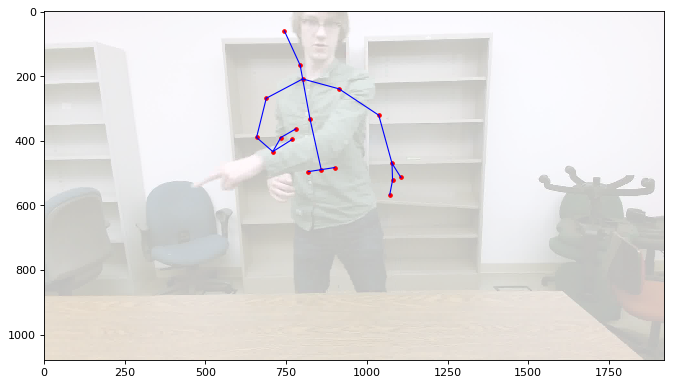

frame number (vfr) and rgb skeleton frame number 2971 2926
frame number (vfr) and rgb skeleton frame number 2972 2928
frame number (vfr) and rgb skeleton frame number 2973 2928
frame number (vfr) and rgb skeleton frame number 2974 2929
frame number (vfr) and rgb skeleton frame number 2975 2931
frame number (vfr) and rgb skeleton frame number 2976 2932
frame number (vfr) and rgb skeleton frame number 2977 2933
frame number (vfr) and rgb skeleton frame number 2978 2933
frame number (vfr) and rgb skeleton frame number 2979 2934
frame number (vfr) and rgb skeleton frame number 2980 2936
frame number (vfr) and rgb skeleton frame number 2981 2937
frame number (vfr) and rgb skeleton frame number 2982 2938
frame number (vfr) and rgb skeleton frame number 2983 2938
frame number (vfr) and rgb skeleton frame number 2984 2939
frame number (vfr) and rgb skeleton frame number 2985 2940
frame number (vfr) and rgb skeleton frame number 2986 2941
frame number (vfr) and rgb skeleton frame number 2987 29

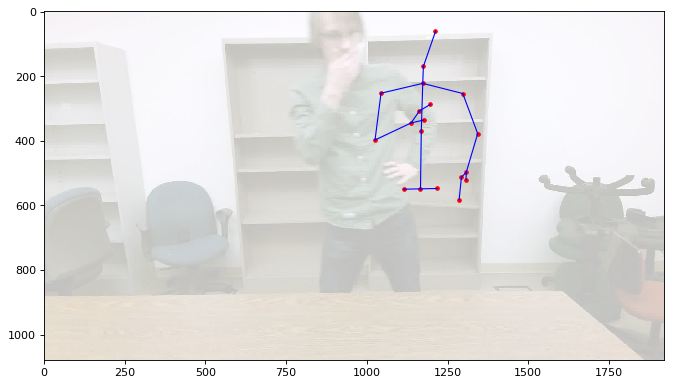

frame number (vfr) and rgb skeleton frame number 3001 2956
frame number (vfr) and rgb skeleton frame number 3002 2957
frame number (vfr) and rgb skeleton frame number 3003 2958
frame number (vfr) and rgb skeleton frame number 3004 2959
frame number (vfr) and rgb skeleton frame number 3005 2960
frame number (vfr) and rgb skeleton frame number 3006 2961
frame number (vfr) and rgb skeleton frame number 3007 2962
frame number (vfr) and rgb skeleton frame number 3008 2962
frame number (vfr) and rgb skeleton frame number 3009 2964
frame number (vfr) and rgb skeleton frame number 3010 2965
frame number (vfr) and rgb skeleton frame number 3011 2966
frame number (vfr) and rgb skeleton frame number 3012 2967
frame number (vfr) and rgb skeleton frame number 3013 2968
frame number (vfr) and rgb skeleton frame number 3014 2968
frame number (vfr) and rgb skeleton frame number 3015 2969
frame number (vfr) and rgb skeleton frame number 3016 2971
frame number (vfr) and rgb skeleton frame number 3017 29

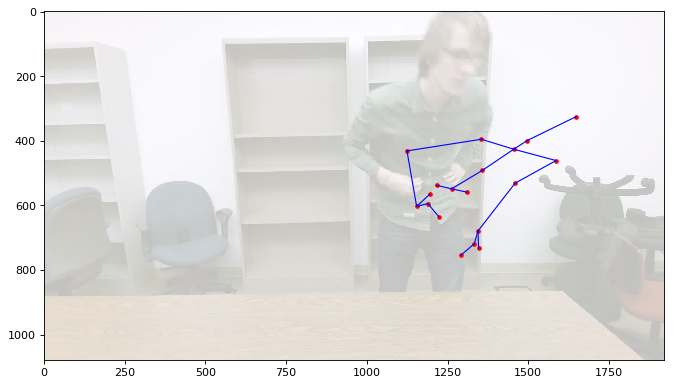

frame number (vfr) and rgb skeleton frame number 3031 2986
frame number (vfr) and rgb skeleton frame number 3032 2987
frame number (vfr) and rgb skeleton frame number 3033 2988
frame number (vfr) and rgb skeleton frame number 3034 2988
frame number (vfr) and rgb skeleton frame number 3035 2989
frame number (vfr) and rgb skeleton frame number 3036 2991
frame number (vfr) and rgb skeleton frame number 3037 2992
frame number (vfr) and rgb skeleton frame number 3038 2992
frame number (vfr) and rgb skeleton frame number 3039 2994
frame number (vfr) and rgb skeleton frame number 3040 2995
frame number (vfr) and rgb skeleton frame number 3041 2996
frame number (vfr) and rgb skeleton frame number 3042 2996
frame number (vfr) and rgb skeleton frame number 3043 2997
frame number (vfr) and rgb skeleton frame number 3044 2999
frame number (vfr) and rgb skeleton frame number 3045 3000
frame number (vfr) and rgb skeleton frame number 3046 3001
frame number (vfr) and rgb skeleton frame number 3047 30

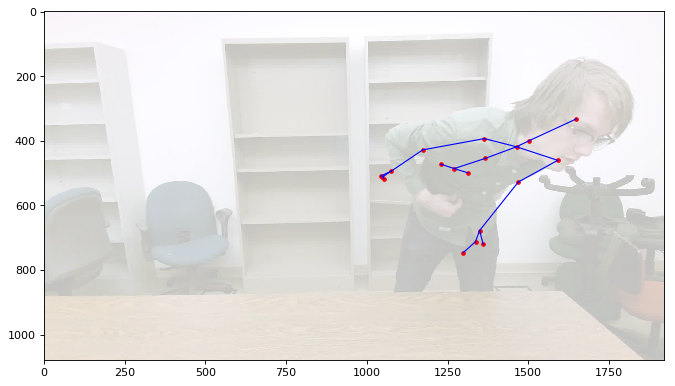

frame number (vfr) and rgb skeleton frame number 3061 3016
frame number (vfr) and rgb skeleton frame number 3062 3017
frame number (vfr) and rgb skeleton frame number 3063 3018
frame number (vfr) and rgb skeleton frame number 3064 3019
frame number (vfr) and rgb skeleton frame number 3065 3020
frame number (vfr) and rgb skeleton frame number 3066 3021
frame number (vfr) and rgb skeleton frame number 3067 3021
frame number (vfr) and rgb skeleton frame number 3068 3022
frame number (vfr) and rgb skeleton frame number 3069 3024
frame number (vfr) and rgb skeleton frame number 3070 3025
frame number (vfr) and rgb skeleton frame number 3071 3026
frame number (vfr) and rgb skeleton frame number 3072 3026
frame number (vfr) and rgb skeleton frame number 3073 3027
frame number (vfr) and rgb skeleton frame number 3074 3029
frame number (vfr) and rgb skeleton frame number 3075 3030
frame number (vfr) and rgb skeleton frame number 3076 3031
frame number (vfr) and rgb skeleton frame number 3077 30

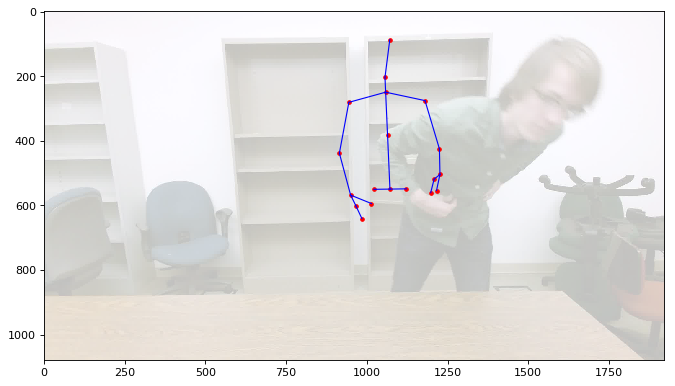

frame number (vfr) and rgb skeleton frame number 3091 3046
frame number (vfr) and rgb skeleton frame number 3092 3047
frame number (vfr) and rgb skeleton frame number 3093 3047
frame number (vfr) and rgb skeleton frame number 3094 3048
frame number (vfr) and rgb skeleton frame number 3095 3050
frame number (vfr) and rgb skeleton frame number 3096 3051
frame number (vfr) and rgb skeleton frame number 3097 3052
frame number (vfr) and rgb skeleton frame number 3098 3052
frame number (vfr) and rgb skeleton frame number 3099 3053
frame number (vfr) and rgb skeleton frame number 3100 3054
frame number (vfr) and rgb skeleton frame number 3101 3055
frame number (vfr) and rgb skeleton frame number 3102 3056
frame number (vfr) and rgb skeleton frame number 3103 3057
frame number (vfr) and rgb skeleton frame number 3104 3059
frame number (vfr) and rgb skeleton frame number 3105 3059
frame number (vfr) and rgb skeleton frame number 3106 3061
frame number (vfr) and rgb skeleton frame number 3107 30

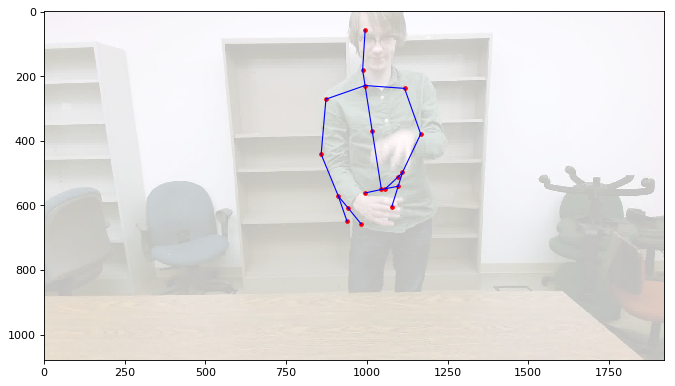

frame number (vfr) and rgb skeleton frame number 3121 3076
frame number (vfr) and rgb skeleton frame number 3122 3076
frame number (vfr) and rgb skeleton frame number 3123 3077
frame number (vfr) and rgb skeleton frame number 3124 3078
frame number (vfr) and rgb skeleton frame number 3125 3079
frame number (vfr) and rgb skeleton frame number 3126 3080
frame number (vfr) and rgb skeleton frame number 3127 3081
frame number (vfr) and rgb skeleton frame number 3128 3082
frame number (vfr) and rgb skeleton frame number 3129 3083
frame number (vfr) and rgb skeleton frame number 3130 3084
frame number (vfr) and rgb skeleton frame number 3131 3085
frame number (vfr) and rgb skeleton frame number 3132 3086
frame number (vfr) and rgb skeleton frame number 3133 3086
frame number (vfr) and rgb skeleton frame number 3134 3088
frame number (vfr) and rgb skeleton frame number 3135 3089
frame number (vfr) and rgb skeleton frame number 3136 3090
frame number (vfr) and rgb skeleton frame number 3137 30

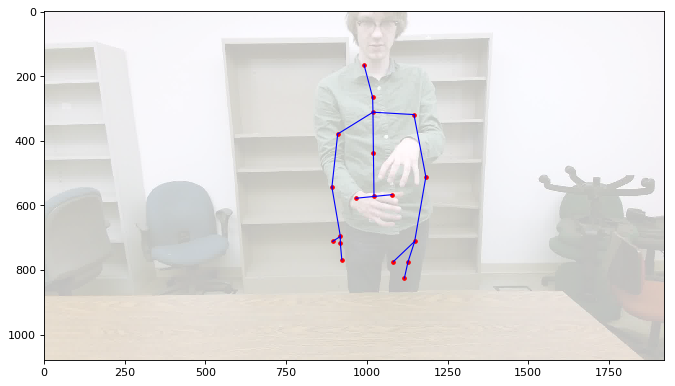

frame number (vfr) and rgb skeleton frame number 3151 3104
frame number (vfr) and rgb skeleton frame number 3152 3104
frame number (vfr) and rgb skeleton frame number 3153 3105
frame number (vfr) and rgb skeleton frame number 3154 3106
frame number (vfr) and rgb skeleton frame number 3155 3107
frame number (vfr) and rgb skeleton frame number 3156 3108
frame number (vfr) and rgb skeleton frame number 3157 3109
frame number (vfr) and rgb skeleton frame number 3158 3110
frame number (vfr) and rgb skeleton frame number 3159 3110
frame number (vfr) and rgb skeleton frame number 3160 3111
frame number (vfr) and rgb skeleton frame number 3161 3113
frame number (vfr) and rgb skeleton frame number 3162 3114
frame number (vfr) and rgb skeleton frame number 3163 3115
frame number (vfr) and rgb skeleton frame number 3164 3115
frame number (vfr) and rgb skeleton frame number 3165 3116
frame number (vfr) and rgb skeleton frame number 3166 3117
frame number (vfr) and rgb skeleton frame number 3167 31

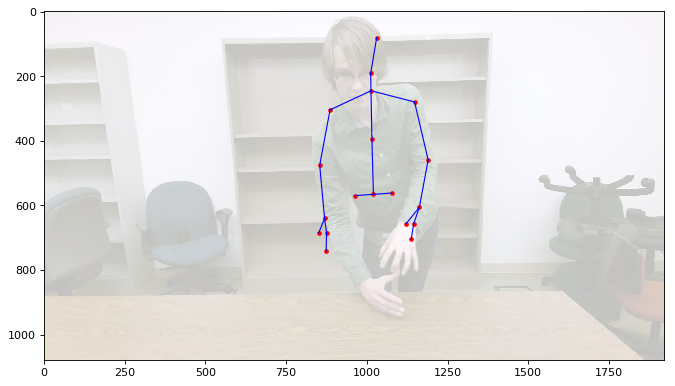

frame number (vfr) and rgb skeleton frame number 3181 3133
frame number (vfr) and rgb skeleton frame number 3182 3134
frame number (vfr) and rgb skeleton frame number 3183 3135
frame number (vfr) and rgb skeleton frame number 3184 3135
frame number (vfr) and rgb skeleton frame number 3185 3137
frame number (vfr) and rgb skeleton frame number 3186 3138
frame number (vfr) and rgb skeleton frame number 3187 3139
frame number (vfr) and rgb skeleton frame number 3188 3139
frame number (vfr) and rgb skeleton frame number 3189 3140
frame number (vfr) and rgb skeleton frame number 3190 3142
frame number (vfr) and rgb skeleton frame number 3191 3143
frame number (vfr) and rgb skeleton frame number 3192 3143
frame number (vfr) and rgb skeleton frame number 3193 3144
frame number (vfr) and rgb skeleton frame number 3194 3145
frame number (vfr) and rgb skeleton frame number 3195 3147
frame number (vfr) and rgb skeleton frame number 3196 3148
frame number (vfr) and rgb skeleton frame number 3197 31

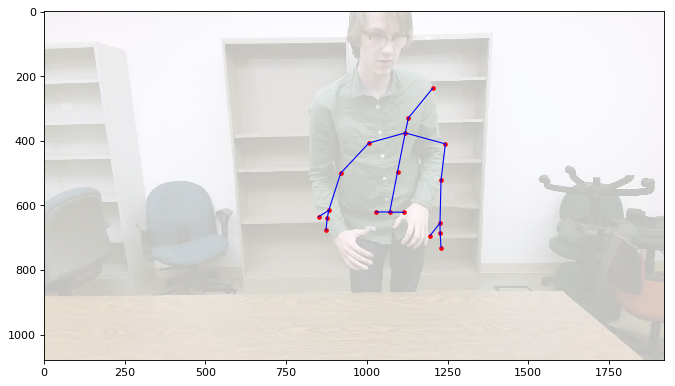

frame number (vfr) and rgb skeleton frame number 3211 3163
frame number (vfr) and rgb skeleton frame number 3212 3164
frame number (vfr) and rgb skeleton frame number 3213 3165
frame number (vfr) and rgb skeleton frame number 3214 3166
frame number (vfr) and rgb skeleton frame number 3215 3167
frame number (vfr) and rgb skeleton frame number 3216 3168
frame number (vfr) and rgb skeleton frame number 3217 3169
frame number (vfr) and rgb skeleton frame number 3218 3170
frame number (vfr) and rgb skeleton frame number 3219 3171
frame number (vfr) and rgb skeleton frame number 3220 3172
frame number (vfr) and rgb skeleton frame number 3221 3173
frame number (vfr) and rgb skeleton frame number 3222 3174
frame number (vfr) and rgb skeleton frame number 3223 3175
frame number (vfr) and rgb skeleton frame number 3224 3176
frame number (vfr) and rgb skeleton frame number 3225 3177
frame number (vfr) and rgb skeleton frame number 3226 3178
frame number (vfr) and rgb skeleton frame number 3227 31

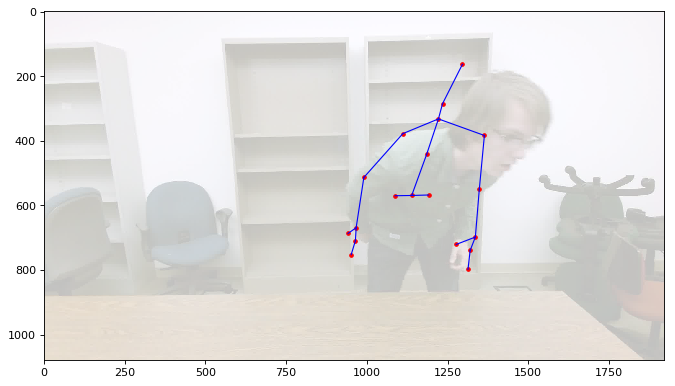

frame number (vfr) and rgb skeleton frame number 3241 3192
frame number (vfr) and rgb skeleton frame number 3242 3194
frame number (vfr) and rgb skeleton frame number 3243 3195
frame number (vfr) and rgb skeleton frame number 3244 3195
frame number (vfr) and rgb skeleton frame number 3245 3197
frame number (vfr) and rgb skeleton frame number 3246 3198
frame number (vfr) and rgb skeleton frame number 3247 3199
frame number (vfr) and rgb skeleton frame number 3248 3200
frame number (vfr) and rgb skeleton frame number 3249 3201
frame number (vfr) and rgb skeleton frame number 3250 3202
frame number (vfr) and rgb skeleton frame number 3251 3203
frame number (vfr) and rgb skeleton frame number 3252 3203
frame number (vfr) and rgb skeleton frame number 3253 3204
frame number (vfr) and rgb skeleton frame number 3254 3206
frame number (vfr) and rgb skeleton frame number 3255 3207
frame number (vfr) and rgb skeleton frame number 3256 3208
frame number (vfr) and rgb skeleton frame number 3257 32

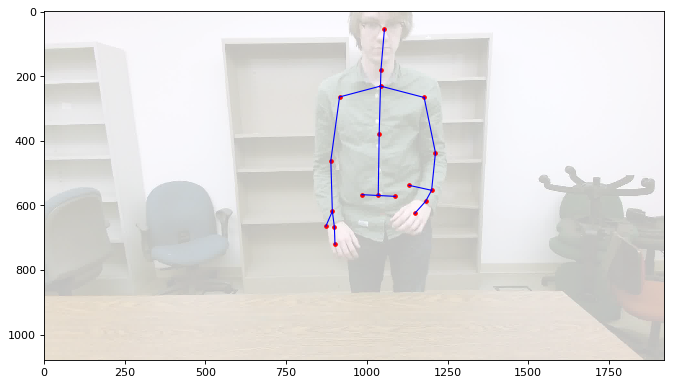

frame number (vfr) and rgb skeleton frame number 3271 3222
frame number (vfr) and rgb skeleton frame number 3272 3223
frame number (vfr) and rgb skeleton frame number 3273 3224
frame number (vfr) and rgb skeleton frame number 3274 3225
frame number (vfr) and rgb skeleton frame number 3275 3226
frame number (vfr) and rgb skeleton frame number 3276 3227
frame number (vfr) and rgb skeleton frame number 3277 3228
frame number (vfr) and rgb skeleton frame number 3278 3228
frame number (vfr) and rgb skeleton frame number 3279 3230
frame number (vfr) and rgb skeleton frame number 3280 3230
frame number (vfr) and rgb skeleton frame number 3281 3232
frame number (vfr) and rgb skeleton frame number 3282 3233
frame number (vfr) and rgb skeleton frame number 3283 3233
frame number (vfr) and rgb skeleton frame number 3284 3235
frame number (vfr) and rgb skeleton frame number 3285 3235
frame number (vfr) and rgb skeleton frame number 3286 3236
frame number (vfr) and rgb skeleton frame number 3287 32

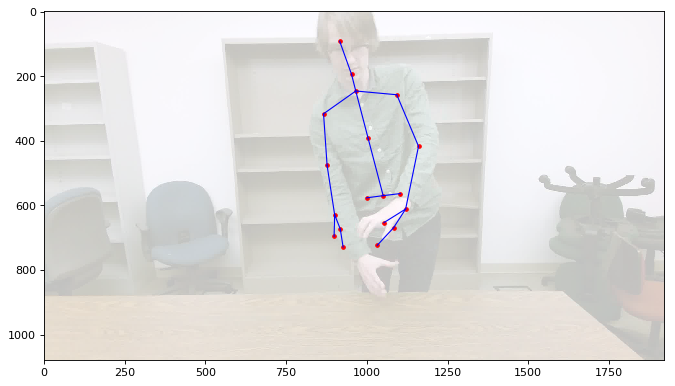

frame number (vfr) and rgb skeleton frame number 3301 3252
frame number (vfr) and rgb skeleton frame number 3302 3253
frame number (vfr) and rgb skeleton frame number 3303 3254
frame number (vfr) and rgb skeleton frame number 3304 3254
frame number (vfr) and rgb skeleton frame number 3305 3255
frame number (vfr) and rgb skeleton frame number 3306 3257
frame number (vfr) and rgb skeleton frame number 3307 3257
frame number (vfr) and rgb skeleton frame number 3308 3258
frame number (vfr) and rgb skeleton frame number 3309 3260
frame number (vfr) and rgb skeleton frame number 3310 3261
frame number (vfr) and rgb skeleton frame number 3311 3262
frame number (vfr) and rgb skeleton frame number 3312 3262
frame number (vfr) and rgb skeleton frame number 3313 3263
frame number (vfr) and rgb skeleton frame number 3314 3265
frame number (vfr) and rgb skeleton frame number 3315 3266
frame number (vfr) and rgb skeleton frame number 3316 3267
frame number (vfr) and rgb skeleton frame number 3317 32

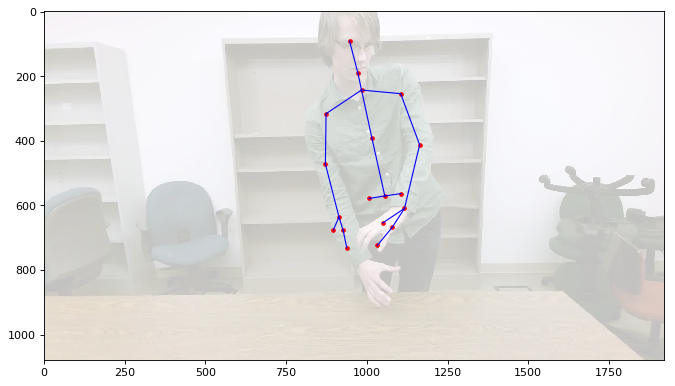

frame number (vfr) and rgb skeleton frame number 3331 3282
frame number (vfr) and rgb skeleton frame number 3332 3282
frame number (vfr) and rgb skeleton frame number 3333 3283
frame number (vfr) and rgb skeleton frame number 3334 3284
frame number (vfr) and rgb skeleton frame number 3335 3286
frame number (vfr) and rgb skeleton frame number 3336 3287
frame number (vfr) and rgb skeleton frame number 3337 3288
frame number (vfr) and rgb skeleton frame number 3338 3288
frame number (vfr) and rgb skeleton frame number 3339 3290
frame number (vfr) and rgb skeleton frame number 3340 3291
frame number (vfr) and rgb skeleton frame number 3341 3292
frame number (vfr) and rgb skeleton frame number 3342 3293
frame number (vfr) and rgb skeleton frame number 3343 3293
frame number (vfr) and rgb skeleton frame number 3344 3295
frame number (vfr) and rgb skeleton frame number 3345 3296
frame number (vfr) and rgb skeleton frame number 3346 3297
frame number (vfr) and rgb skeleton frame number 3347 32

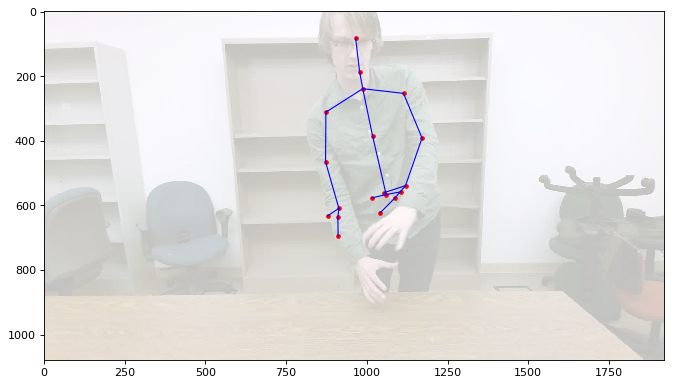

frame number (vfr) and rgb skeleton frame number 3361 3311
frame number (vfr) and rgb skeleton frame number 3362 3312
frame number (vfr) and rgb skeleton frame number 3363 3313
frame number (vfr) and rgb skeleton frame number 3364 3314
frame number (vfr) and rgb skeleton frame number 3365 3315
frame number (vfr) and rgb skeleton frame number 3366 3316
frame number (vfr) and rgb skeleton frame number 3367 3317
frame number (vfr) and rgb skeleton frame number 3368 3318
frame number (vfr) and rgb skeleton frame number 3369 3319
frame number (vfr) and rgb skeleton frame number 3370 3320
frame number (vfr) and rgb skeleton frame number 3371 3321
frame number (vfr) and rgb skeleton frame number 3372 3322
frame number (vfr) and rgb skeleton frame number 3373 3323
frame number (vfr) and rgb skeleton frame number 3374 3324
frame number (vfr) and rgb skeleton frame number 3375 3325
frame number (vfr) and rgb skeleton frame number 3376 3326
frame number (vfr) and rgb skeleton frame number 3377 33

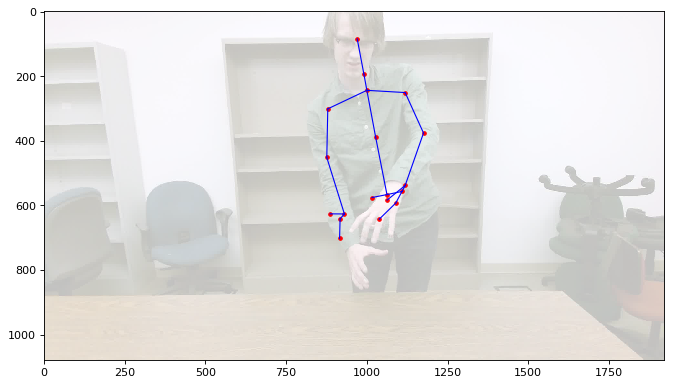

frame number (vfr) and rgb skeleton frame number 3391 3341
frame number (vfr) and rgb skeleton frame number 3392 3342
frame number (vfr) and rgb skeleton frame number 3393 3343
frame number (vfr) and rgb skeleton frame number 3394 3343
frame number (vfr) and rgb skeleton frame number 3395 3344
frame number (vfr) and rgb skeleton frame number 3396 3345
frame number (vfr) and rgb skeleton frame number 3397 3347
frame number (vfr) and rgb skeleton frame number 3398 3348
frame number (vfr) and rgb skeleton frame number 3399 3348
frame number (vfr) and rgb skeleton frame number 3400 3350
frame number (vfr) and rgb skeleton frame number 3401 3351
frame number (vfr) and rgb skeleton frame number 3402 3352
frame number (vfr) and rgb skeleton frame number 3403 3353
frame number (vfr) and rgb skeleton frame number 3404 3353
frame number (vfr) and rgb skeleton frame number 3405 3355
frame number (vfr) and rgb skeleton frame number 3406 3356
frame number (vfr) and rgb skeleton frame number 3407 33

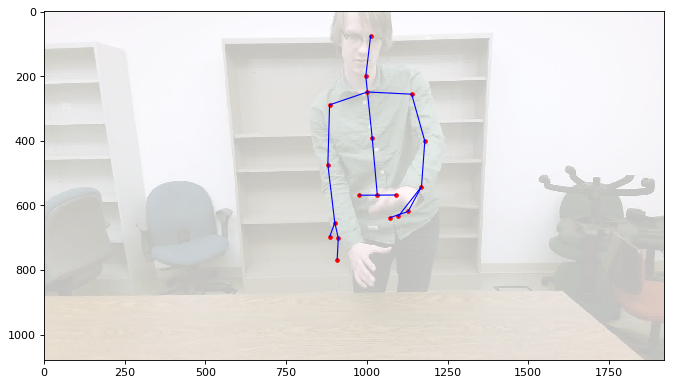

frame number (vfr) and rgb skeleton frame number 3421 3371
frame number (vfr) and rgb skeleton frame number 3422 3372
frame number (vfr) and rgb skeleton frame number 3423 3373
frame number (vfr) and rgb skeleton frame number 3424 3374
frame number (vfr) and rgb skeleton frame number 3425 3375
frame number (vfr) and rgb skeleton frame number 3426 3375
frame number (vfr) and rgb skeleton frame number 3427 3376
frame number (vfr) and rgb skeleton frame number 3428 3377
frame number (vfr) and rgb skeleton frame number 3429 3379
frame number (vfr) and rgb skeleton frame number 3430 3380
frame number (vfr) and rgb skeleton frame number 3431 3381
frame number (vfr) and rgb skeleton frame number 3432 3382
frame number (vfr) and rgb skeleton frame number 3433 3383
frame number (vfr) and rgb skeleton frame number 3434 3383
frame number (vfr) and rgb skeleton frame number 3435 3384
frame number (vfr) and rgb skeleton frame number 3436 3386
frame number (vfr) and rgb skeleton frame number 3437 33

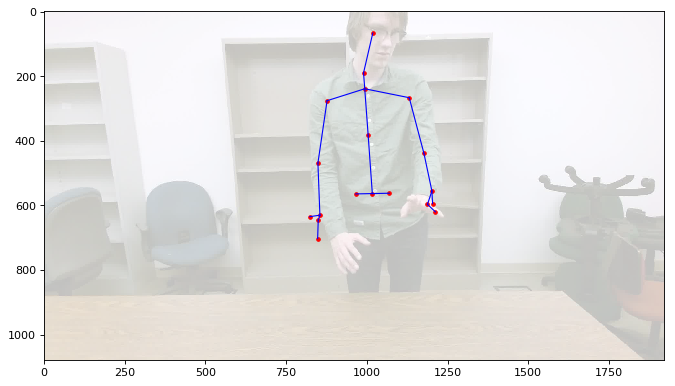

frame number (vfr) and rgb skeleton frame number 3451 3400
frame number (vfr) and rgb skeleton frame number 3452 3401
frame number (vfr) and rgb skeleton frame number 3453 3402
frame number (vfr) and rgb skeleton frame number 3454 3403
frame number (vfr) and rgb skeleton frame number 3455 3403
frame number (vfr) and rgb skeleton frame number 3456 3405
frame number (vfr) and rgb skeleton frame number 3457 3405
frame number (vfr) and rgb skeleton frame number 3458 3406
frame number (vfr) and rgb skeleton frame number 3459 3408
frame number (vfr) and rgb skeleton frame number 3460 3409
frame number (vfr) and rgb skeleton frame number 3461 3409
frame number (vfr) and rgb skeleton frame number 3462 3411
frame number (vfr) and rgb skeleton frame number 3463 3412
frame number (vfr) and rgb skeleton frame number 3464 3413
frame number (vfr) and rgb skeleton frame number 3465 3414
frame number (vfr) and rgb skeleton frame number 3466 3415
frame number (vfr) and rgb skeleton frame number 3467 34

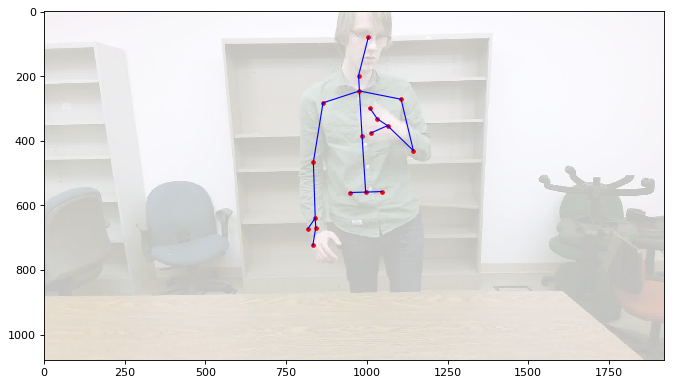

frame number (vfr) and rgb skeleton frame number 3481 3430
frame number (vfr) and rgb skeleton frame number 3482 3431
frame number (vfr) and rgb skeleton frame number 3483 3431
frame number (vfr) and rgb skeleton frame number 3484 3433
frame number (vfr) and rgb skeleton frame number 3485 3434
frame number (vfr) and rgb skeleton frame number 3486 3435
frame number (vfr) and rgb skeleton frame number 3487 3435
frame number (vfr) and rgb skeleton frame number 3488 3437
frame number (vfr) and rgb skeleton frame number 3489 3438
frame number (vfr) and rgb skeleton frame number 3490 3439
frame number (vfr) and rgb skeleton frame number 3491 3439
frame number (vfr) and rgb skeleton frame number 3492 3440
frame number (vfr) and rgb skeleton frame number 3493 3441
frame number (vfr) and rgb skeleton frame number 3494 3443
frame number (vfr) and rgb skeleton frame number 3495 3444
frame number (vfr) and rgb skeleton frame number 3496 3445
frame number (vfr) and rgb skeleton frame number 3497 34

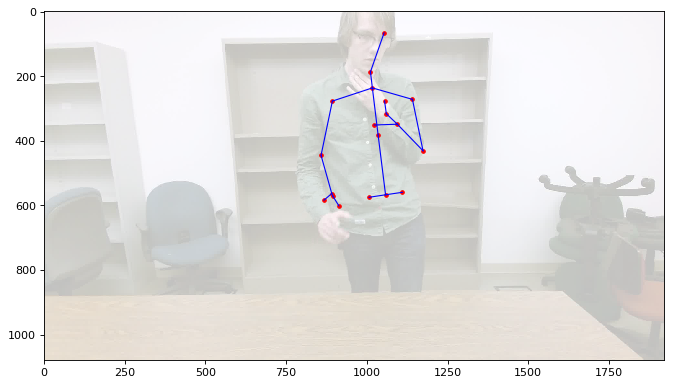

frame number (vfr) and rgb skeleton frame number 3511 3460
frame number (vfr) and rgb skeleton frame number 3512 3461
frame number (vfr) and rgb skeleton frame number 3513 3462
frame number (vfr) and rgb skeleton frame number 3514 3463
frame number (vfr) and rgb skeleton frame number 3515 3464
frame number (vfr) and rgb skeleton frame number 3516 3464
frame number (vfr) and rgb skeleton frame number 3517 3466
frame number (vfr) and rgb skeleton frame number 3518 3467
frame number (vfr) and rgb skeleton frame number 3519 3468
frame number (vfr) and rgb skeleton frame number 3520 3469
frame number (vfr) and rgb skeleton frame number 3521 3470
frame number (vfr) and rgb skeleton frame number 3522 3470
frame number (vfr) and rgb skeleton frame number 3523 3471
frame number (vfr) and rgb skeleton frame number 3524 3472
frame number (vfr) and rgb skeleton frame number 3525 3473
frame number (vfr) and rgb skeleton frame number 3526 3475
frame number (vfr) and rgb skeleton frame number 3527 34

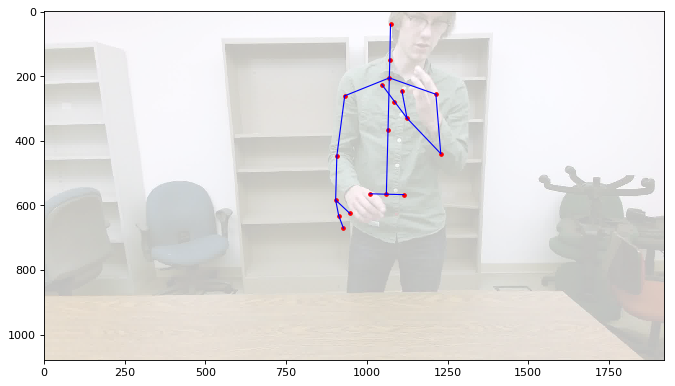

frame number (vfr) and rgb skeleton frame number 3541 3490
frame number (vfr) and rgb skeleton frame number 3542 3491
frame number (vfr) and rgb skeleton frame number 3543 3492
frame number (vfr) and rgb skeleton frame number 3544 3492
frame number (vfr) and rgb skeleton frame number 3545 3494
frame number (vfr) and rgb skeleton frame number 3546 3495
frame number (vfr) and rgb skeleton frame number 3547 3495
frame number (vfr) and rgb skeleton frame number 3548 3496
frame number (vfr) and rgb skeleton frame number 3549 3497
frame number (vfr) and rgb skeleton frame number 3550 3498
frame number (vfr) and rgb skeleton frame number 3551 3499
frame number (vfr) and rgb skeleton frame number 3552 3500
frame number (vfr) and rgb skeleton frame number 3553 3501
frame number (vfr) and rgb skeleton frame number 3554 3502
frame number (vfr) and rgb skeleton frame number 3555 3503
frame number (vfr) and rgb skeleton frame number 3556 3503
frame number (vfr) and rgb skeleton frame number 3557 35

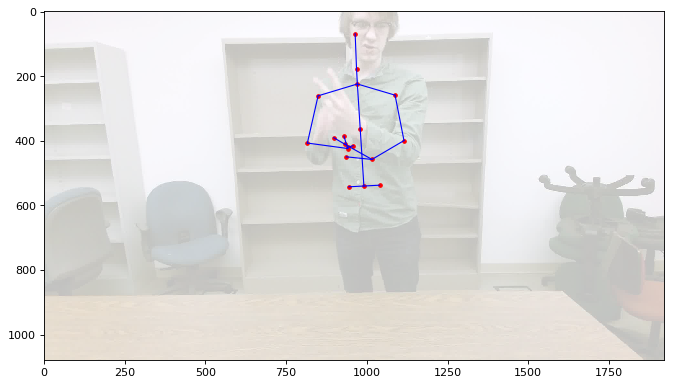

frame number (vfr) and rgb skeleton frame number 3571 3518
frame number (vfr) and rgb skeleton frame number 3572 3519
frame number (vfr) and rgb skeleton frame number 3573 3521
frame number (vfr) and rgb skeleton frame number 3574 3522
frame number (vfr) and rgb skeleton frame number 3575 3523
frame number (vfr) and rgb skeleton frame number 3576 3524
frame number (vfr) and rgb skeleton frame number 3577 3525
frame number (vfr) and rgb skeleton frame number 3578 3526
frame number (vfr) and rgb skeleton frame number 3579 3527
frame number (vfr) and rgb skeleton frame number 3580 3528
frame number (vfr) and rgb skeleton frame number 3581 3528
frame number (vfr) and rgb skeleton frame number 3582 3529
frame number (vfr) and rgb skeleton frame number 3583 3531
frame number (vfr) and rgb skeleton frame number 3584 3532
frame number (vfr) and rgb skeleton frame number 3585 3533
frame number (vfr) and rgb skeleton frame number 3586 3533
frame number (vfr) and rgb skeleton frame number 3587 35

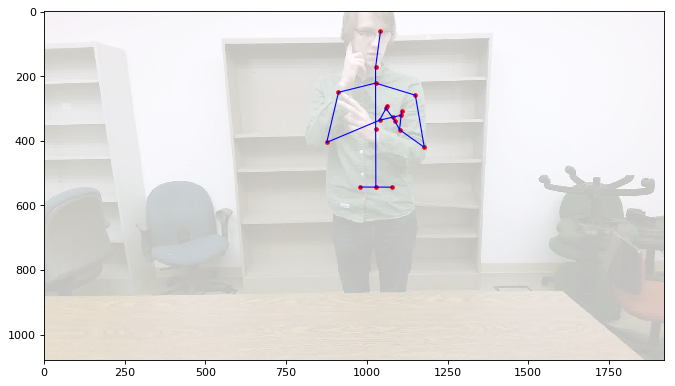

frame number (vfr) and rgb skeleton frame number 3601 3548
frame number (vfr) and rgb skeleton frame number 3602 3549
frame number (vfr) and rgb skeleton frame number 3603 3551
frame number (vfr) and rgb skeleton frame number 3604 3551
frame number (vfr) and rgb skeleton frame number 3605 3552
frame number (vfr) and rgb skeleton frame number 3606 3554
frame number (vfr) and rgb skeleton frame number 3607 3554
frame number (vfr) and rgb skeleton frame number 3608 3555
frame number (vfr) and rgb skeleton frame number 3609 3556
frame number (vfr) and rgb skeleton frame number 3610 3557
frame number (vfr) and rgb skeleton frame number 3611 3558
frame number (vfr) and rgb skeleton frame number 3612 3559
frame number (vfr) and rgb skeleton frame number 3613 3560
frame number (vfr) and rgb skeleton frame number 3614 3561
frame number (vfr) and rgb skeleton frame number 3615 3562
frame number (vfr) and rgb skeleton frame number 3616 3563
frame number (vfr) and rgb skeleton frame number 3617 35

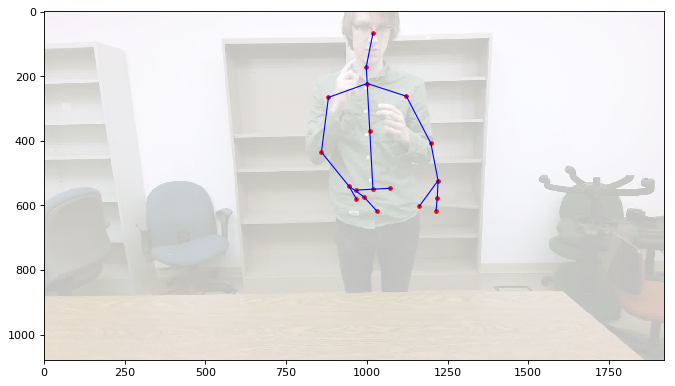

frame number (vfr) and rgb skeleton frame number 3631 3578
frame number (vfr) and rgb skeleton frame number 3632 3578
frame number (vfr) and rgb skeleton frame number 3633 3580
frame number (vfr) and rgb skeleton frame number 3634 3581
frame number (vfr) and rgb skeleton frame number 3635 3582
frame number (vfr) and rgb skeleton frame number 3636 3583
frame number (vfr) and rgb skeleton frame number 3637 3583
frame number (vfr) and rgb skeleton frame number 3638 3584
frame number (vfr) and rgb skeleton frame number 3639 3585
frame number (vfr) and rgb skeleton frame number 3640 3586
frame number (vfr) and rgb skeleton frame number 3641 3588
frame number (vfr) and rgb skeleton frame number 3642 3588
frame number (vfr) and rgb skeleton frame number 3643 3589
frame number (vfr) and rgb skeleton frame number 3644 3591
frame number (vfr) and rgb skeleton frame number 3645 3591
frame number (vfr) and rgb skeleton frame number 3646 3592
frame number (vfr) and rgb skeleton frame number 3647 35

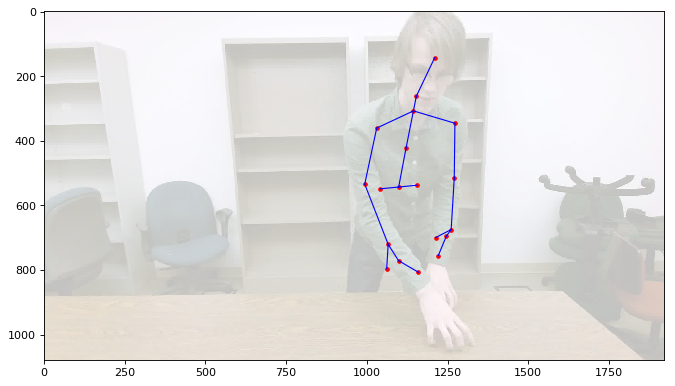

frame number (vfr) and rgb skeleton frame number 3661 3608
frame number (vfr) and rgb skeleton frame number 3662 3609
frame number (vfr) and rgb skeleton frame number 3663 3610
frame number (vfr) and rgb skeleton frame number 3664 3611
frame number (vfr) and rgb skeleton frame number 3665 3611
frame number (vfr) and rgb skeleton frame number 3666 3613
frame number (vfr) and rgb skeleton frame number 3667 3614
frame number (vfr) and rgb skeleton frame number 3668 3615
frame number (vfr) and rgb skeleton frame number 3669 3615
frame number (vfr) and rgb skeleton frame number 3670 3616
frame number (vfr) and rgb skeleton frame number 3671 3617
frame number (vfr) and rgb skeleton frame number 3672 3619
frame number (vfr) and rgb skeleton frame number 3673 3620
frame number (vfr) and rgb skeleton frame number 3674 3621
frame number (vfr) and rgb skeleton frame number 3675 3621
frame number (vfr) and rgb skeleton frame number 3676 3622
frame number (vfr) and rgb skeleton frame number 3677 36

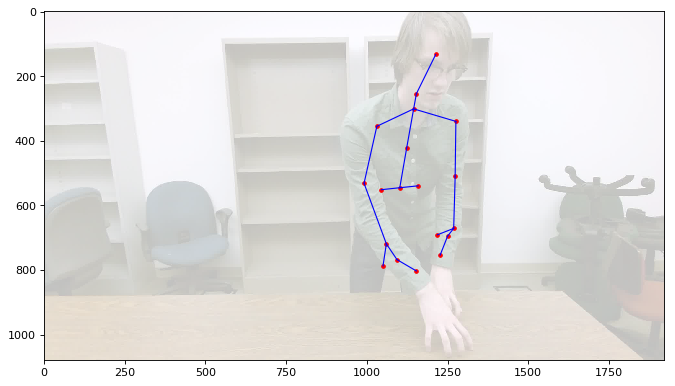

frame number (vfr) and rgb skeleton frame number 3691 3638
frame number (vfr) and rgb skeleton frame number 3692 3639
frame number (vfr) and rgb skeleton frame number 3693 3639
frame number (vfr) and rgb skeleton frame number 3694 3640
frame number (vfr) and rgb skeleton frame number 3695 3641
frame number (vfr) and rgb skeleton frame number 3696 3642
frame number (vfr) and rgb skeleton frame number 3697 3643
frame number (vfr) and rgb skeleton frame number 3698 3644
frame number (vfr) and rgb skeleton frame number 3699 3645
frame number (vfr) and rgb skeleton frame number 3700 3646
frame number (vfr) and rgb skeleton frame number 3701 3646
frame number (vfr) and rgb skeleton frame number 3702 3648
frame number (vfr) and rgb skeleton frame number 3703 3649
frame number (vfr) and rgb skeleton frame number 3704 3650
frame number (vfr) and rgb skeleton frame number 3705 3651
frame number (vfr) and rgb skeleton frame number 3706 3651
frame number (vfr) and rgb skeleton frame number 3707 36

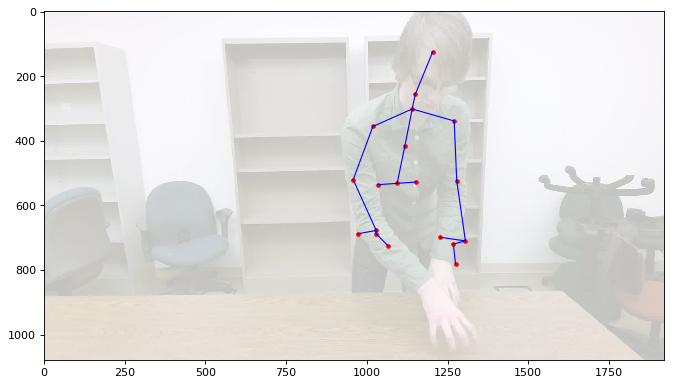

frame number (vfr) and rgb skeleton frame number 3721 3667
frame number (vfr) and rgb skeleton frame number 3722 3668
frame number (vfr) and rgb skeleton frame number 3723 3669
frame number (vfr) and rgb skeleton frame number 3724 3670
frame number (vfr) and rgb skeleton frame number 3725 3671
frame number (vfr) and rgb skeleton frame number 3726 3672
frame number (vfr) and rgb skeleton frame number 3727 3673
frame number (vfr) and rgb skeleton frame number 3728 3674
frame number (vfr) and rgb skeleton frame number 3729 3675
frame number (vfr) and rgb skeleton frame number 3730 3676
frame number (vfr) and rgb skeleton frame number 3731 3677
frame number (vfr) and rgb skeleton frame number 3732 3678
frame number (vfr) and rgb skeleton frame number 3733 3679
frame number (vfr) and rgb skeleton frame number 3734 3680
frame number (vfr) and rgb skeleton frame number 3735 3680
frame number (vfr) and rgb skeleton frame number 3736 3681
frame number (vfr) and rgb skeleton frame number 3737 36

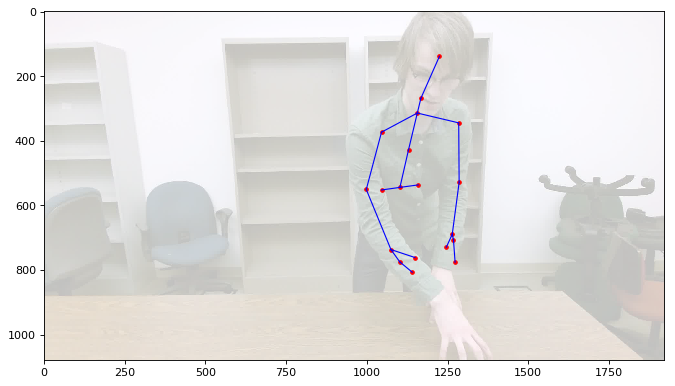

frame number (vfr) and rgb skeleton frame number 3751 3696
frame number (vfr) and rgb skeleton frame number 3752 3697
frame number (vfr) and rgb skeleton frame number 3753 3698
frame number (vfr) and rgb skeleton frame number 3754 3698
frame number (vfr) and rgb skeleton frame number 3755 3700
frame number (vfr) and rgb skeleton frame number 3756 3700
frame number (vfr) and rgb skeleton frame number 3757 3702
frame number (vfr) and rgb skeleton frame number 3758 3703
frame number (vfr) and rgb skeleton frame number 3759 3704
frame number (vfr) and rgb skeleton frame number 3760 3704
frame number (vfr) and rgb skeleton frame number 3761 3705
frame number (vfr) and rgb skeleton frame number 3762 3706
frame number (vfr) and rgb skeleton frame number 3763 3707
frame number (vfr) and rgb skeleton frame number 3764 3709
frame number (vfr) and rgb skeleton frame number 3765 3710
frame number (vfr) and rgb skeleton frame number 3766 3711
frame number (vfr) and rgb skeleton frame number 3767 37

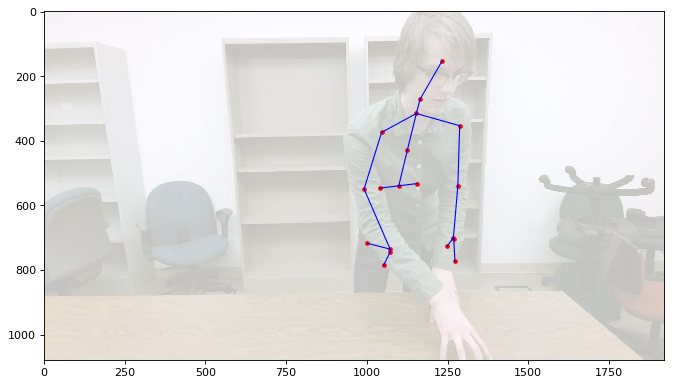

frame number (vfr) and rgb skeleton frame number 3781 3726
frame number (vfr) and rgb skeleton frame number 3782 3727
frame number (vfr) and rgb skeleton frame number 3783 3728
frame number (vfr) and rgb skeleton frame number 3784 3729
frame number (vfr) and rgb skeleton frame number 3785 3729
frame number (vfr) and rgb skeleton frame number 3786 3730
frame number (vfr) and rgb skeleton frame number 3787 3731
frame number (vfr) and rgb skeleton frame number 3788 3732
frame number (vfr) and rgb skeleton frame number 3789 3733
frame number (vfr) and rgb skeleton frame number 3790 3734
frame number (vfr) and rgb skeleton frame number 3791 3735
frame number (vfr) and rgb skeleton frame number 3792 3736
frame number (vfr) and rgb skeleton frame number 3793 3736
frame number (vfr) and rgb skeleton frame number 3794 3738
frame number (vfr) and rgb skeleton frame number 3795 3739
frame number (vfr) and rgb skeleton frame number 3796 3740
frame number (vfr) and rgb skeleton frame number 3797 37

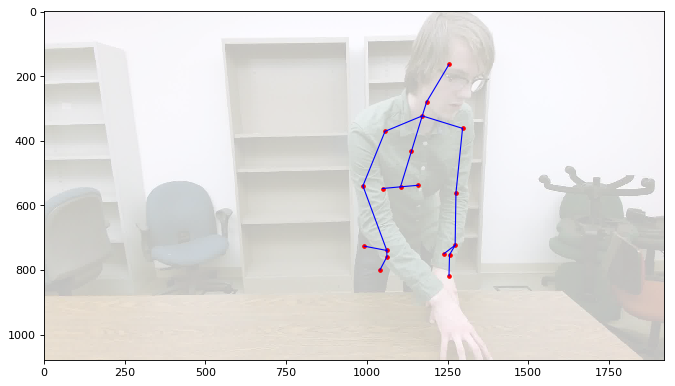

frame number (vfr) and rgb skeleton frame number 3811 3755
frame number (vfr) and rgb skeleton frame number 3812 3756
frame number (vfr) and rgb skeleton frame number 3813 3756
frame number (vfr) and rgb skeleton frame number 3814 3758
frame number (vfr) and rgb skeleton frame number 3815 3759
frame number (vfr) and rgb skeleton frame number 3816 3760
frame number (vfr) and rgb skeleton frame number 3817 3761
frame number (vfr) and rgb skeleton frame number 3818 3761
frame number (vfr) and rgb skeleton frame number 3819 3763
frame number (vfr) and rgb skeleton frame number 3820 3764
frame number (vfr) and rgb skeleton frame number 3821 3765
frame number (vfr) and rgb skeleton frame number 3822 3766
frame number (vfr) and rgb skeleton frame number 3823 3767
frame number (vfr) and rgb skeleton frame number 3824 3767
frame number (vfr) and rgb skeleton frame number 3825 3768
frame number (vfr) and rgb skeleton frame number 3826 3770
frame number (vfr) and rgb skeleton frame number 3827 37

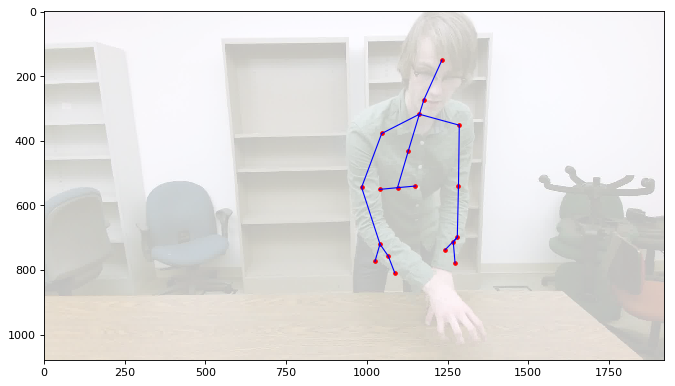

frame number (vfr) and rgb skeleton frame number 3841 3784
frame number (vfr) and rgb skeleton frame number 3842 3786
frame number (vfr) and rgb skeleton frame number 3843 3787
frame number (vfr) and rgb skeleton frame number 3844 3788
frame number (vfr) and rgb skeleton frame number 3845 3788
frame number (vfr) and rgb skeleton frame number 3846 3790
frame number (vfr) and rgb skeleton frame number 3847 3791
frame number (vfr) and rgb skeleton frame number 3848 3792
frame number (vfr) and rgb skeleton frame number 3849 3793
frame number (vfr) and rgb skeleton frame number 3850 3794
frame number (vfr) and rgb skeleton frame number 3851 3795
frame number (vfr) and rgb skeleton frame number 3852 3796
frame number (vfr) and rgb skeleton frame number 3853 3797
frame number (vfr) and rgb skeleton frame number 3854 3798
frame number (vfr) and rgb skeleton frame number 3855 3799
frame number (vfr) and rgb skeleton frame number 3856 3800
frame number (vfr) and rgb skeleton frame number 3857 38

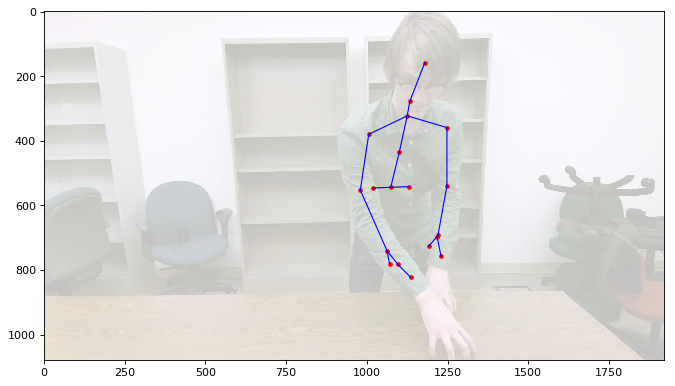

frame number (vfr) and rgb skeleton frame number 3871 3815
frame number (vfr) and rgb skeleton frame number 3872 3816
frame number (vfr) and rgb skeleton frame number 3873 3817
frame number (vfr) and rgb skeleton frame number 3874 3818
frame number (vfr) and rgb skeleton frame number 3875 3819
frame number (vfr) and rgb skeleton frame number 3876 3819
frame number (vfr) and rgb skeleton frame number 3877 3821
frame number (vfr) and rgb skeleton frame number 3878 3822
frame number (vfr) and rgb skeleton frame number 3879 3823
frame number (vfr) and rgb skeleton frame number 3880 3823
frame number (vfr) and rgb skeleton frame number 3881 3824
frame number (vfr) and rgb skeleton frame number 3882 3826
frame number (vfr) and rgb skeleton frame number 3883 3827
frame number (vfr) and rgb skeleton frame number 3884 3828
frame number (vfr) and rgb skeleton frame number 3885 3828
frame number (vfr) and rgb skeleton frame number 3886 3830
frame number (vfr) and rgb skeleton frame number 3887 38

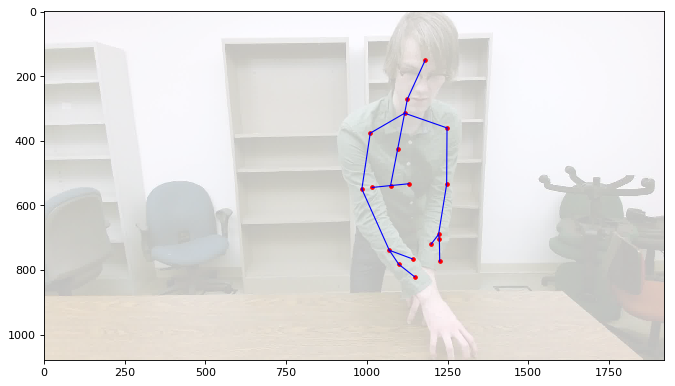

frame number (vfr) and rgb skeleton frame number 3901 3843
frame number (vfr) and rgb skeleton frame number 3902 3844
frame number (vfr) and rgb skeleton frame number 3903 3845
frame number (vfr) and rgb skeleton frame number 3904 3846
frame number (vfr) and rgb skeleton frame number 3905 3847
frame number (vfr) and rgb skeleton frame number 3906 3848
frame number (vfr) and rgb skeleton frame number 3907 3849
frame number (vfr) and rgb skeleton frame number 3908 3850
frame number (vfr) and rgb skeleton frame number 3909 3851
frame number (vfr) and rgb skeleton frame number 3910 3852
frame number (vfr) and rgb skeleton frame number 3911 3853
frame number (vfr) and rgb skeleton frame number 3912 3854
frame number (vfr) and rgb skeleton frame number 3913 3854
frame number (vfr) and rgb skeleton frame number 3914 3856
frame number (vfr) and rgb skeleton frame number 3915 3857
frame number (vfr) and rgb skeleton frame number 3916 3858
frame number (vfr) and rgb skeleton frame number 3917 38

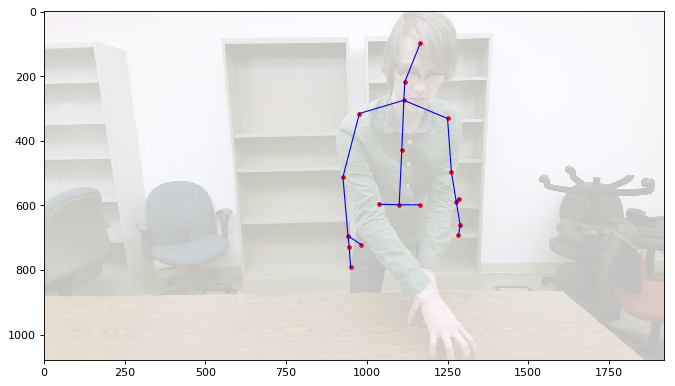

frame number (vfr) and rgb skeleton frame number 3931 3872
frame number (vfr) and rgb skeleton frame number 3932 3874
frame number (vfr) and rgb skeleton frame number 3933 3875
frame number (vfr) and rgb skeleton frame number 3934 3876
frame number (vfr) and rgb skeleton frame number 3935 3877
frame number (vfr) and rgb skeleton frame number 3936 3877
frame number (vfr) and rgb skeleton frame number 3937 3878
frame number (vfr) and rgb skeleton frame number 3938 3880
frame number (vfr) and rgb skeleton frame number 3939 3880
frame number (vfr) and rgb skeleton frame number 3940 3881
frame number (vfr) and rgb skeleton frame number 3941 3883
frame number (vfr) and rgb skeleton frame number 3942 3883
frame number (vfr) and rgb skeleton frame number 3943 3884
frame number (vfr) and rgb skeleton frame number 3944 3886
frame number (vfr) and rgb skeleton frame number 3945 3887
frame number (vfr) and rgb skeleton frame number 3946 3888
frame number (vfr) and rgb skeleton frame number 3947 38

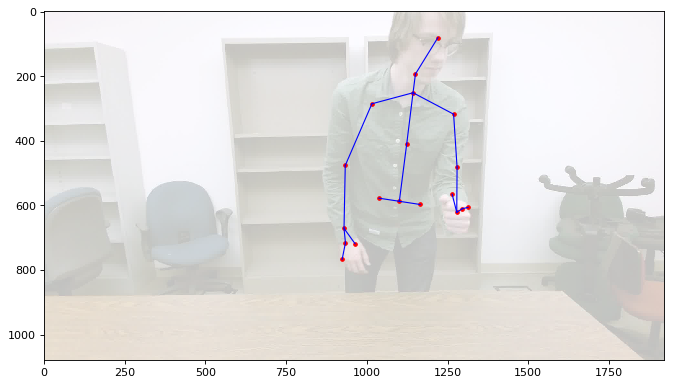

frame number (vfr) and rgb skeleton frame number 3961 3902
frame number (vfr) and rgb skeleton frame number 3962 3903
frame number (vfr) and rgb skeleton frame number 3963 3905
frame number (vfr) and rgb skeleton frame number 3964 3906
frame number (vfr) and rgb skeleton frame number 3965 3907
frame number (vfr) and rgb skeleton frame number 3966 3908
frame number (vfr) and rgb skeleton frame number 3967 3909
frame number (vfr) and rgb skeleton frame number 3968 3910
frame number (vfr) and rgb skeleton frame number 3969 3911
frame number (vfr) and rgb skeleton frame number 3970 3912
frame number (vfr) and rgb skeleton frame number 3971 3913
frame number (vfr) and rgb skeleton frame number 3972 3914
frame number (vfr) and rgb skeleton frame number 3973 3915
frame number (vfr) and rgb skeleton frame number 3974 3916
frame number (vfr) and rgb skeleton frame number 3975 3917
frame number (vfr) and rgb skeleton frame number 3976 3917
frame number (vfr) and rgb skeleton frame number 3977 39

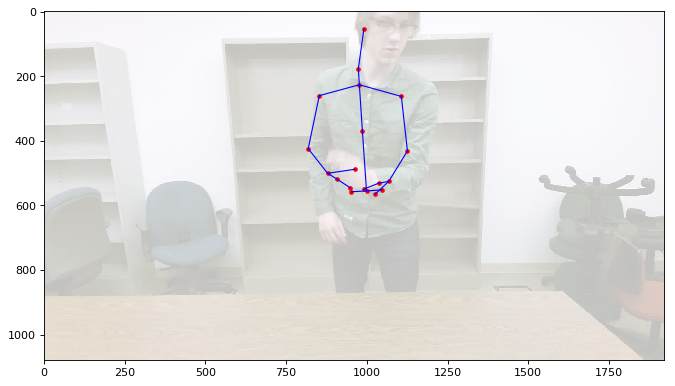

frame number (vfr) and rgb skeleton frame number 3991 3932
frame number (vfr) and rgb skeleton frame number 3992 3933
frame number (vfr) and rgb skeleton frame number 3993 3934
frame number (vfr) and rgb skeleton frame number 3994 3935
frame number (vfr) and rgb skeleton frame number 3995 3936
frame number (vfr) and rgb skeleton frame number 3996 3937
frame number (vfr) and rgb skeleton frame number 3997 3937
frame number (vfr) and rgb skeleton frame number 3998 3938
frame number (vfr) and rgb skeleton frame number 3999 3940
frame number (vfr) and rgb skeleton frame number 4000 3940
frame number (vfr) and rgb skeleton frame number 4001 3941
frame number (vfr) and rgb skeleton frame number 4002 3943
frame number (vfr) and rgb skeleton frame number 4003 3944
frame number (vfr) and rgb skeleton frame number 4004 3945
frame number (vfr) and rgb skeleton frame number 4005 3946
frame number (vfr) and rgb skeleton frame number 4006 3947
frame number (vfr) and rgb skeleton frame number 4007 39

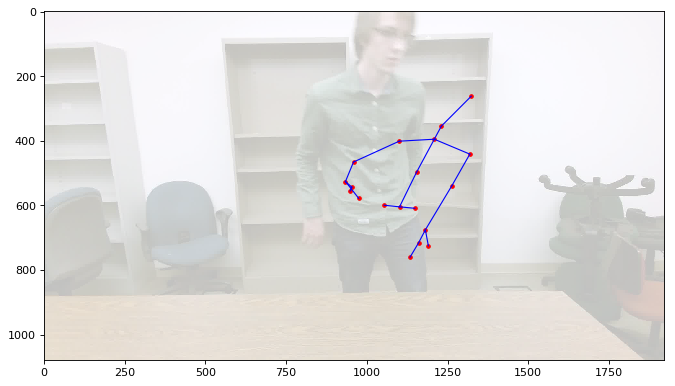

frame number (vfr) and rgb skeleton frame number 4021 3962
frame number (vfr) and rgb skeleton frame number 4022 3963
frame number (vfr) and rgb skeleton frame number 4023 3964
frame number (vfr) and rgb skeleton frame number 4024 3965
frame number (vfr) and rgb skeleton frame number 4025 3966
frame number (vfr) and rgb skeleton frame number 4026 3967
frame number (vfr) and rgb skeleton frame number 4027 3968
frame number (vfr) and rgb skeleton frame number 4028 3968
frame number (vfr) and rgb skeleton frame number 4029 3969
frame number (vfr) and rgb skeleton frame number 4030 3970
frame number (vfr) and rgb skeleton frame number 4031 3972
frame number (vfr) and rgb skeleton frame number 4032 3973
frame number (vfr) and rgb skeleton frame number 4033 3974
frame number (vfr) and rgb skeleton frame number 4034 3975
frame number (vfr) and rgb skeleton frame number 4035 3975
frame number (vfr) and rgb skeleton frame number 4036 3976
frame number (vfr) and rgb skeleton frame number 4037 39

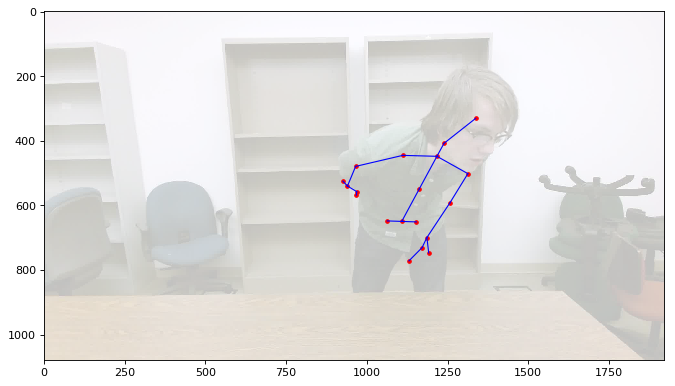

frame number (vfr) and rgb skeleton frame number 4051 3992
frame number (vfr) and rgb skeleton frame number 4052 3993
frame number (vfr) and rgb skeleton frame number 4053 3994
frame number (vfr) and rgb skeleton frame number 4054 3995
frame number (vfr) and rgb skeleton frame number 4055 3996
frame number (vfr) and rgb skeleton frame number 4056 3997
frame number (vfr) and rgb skeleton frame number 4057 3998
frame number (vfr) and rgb skeleton frame number 4058 3998
frame number (vfr) and rgb skeleton frame number 4059 4000
frame number (vfr) and rgb skeleton frame number 4060 4001
frame number (vfr) and rgb skeleton frame number 4061 4002
frame number (vfr) and rgb skeleton frame number 4062 4002
frame number (vfr) and rgb skeleton frame number 4063 4003
frame number (vfr) and rgb skeleton frame number 4064 4004
frame number (vfr) and rgb skeleton frame number 4065 4005
frame number (vfr) and rgb skeleton frame number 4066 4007
frame number (vfr) and rgb skeleton frame number 4067 40

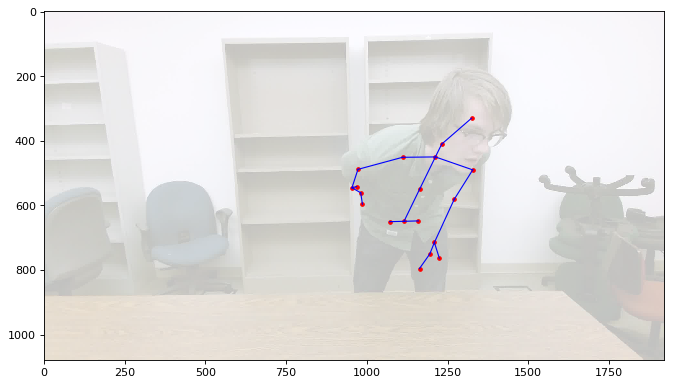

frame number (vfr) and rgb skeleton frame number 4081 4022
frame number (vfr) and rgb skeleton frame number 4082 4023
frame number (vfr) and rgb skeleton frame number 4083 4024
frame number (vfr) and rgb skeleton frame number 4084 4024
frame number (vfr) and rgb skeleton frame number 4085 4025
frame number (vfr) and rgb skeleton frame number 4086 4027
frame number (vfr) and rgb skeleton frame number 4087 4028
frame number (vfr) and rgb skeleton frame number 4088 4029
frame number (vfr) and rgb skeleton frame number 4089 4030
frame number (vfr) and rgb skeleton frame number 4090 4031
frame number (vfr) and rgb skeleton frame number 4091 4032
frame number (vfr) and rgb skeleton frame number 4092 4032
frame number (vfr) and rgb skeleton frame number 4093 4033
frame number (vfr) and rgb skeleton frame number 4094 4035
frame number (vfr) and rgb skeleton frame number 4095 4036
frame number (vfr) and rgb skeleton frame number 4096 4037
frame number (vfr) and rgb skeleton frame number 4097 40

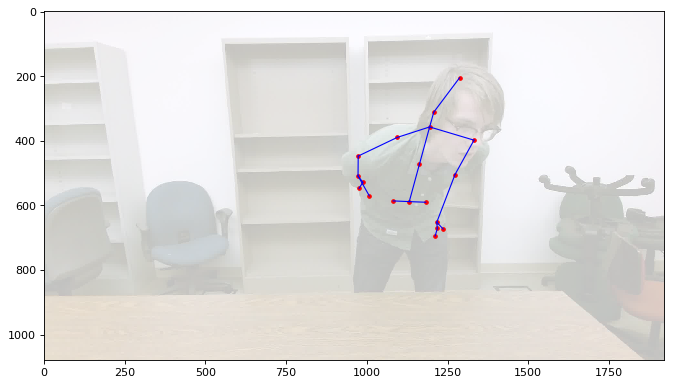

frame number (vfr) and rgb skeleton frame number 4111 4051
frame number (vfr) and rgb skeleton frame number 4112 4053
frame number (vfr) and rgb skeleton frame number 4113 4054
frame number (vfr) and rgb skeleton frame number 4114 4055
frame number (vfr) and rgb skeleton frame number 4115 4056
frame number (vfr) and rgb skeleton frame number 4116 4057
frame number (vfr) and rgb skeleton frame number 4117 4057
frame number (vfr) and rgb skeleton frame number 4118 4059
frame number (vfr) and rgb skeleton frame number 4119 4060
frame number (vfr) and rgb skeleton frame number 4120 4060
frame number (vfr) and rgb skeleton frame number 4121 4062
frame number (vfr) and rgb skeleton frame number 4122 4063
frame number (vfr) and rgb skeleton frame number 4123 4064
frame number (vfr) and rgb skeleton frame number 4124 4064
frame number (vfr) and rgb skeleton frame number 4125 4066
frame number (vfr) and rgb skeleton frame number 4126 4067
frame number (vfr) and rgb skeleton frame number 4127 40

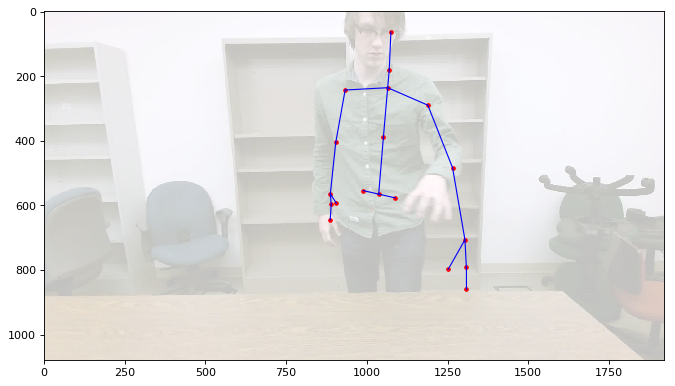

frame number (vfr) and rgb skeleton frame number 4141 4082
frame number (vfr) and rgb skeleton frame number 4142 4083
frame number (vfr) and rgb skeleton frame number 4143 4084
frame number (vfr) and rgb skeleton frame number 4144 4084
frame number (vfr) and rgb skeleton frame number 4145 4085
frame number (vfr) and rgb skeleton frame number 4146 4086
frame number (vfr) and rgb skeleton frame number 4147 4087
frame number (vfr) and rgb skeleton frame number 4148 4089
frame number (vfr) and rgb skeleton frame number 4149 4089
frame number (vfr) and rgb skeleton frame number 4150 4090
frame number (vfr) and rgb skeleton frame number 4151 4091
frame number (vfr) and rgb skeleton frame number 4152 4092
frame number (vfr) and rgb skeleton frame number 4153 4093
frame number (vfr) and rgb skeleton frame number 4154 4094
frame number (vfr) and rgb skeleton frame number 4155 4094
frame number (vfr) and rgb skeleton frame number 4156 4096
frame number (vfr) and rgb skeleton frame number 4157 40

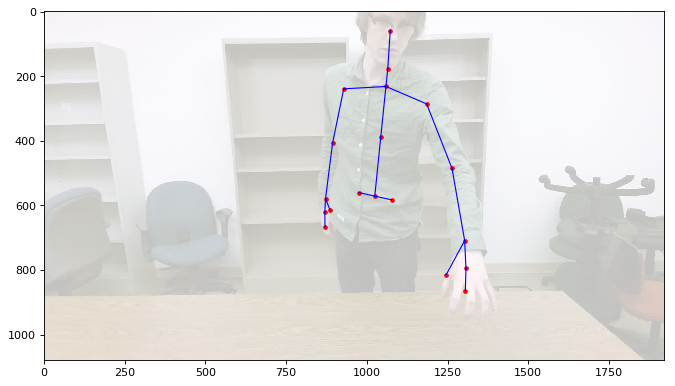

frame number (vfr) and rgb skeleton frame number 4171 4111
frame number (vfr) and rgb skeleton frame number 4172 4112
frame number (vfr) and rgb skeleton frame number 4173 4113
frame number (vfr) and rgb skeleton frame number 4174 4114
frame number (vfr) and rgb skeleton frame number 4175 4114
frame number (vfr) and rgb skeleton frame number 4176 4116
frame number (vfr) and rgb skeleton frame number 4177 4117
frame number (vfr) and rgb skeleton frame number 4178 4118
frame number (vfr) and rgb skeleton frame number 4179 4119
frame number (vfr) and rgb skeleton frame number 4180 4120
frame number (vfr) and rgb skeleton frame number 4181 4120
frame number (vfr) and rgb skeleton frame number 4182 4122
frame number (vfr) and rgb skeleton frame number 4183 4123
frame number (vfr) and rgb skeleton frame number 4184 4124
frame number (vfr) and rgb skeleton frame number 4185 4125
frame number (vfr) and rgb skeleton frame number 4186 4126
frame number (vfr) and rgb skeleton frame number 4187 41

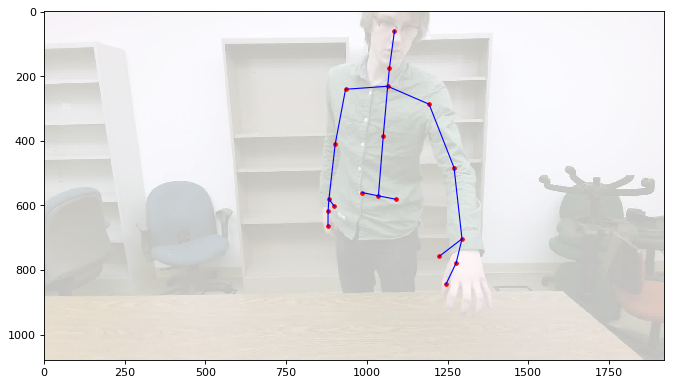

frame number (vfr) and rgb skeleton frame number 4201 4140
frame number (vfr) and rgb skeleton frame number 4202 4141
frame number (vfr) and rgb skeleton frame number 4203 4142
frame number (vfr) and rgb skeleton frame number 4204 4143
frame number (vfr) and rgb skeleton frame number 4205 4144
frame number (vfr) and rgb skeleton frame number 4206 4145
frame number (vfr) and rgb skeleton frame number 4207 4146
frame number (vfr) and rgb skeleton frame number 4208 4147
frame number (vfr) and rgb skeleton frame number 4209 4148
frame number (vfr) and rgb skeleton frame number 4210 4149
frame number (vfr) and rgb skeleton frame number 4211 4149
frame number (vfr) and rgb skeleton frame number 4212 4150
frame number (vfr) and rgb skeleton frame number 4213 4152
frame number (vfr) and rgb skeleton frame number 4214 4153
frame number (vfr) and rgb skeleton frame number 4215 4154
frame number (vfr) and rgb skeleton frame number 4216 4154
frame number (vfr) and rgb skeleton frame number 4217 41

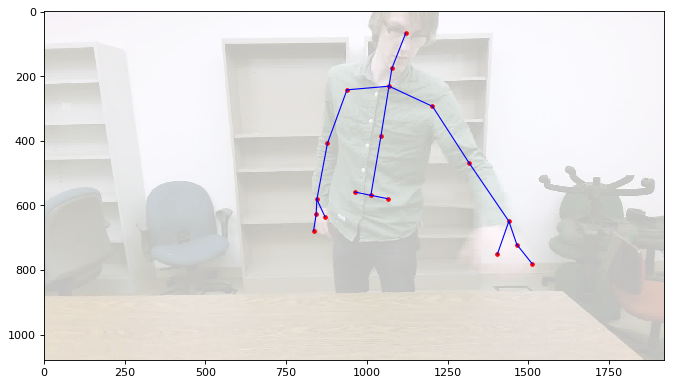

frame number (vfr) and rgb skeleton frame number 4231 4170
frame number (vfr) and rgb skeleton frame number 4232 4170
frame number (vfr) and rgb skeleton frame number 4233 4171
frame number (vfr) and rgb skeleton frame number 4234 4173
frame number (vfr) and rgb skeleton frame number 4235 4173
frame number (vfr) and rgb skeleton frame number 4236 4174
frame number (vfr) and rgb skeleton frame number 4237 4176
frame number (vfr) and rgb skeleton frame number 4238 4177
frame number (vfr) and rgb skeleton frame number 4239 4177
frame number (vfr) and rgb skeleton frame number 4240 4178
frame number (vfr) and rgb skeleton frame number 4241 4180
frame number (vfr) and rgb skeleton frame number 4242 4181
frame number (vfr) and rgb skeleton frame number 4243 4182
frame number (vfr) and rgb skeleton frame number 4244 4182
frame number (vfr) and rgb skeleton frame number 4245 4184
frame number (vfr) and rgb skeleton frame number 4246 4185
frame number (vfr) and rgb skeleton frame number 4247 41

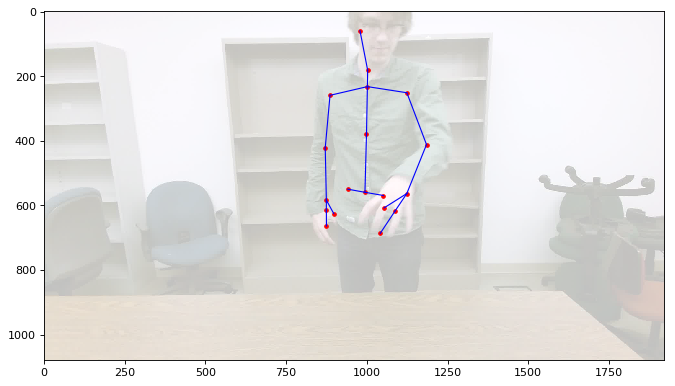

frame number (vfr) and rgb skeleton frame number 4261 4199
frame number (vfr) and rgb skeleton frame number 4262 4201
frame number (vfr) and rgb skeleton frame number 4263 4202
frame number (vfr) and rgb skeleton frame number 4264 4203
frame number (vfr) and rgb skeleton frame number 4265 4204
frame number (vfr) and rgb skeleton frame number 4266 4205
frame number (vfr) and rgb skeleton frame number 4267 4206
frame number (vfr) and rgb skeleton frame number 4268 4206
frame number (vfr) and rgb skeleton frame number 4269 4207
frame number (vfr) and rgb skeleton frame number 4270 4208
frame number (vfr) and rgb skeleton frame number 4271 4210
frame number (vfr) and rgb skeleton frame number 4272 4211
frame number (vfr) and rgb skeleton frame number 4273 4212
frame number (vfr) and rgb skeleton frame number 4274 4213
frame number (vfr) and rgb skeleton frame number 4275 4213
frame number (vfr) and rgb skeleton frame number 4276 4215
frame number (vfr) and rgb skeleton frame number 4277 42

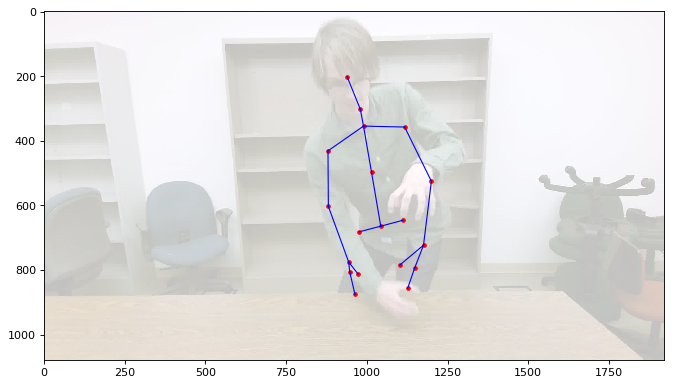

frame number (vfr) and rgb skeleton frame number 4291 4230
frame number (vfr) and rgb skeleton frame number 4292 4230
frame number (vfr) and rgb skeleton frame number 4293 4231
frame number (vfr) and rgb skeleton frame number 4294 4232
frame number (vfr) and rgb skeleton frame number 4295 4234
frame number (vfr) and rgb skeleton frame number 4296 4235
frame number (vfr) and rgb skeleton frame number 4297 4235
frame number (vfr) and rgb skeleton frame number 4298 4236
frame number (vfr) and rgb skeleton frame number 4299 4238
frame number (vfr) and rgb skeleton frame number 4300 4239
frame number (vfr) and rgb skeleton frame number 4301 4240
frame number (vfr) and rgb skeleton frame number 4302 4240
frame number (vfr) and rgb skeleton frame number 4303 4241
frame number (vfr) and rgb skeleton frame number 4304 4243
frame number (vfr) and rgb skeleton frame number 4305 4244
frame number (vfr) and rgb skeleton frame number 4306 4244
frame number (vfr) and rgb skeleton frame number 4307 42

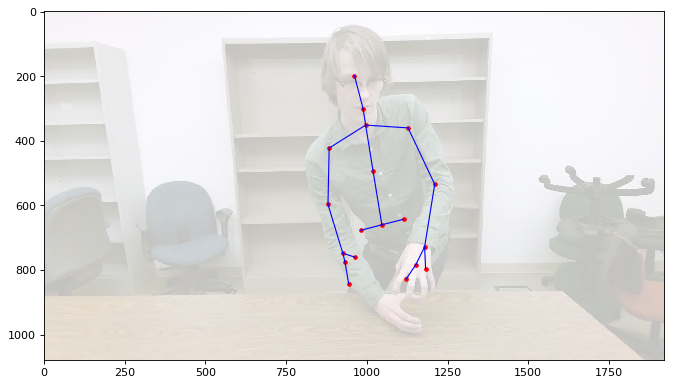

frame number (vfr) and rgb skeleton frame number 4321 4260
frame number (vfr) and rgb skeleton frame number 4322 4261
frame number (vfr) and rgb skeleton frame number 4323 4262
frame number (vfr) and rgb skeleton frame number 4324 4263
frame number (vfr) and rgb skeleton frame number 4325 4264
frame number (vfr) and rgb skeleton frame number 4326 4265
frame number (vfr) and rgb skeleton frame number 4327 4266
frame number (vfr) and rgb skeleton frame number 4328 4267
frame number (vfr) and rgb skeleton frame number 4329 4268
frame number (vfr) and rgb skeleton frame number 4330 4269
frame number (vfr) and rgb skeleton frame number 4331 4270
frame number (vfr) and rgb skeleton frame number 4332 4271
frame number (vfr) and rgb skeleton frame number 4333 4272
frame number (vfr) and rgb skeleton frame number 4334 4273
frame number (vfr) and rgb skeleton frame number 4335 4274
frame number (vfr) and rgb skeleton frame number 4336 4275
frame number (vfr) and rgb skeleton frame number 4337 42

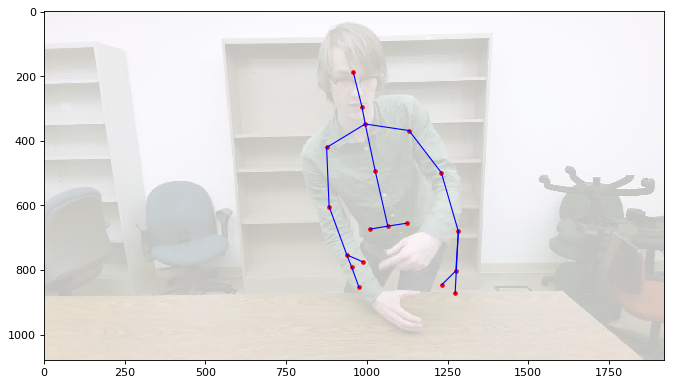

frame number (vfr) and rgb skeleton frame number 4351 4289
frame number (vfr) and rgb skeleton frame number 4352 4291
frame number (vfr) and rgb skeleton frame number 4353 4292
frame number (vfr) and rgb skeleton frame number 4354 4293
frame number (vfr) and rgb skeleton frame number 4355 4294
frame number (vfr) and rgb skeleton frame number 4356 4294
frame number (vfr) and rgb skeleton frame number 4357 4295
frame number (vfr) and rgb skeleton frame number 4358 4296
frame number (vfr) and rgb skeleton frame number 4359 4297
frame number (vfr) and rgb skeleton frame number 4360 4298
frame number (vfr) and rgb skeleton frame number 4361 4299
frame number (vfr) and rgb skeleton frame number 4362 4300
frame number (vfr) and rgb skeleton frame number 4363 4301
frame number (vfr) and rgb skeleton frame number 4364 4302
frame number (vfr) and rgb skeleton frame number 4365 4303
frame number (vfr) and rgb skeleton frame number 4366 4304
frame number (vfr) and rgb skeleton frame number 4367 43

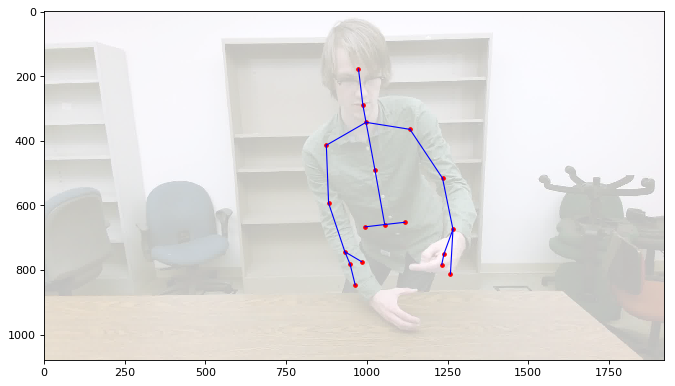

frame number (vfr) and rgb skeleton frame number 4381 4319
frame number (vfr) and rgb skeleton frame number 4382 4320
frame number (vfr) and rgb skeleton frame number 4383 4320
frame number (vfr) and rgb skeleton frame number 4384 4321
frame number (vfr) and rgb skeleton frame number 4385 4322
frame number (vfr) and rgb skeleton frame number 4386 4323
frame number (vfr) and rgb skeleton frame number 4387 4324
frame number (vfr) and rgb skeleton frame number 4388 4325
frame number (vfr) and rgb skeleton frame number 4389 4326
frame number (vfr) and rgb skeleton frame number 4390 4327
frame number (vfr) and rgb skeleton frame number 4391 4328
frame number (vfr) and rgb skeleton frame number 4392 4329
frame number (vfr) and rgb skeleton frame number 4393 4330
frame number (vfr) and rgb skeleton frame number 4394 4331
frame number (vfr) and rgb skeleton frame number 4395 4332
frame number (vfr) and rgb skeleton frame number 4396 4333
frame number (vfr) and rgb skeleton frame number 4397 43

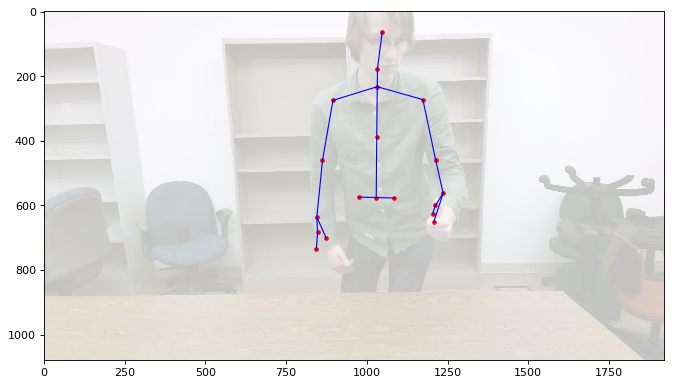

frame number (vfr) and rgb skeleton frame number 4411 4347
frame number (vfr) and rgb skeleton frame number 4412 4349
frame number (vfr) and rgb skeleton frame number 4413 4350
frame number (vfr) and rgb skeleton frame number 4414 4351
frame number (vfr) and rgb skeleton frame number 4415 4352
frame number (vfr) and rgb skeleton frame number 4416 4353
frame number (vfr) and rgb skeleton frame number 4417 4353
frame number (vfr) and rgb skeleton frame number 4418 4354
frame number (vfr) and rgb skeleton frame number 4419 4355
frame number (vfr) and rgb skeleton frame number 4420 4357
frame number (vfr) and rgb skeleton frame number 4421 4358
frame number (vfr) and rgb skeleton frame number 4422 4359
frame number (vfr) and rgb skeleton frame number 4423 4360
frame number (vfr) and rgb skeleton frame number 4424 4361
frame number (vfr) and rgb skeleton frame number 4425 4361
frame number (vfr) and rgb skeleton frame number 4426 4363
frame number (vfr) and rgb skeleton frame number 4427 43

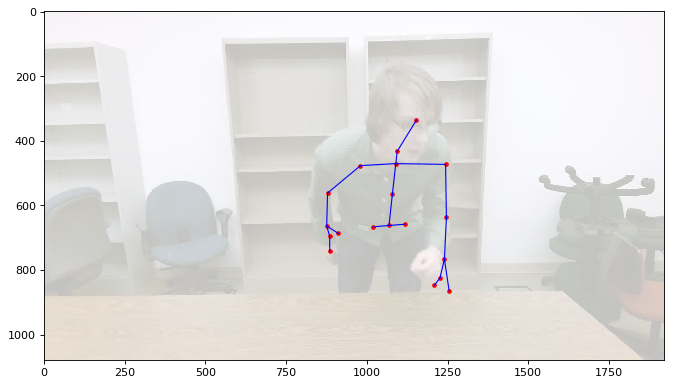

frame number (vfr) and rgb skeleton frame number 4441 4377
frame number (vfr) and rgb skeleton frame number 4442 4378
frame number (vfr) and rgb skeleton frame number 4443 4379
frame number (vfr) and rgb skeleton frame number 4444 4380
frame number (vfr) and rgb skeleton frame number 4445 4380
frame number (vfr) and rgb skeleton frame number 4446 4381
frame number (vfr) and rgb skeleton frame number 4447 4382
frame number (vfr) and rgb skeleton frame number 4448 4383
frame number (vfr) and rgb skeleton frame number 4449 4384
frame number (vfr) and rgb skeleton frame number 4450 4385
frame number (vfr) and rgb skeleton frame number 4451 4386
frame number (vfr) and rgb skeleton frame number 4452 4386
frame number (vfr) and rgb skeleton frame number 4453 4388
frame number (vfr) and rgb skeleton frame number 4454 4389
frame number (vfr) and rgb skeleton frame number 4455 4390
frame number (vfr) and rgb skeleton frame number 4456 4390
frame number (vfr) and rgb skeleton frame number 4457 43

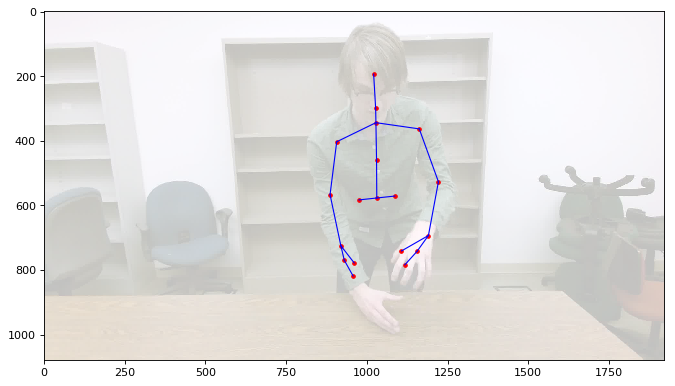

frame number (vfr) and rgb skeleton frame number 4471 4405
frame number (vfr) and rgb skeleton frame number 4472 4406
frame number (vfr) and rgb skeleton frame number 4473 4407
frame number (vfr) and rgb skeleton frame number 4474 4409
frame number (vfr) and rgb skeleton frame number 4475 4410
frame number (vfr) and rgb skeleton frame number 4476 4410
frame number (vfr) and rgb skeleton frame number 4477 4412
frame number (vfr) and rgb skeleton frame number 4478 4413
frame number (vfr) and rgb skeleton frame number 4479 4414
frame number (vfr) and rgb skeleton frame number 4480 4415
frame number (vfr) and rgb skeleton frame number 4481 4416
frame number (vfr) and rgb skeleton frame number 4482 4416
frame number (vfr) and rgb skeleton frame number 4483 4417
frame number (vfr) and rgb skeleton frame number 4484 4419
frame number (vfr) and rgb skeleton frame number 4485 4420
frame number (vfr) and rgb skeleton frame number 4486 4421
frame number (vfr) and rgb skeleton frame number 4487 44

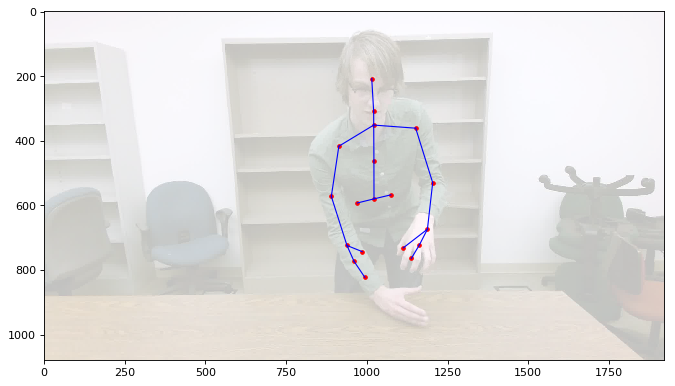

frame number (vfr) and rgb skeleton frame number 4501 4435
frame number (vfr) and rgb skeleton frame number 4502 4436
frame number (vfr) and rgb skeleton frame number 4503 4438
frame number (vfr) and rgb skeleton frame number 4504 4439
frame number (vfr) and rgb skeleton frame number 4505 4440
frame number (vfr) and rgb skeleton frame number 4506 4441
frame number (vfr) and rgb skeleton frame number 4507 4441
frame number (vfr) and rgb skeleton frame number 4508 4442
frame number (vfr) and rgb skeleton frame number 4509 4444
frame number (vfr) and rgb skeleton frame number 4510 4445
frame number (vfr) and rgb skeleton frame number 4511 4445
frame number (vfr) and rgb skeleton frame number 4512 4446
frame number (vfr) and rgb skeleton frame number 4513 4447
frame number (vfr) and rgb skeleton frame number 4514 4449
frame number (vfr) and rgb skeleton frame number 4515 4450
frame number (vfr) and rgb skeleton frame number 4516 4451
frame number (vfr) and rgb skeleton frame number 4517 44

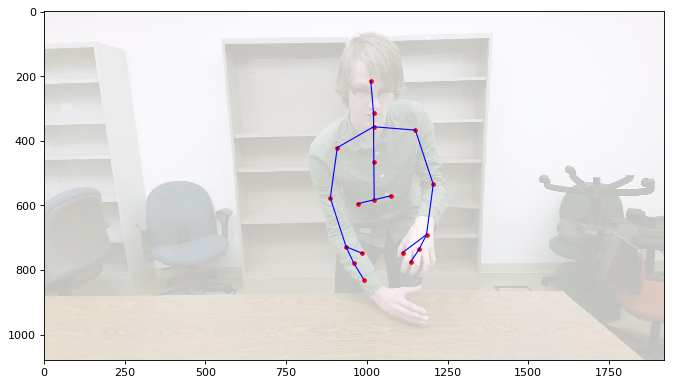

frame number (vfr) and rgb skeleton frame number 4531 4465
frame number (vfr) and rgb skeleton frame number 4532 4467
frame number (vfr) and rgb skeleton frame number 4533 4468
frame number (vfr) and rgb skeleton frame number 4534 4468
frame number (vfr) and rgb skeleton frame number 4535 4469
frame number (vfr) and rgb skeleton frame number 4536 4470
frame number (vfr) and rgb skeleton frame number 4537 4472
frame number (vfr) and rgb skeleton frame number 4538 4473
frame number (vfr) and rgb skeleton frame number 4539 4474
frame number (vfr) and rgb skeleton frame number 4540 4474
frame number (vfr) and rgb skeleton frame number 4541 4476
frame number (vfr) and rgb skeleton frame number 4542 4477
frame number (vfr) and rgb skeleton frame number 4543 4478
frame number (vfr) and rgb skeleton frame number 4544 4479
frame number (vfr) and rgb skeleton frame number 4545 4480
frame number (vfr) and rgb skeleton frame number 4546 4480
frame number (vfr) and rgb skeleton frame number 4547 44

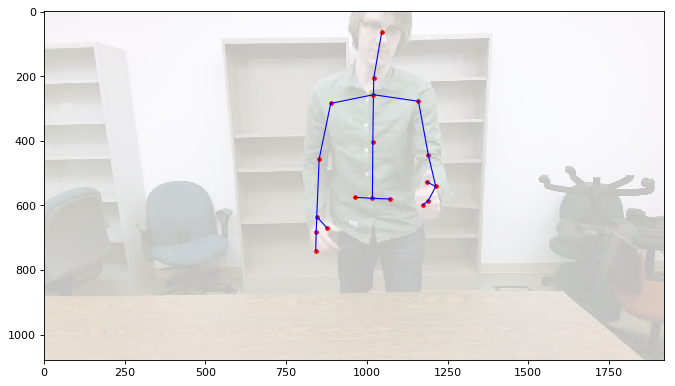

frame number (vfr) and rgb skeleton frame number 4561 4494
frame number (vfr) and rgb skeleton frame number 4562 4495
frame number (vfr) and rgb skeleton frame number 4563 4497
frame number (vfr) and rgb skeleton frame number 4564 4498
frame number (vfr) and rgb skeleton frame number 4565 4499
frame number (vfr) and rgb skeleton frame number 4566 4499
frame number (vfr) and rgb skeleton frame number 4567 4501
frame number (vfr) and rgb skeleton frame number 4568 4502
frame number (vfr) and rgb skeleton frame number 4569 4503
frame number (vfr) and rgb skeleton frame number 4570 4504
frame number (vfr) and rgb skeleton frame number 4571 4505
frame number (vfr) and rgb skeleton frame number 4572 4506
frame number (vfr) and rgb skeleton frame number 4573 4507
frame number (vfr) and rgb skeleton frame number 4574 4508
frame number (vfr) and rgb skeleton frame number 4575 4509
frame number (vfr) and rgb skeleton frame number 4576 4510
frame number (vfr) and rgb skeleton frame number 4577 45

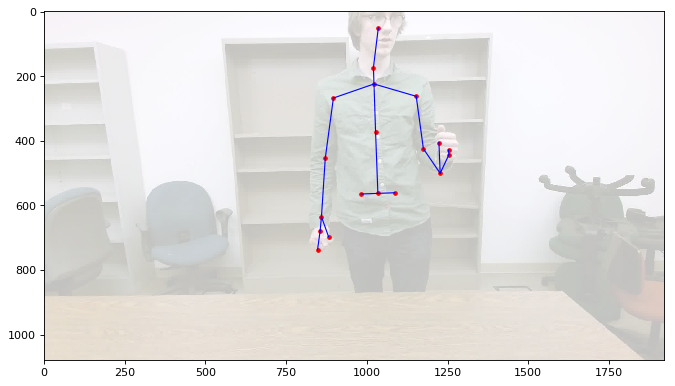

frame number (vfr) and rgb skeleton frame number 4591 4525
frame number (vfr) and rgb skeleton frame number 4592 4526
frame number (vfr) and rgb skeleton frame number 4593 4527
frame number (vfr) and rgb skeleton frame number 4594 4528
frame number (vfr) and rgb skeleton frame number 4595 4529
frame number (vfr) and rgb skeleton frame number 4596 4530
frame number (vfr) and rgb skeleton frame number 4597 4531
frame number (vfr) and rgb skeleton frame number 4598 4532
frame number (vfr) and rgb skeleton frame number 4599 4532
frame number (vfr) and rgb skeleton frame number 4600 4534
frame number (vfr) and rgb skeleton frame number 4601 4535
frame number (vfr) and rgb skeleton frame number 4602 4536
frame number (vfr) and rgb skeleton frame number 4603 4536
frame number (vfr) and rgb skeleton frame number 4604 4537
frame number (vfr) and rgb skeleton frame number 4605 4539
frame number (vfr) and rgb skeleton frame number 4606 4540
frame number (vfr) and rgb skeleton frame number 4607 45

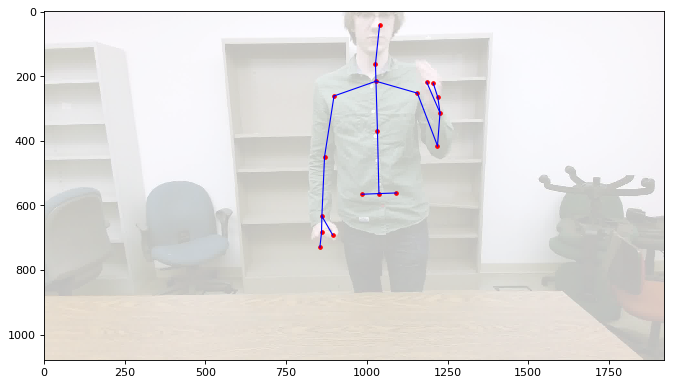

frame number (vfr) and rgb skeleton frame number 4621 4555
frame number (vfr) and rgb skeleton frame number 4622 4556
frame number (vfr) and rgb skeleton frame number 4623 4557
frame number (vfr) and rgb skeleton frame number 4624 4557
frame number (vfr) and rgb skeleton frame number 4625 4559
frame number (vfr) and rgb skeleton frame number 4626 4560
frame number (vfr) and rgb skeleton frame number 4627 4560
frame number (vfr) and rgb skeleton frame number 4628 4562
frame number (vfr) and rgb skeleton frame number 4629 4563
frame number (vfr) and rgb skeleton frame number 4630 4564
frame number (vfr) and rgb skeleton frame number 4631 4565
frame number (vfr) and rgb skeleton frame number 4632 4565
frame number (vfr) and rgb skeleton frame number 4633 4566
frame number (vfr) and rgb skeleton frame number 4634 4568
frame number (vfr) and rgb skeleton frame number 4635 4569
frame number (vfr) and rgb skeleton frame number 4636 4570
frame number (vfr) and rgb skeleton frame number 4637 45

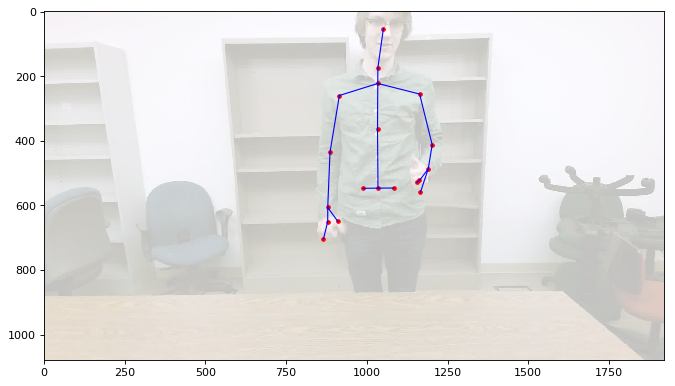

frame number (vfr) and rgb skeleton frame number 4651 4585
frame number (vfr) and rgb skeleton frame number 4652 4585
frame number (vfr) and rgb skeleton frame number 4653 4587
frame number (vfr) and rgb skeleton frame number 4654 4588
frame number (vfr) and rgb skeleton frame number 4655 4588
frame number (vfr) and rgb skeleton frame number 4656 4589
frame number (vfr) and rgb skeleton frame number 4657 4590
frame number (vfr) and rgb skeleton frame number 4658 4590
frame number (vfr) and rgb skeleton frame number 4659 4592
frame number (vfr) and rgb skeleton frame number 4660 4593
frame number (vfr) and rgb skeleton frame number 4661 4593


In [28]:
### video visualization with opencv
print("reading video", video_path)

for k in frame_dict.keys():
    nearest_idx, nearest_time = prep.find_nearest_frameindex_from_skeleton_file(rgb_skeleton_data[...,0], frame_dict[k]) #
    print("frame number (vfr) and rgb skeleton frame number", k, nearest_idx)
    time.sleep(0.0)
    # input("press anything to continue")
    if (abs(frame_dict[k] - nearest_time) > 1000000):  # 100 ns ticks, so 1000000 = 0.1sec
        mismatch_count += 1
        print("THIS is a mismatch in time, of more than 0.1 sec")
        continue  # do not add the nearest found index if the difference is really big (>0.1sec)
    else:         
        # print(rgb_skeleton_data[nearest_idx])
        if(np.inf not in rgb_skeleton_data[nearest_idx]):  # do not add if there is np.inf in the line
            rgb_kp = rgb_skeleton_data[nearest_idx][1:].reshape((19,2))
            cap.set(cv2.CAP_PROP_POS_FRAMES, k)
            success, frame = cap.read()  # frame is read as (h, w, c)
            if success and k%30==0:
                img_full = frame[...,::-1]
                print("original full rgb image =")
                plt.figure(num=None, figsize=(10, 10), dpi=80, facecolor='w', edgecolor='k')
                plt.imshow(img_full, alpha=0.25)
                plt.scatter(x=rgb_kp[...,0], y=rgb_kp[...,1], c='r', s=10)
                for p in paf_pairs_indices:
#                   print(p)
                    plt.plot([rgb_kp[p[0]][0], rgb_kp[p[1]][0]], [rgb_kp[p[0]][1], rgb_kp[p[1]][1]], 'b-', lw=1)
                plt.show()
                    
                    